In [1]:
import torch
print("CUDA available:", torch.cuda.is_available())
print("Device name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "CPU")
print("Torch CUDA version:", torch.version.cuda)


CUDA available: True
Device name: Tesla P100-PCIE-16GB
Torch CUDA version: 12.4


In [2]:
rm -rf /kaggle/working/*


In [3]:
# 2️⃣ Reinstall a fully compatible stack for your Skin Cancer project
#!pip install torch==2.6.0 torchvision==0.21.0 torchaudio==2.6.0 \
 #   numpy==2.1.3 matplotlib==3.9.2 seaborn==0.13.2 pandas==2.2.2


In [4]:
# 1️⃣ Remove corrupted torch folders
#!rm -rf /usr/local/lib/python3.11/dist-packages/~orch*
#!rm -rf /usr/local/lib/python3.11/dist-packages/torch*
#!rm -rf /usr/local/lib/python3.11/dist-packages/torchvision*
#!rm -rf /usr/local/lib/python3.11/dist-packages/torchaudio*

# 2️⃣ Reinstall correct versions
#!pip install --no-cache-dir torch==2.6.0 torchvision==0.21.0 torchaudio==2.6.0 \
 #   numpy==2.1.3 pandas==2.2.2 matplotlib==3.9.2 seaborn==0.13.2 \
  #  albumentations==2.0.8 opencv-python==4.10.0.84 scikit-learn==1.5.2 tqdm==4.66.5


In [5]:
#!pip install --upgrade --force-reinstall numpy==1.26.4 scipy==1.12.0 scikit-learn==1.5.2 --quiet


In [6]:
# 3️⃣ Verify
import numpy, matplotlib, seaborn, pandas, torch, torchvision, scipy, sklearn
print("NumPy:", numpy.__version__)
print("Matplotlib:", matplotlib.__version__)
print("Seaborn:", seaborn.__version__)
print("Pandas:", pandas.__version__)
print("Torch:", torch.__version__)
print("SciPy:", scipy.__version__)
print("Scikit-learn:", sklearn.__version__)

NumPy: 1.26.4
Matplotlib: 3.7.2
Seaborn: 0.12.2
Pandas: 2.2.3
Torch: 2.6.0+cu124
SciPy: 1.15.3
Scikit-learn: 1.2.2


In [7]:
# Cell 1 — Setup & imports (for Kaggle)
import os, sys, json, random, warnings
from pathlib import Path
from typing import List, Tuple, Optional, Dict

warnings.filterwarnings("ignore", category=UserWarning, module="pydantic")

sys.path.append("/kaggle/input/multitask-dataset")  # ✅ ensure dataset import works

import numpy as np
import pandas as pd
from PIL import Image
import seaborn as sns
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, WeightedRandomSampler
import torchvision.transforms.functional as TF
from torchvision.ops import FeaturePyramidNetwork

import albumentations as A
from albumentations.pytorch import ToTensorV2
import timm

from sklearn.metrics import (
    classification_report, roc_auc_score, f1_score, jaccard_score, confusion_matrix
)
from tqdm.notebook import tqdm

# Dataset import
from my_dataset import ISICMultiTaskDataset

# Device setup
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

# Reproducibility
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False


Device: cuda


In [8]:
# Cell 2 — Paths & constants
DATA_ROOT = "/kaggle/input/multitask-dataset/MultiTask_Dataset/MultiTask_Dataset"  # <--- update if needed
TRAIN_DIR = os.path.join(DATA_ROOT, "train")
VAL_DIR   = os.path.join(DATA_ROOT, "val")
TEST_DIR  = os.path.join(DATA_ROOT, "test")

# Feature names expected in features JSON
FEATURE_NAMES = [
    'pigment_network', 
    'streaks', 
    'negative_network', 
    'globules', 
    'milia_like_cyst', 
    'blotches', 
    'rosettes'
]

# Class order used across code (0,1,2 mapping)
CLASS_ORDER = ['nevus', 'melanoma', 'seborrheic_keratosis']  # Nevus as 0 (majority), melanoma 1, SK 2
NUM_CLASSES = len(CLASS_ORDER)
NUM_FEATURES = len(FEATURE_NAMES)
print("FEATURE_NAMES:\n", FEATURE_NAMES)
print("CLASS_ORDER:\n", CLASS_ORDER)


FEATURE_NAMES:
 ['pigment_network', 'streaks', 'negative_network', 'globules', 'milia_like_cyst', 'blotches', 'rosettes']
CLASS_ORDER:
 ['nevus', 'melanoma', 'seborrheic_keratosis']


In [9]:
# Cell 3 — Albumentations Transforms
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transforms = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.ShiftScaleRotate(
        shift_limit=0.05,
        scale_limit=0.12,
        rotate_limit=25,
        p=0.5
    ),
    A.RandomBrightnessContrast(p=0.2),
    A.HueSaturationValue(p=0.15),
    A.GaussNoise(var_limit=(10.0, 50.0), p=0.2),
    A.GaussianBlur(p=0.1),
    A.CoarseDropout(
        max_holes=8,
        max_height=32,
        max_width=32,
        p=0.2
    ),
    A.Resize(320, 320),
    A.Normalize(
        mean=(0.485, 0.456, 0.406),
        std=(0.229, 0.224, 0.225)
    ),
    ToTensorV2()
])

val_transforms = A.Compose([
    A.Resize(320, 320),
    A.Normalize(
        mean=(0.485, 0.456, 0.406),
        std=(0.229, 0.224, 0.225)
    ),
    ToTensorV2()
])

# Test transforms are identical to validation
test_transforms = val_transforms


/usr/local/lib/python3.11/dist-packages/albumentations/core/validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)
/tmp/ipykernel_37/2700904309.py:17: UserWarning: Argument(s) 'var_limit' are not valid for transform GaussNoise
  A.GaussNoise(var_limit=(10.0, 50.0), p=0.2),
/tmp/ipykernel_37/2700904309.py:19: UserWarning: Argument(s) 'max_holes, max_height, max_width' are not valid for transform CoarseDropout
  A.CoarseDropout(


In [10]:
# ==========================================================
# Cell 4 — Utilities for Label Encoding and Weighted Sampler
# ==========================================================

def encode_class_row(row: pd.Series) -> int:
    """
    Given a row with columns (melanoma, seborrheic_keratosis, nevus) where 1.0 indicates presence,
    map to integer class index according to CLASS_ORDER (nevus=0, melanoma=1, seborrheic_keratosis=2).
    """
    for idx, cls in enumerate(CLASS_ORDER):
        val = row.get(cls, 0)
        if float(val) == 1.0:
            return idx
    return 0  # fallback: if none flagged, assume nevus (0)


def make_weighted_sampler(df: pd.DataFrame, label_col='class_idx'):
    """
    Create a WeightedRandomSampler for on-the-fly oversampling based on class imbalance.
    Reusable for train, val, and test DataFrames.

    Args:
        df: DataFrame with label column.
        label_col: column name for class indices.
    Returns:
        sampler: torch.utils.data.WeightedRandomSampler
        class_counts: numpy array of class counts
    """
    counts = df[label_col].value_counts().sort_index()
    # Ensure all classes present
    class_counts = [int(counts.get(i, 0)) for i in range(NUM_CLASSES)]
    class_counts = np.array(class_counts, dtype=np.float64)

    # Compute inverse frequency weights
    class_weights = 1.0 / (class_counts + 1e-8)
    sample_weights = np.array([class_weights[int(lbl)] for lbl in df[label_col].values])
    sample_weights = torch.from_numpy(sample_weights).double()

    sampler = WeightedRandomSampler(
        weights=sample_weights,
        num_samples=len(sample_weights),  # same length as dataset
        replacement=True
    )

    print(f"[INFO] Weighted Sampler Created → Class Counts: {class_counts.tolist()}")
    return sampler, class_counts



--- Pre-loading feature JSONs into memory... ---


Caching features for train:   0%|          | 0/2000 [00:00<?, ?it/s]

Caching features for val:   0%|          | 0/150 [00:00<?, ?it/s]

Caching features for test:   0%|          | 0/600 [00:00<?, ?it/s]

...Feature caching complete!

--- Training Set Labels (Head) ---
       image_id  melanoma  seborrheic_keratosis  nevus  class_idx
0  ISIC_0000000       0.0                   0.0    1.0          0
1  ISIC_0000001       0.0                   0.0    1.0          0
2  ISIC_0000002       1.0                   0.0    0.0          1
3  ISIC_0000003       0.0                   0.0    1.0          0
4  ISIC_0000004       1.0                   0.0    0.0          1

--- Validation Set Labels (Head) ---
       image_id  melanoma  seborrheic_keratosis  nevus  class_idx
0  ISIC_0001769       0.0                   0.0    1.0          0
1  ISIC_0001852       0.0                   0.0    1.0          0
2  ISIC_0001871       0.0                   0.0    1.0          0
3  ISIC_0003462       0.0                   0.0    1.0          0
4  ISIC_0003539       0.0                   0.0    1.0          0

--- Test Set Labels (Head) ---
       image_id  melanoma  seborrheic_keratosis  nevus  class_idx
0  ISIC

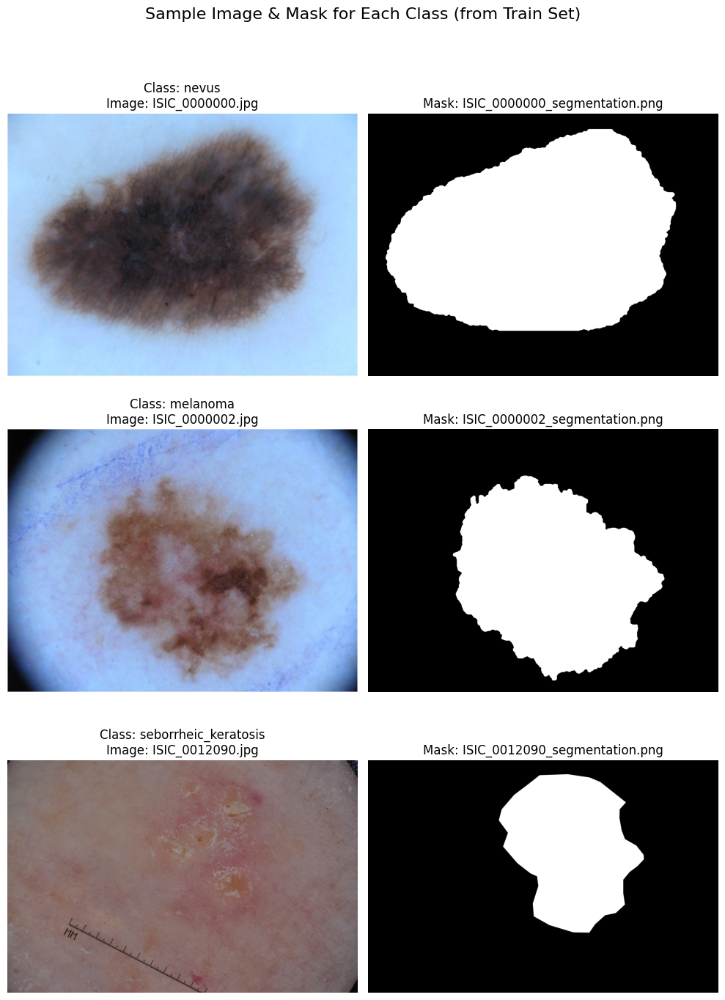

In [11]:
# Cell 5 (Expanded) — Load CSVs, Create Feature Cache, and Inspect (fixed)
from PIL import Image

# --- 1. Load CSVs ---
df_train = pd.read_csv(os.path.join(TRAIN_DIR, 'labels.csv'))
df_val   = pd.read_csv(os.path.join(VAL_DIR, 'labels.csv'))
df_test  = pd.read_csv(os.path.join(TEST_DIR, 'labels.csv'))

# --- 2. Ensure 'image_id' column exists ---
if 'image_id' not in df_train.columns:
    for alt in ['image', 'image_name', 'name', 'imageId']:
        if alt in df_train.columns:
            df_train = df_train.rename(columns={alt: 'image_id'})
            df_val = df_val.rename(columns={alt: 'image_id'})
            df_test = df_test.rename(columns={alt: 'image_id'})
            break

# --- 3. Create 'class_idx' column ---
df_train['class_idx'] = df_train.apply(encode_class_row, axis=1)
df_val['class_idx']   = df_val.apply(encode_class_row, axis=1)
df_test['class_idx']  = df_test.apply(encode_class_row, axis=1)

# --- 4. Pre-load all JSON features into dictionaries ---
print("\n--- Pre-loading feature JSONs into memory... ---")

def build_feature_cache(root_dir, df):
    cache = {}
    for image_id in tqdm(df['image_id'], desc=f"Caching features for {os.path.basename(root_dir)}"):
        feat_vec = np.zeros(len(FEATURE_NAMES), dtype=np.float32)
        path = os.path.join(root_dir, 'features', f"{image_id}_features.json")
        if not os.path.exists(path):
            cache[str(image_id)] = feat_vec
            continue
        try:
            with open(path, 'r') as f:
                js = json.load(f)
            feats_root = js.get('dermoscopic_features', js)
            for i, fname in enumerate(FEATURE_NAMES):
                val = feats_root.get(fname)
                if isinstance(val, list):
                    feat_vec[i] = 1.0 if any(int(x) == 1 for x in val) else 0.0
                elif isinstance(val, (int, float, bool)):
                    feat_vec[i] = 1.0 if int(val) == 1 else 0.0
        except Exception:
            # On any error, leave zeros
            pass
        cache[str(image_id)] = feat_vec
    return cache

# Build caches
feature_cache_train = build_feature_cache(TRAIN_DIR, df_train)
feature_cache_val = build_feature_cache(VAL_DIR, df_val)
feature_cache_test = build_feature_cache(TEST_DIR, df_test)
print("...Feature caching complete!")

# --- 5. Print DataFrame Heads (as requested) ---
print("\n--- Training Set Labels (Head) ---")
print(df_train.head())
print("\n--- Validation Set Labels (Head) ---")
print(df_val.head())
print("\n--- Test Set Labels (Head) ---")
print(df_test.head())

# --- 6. Print Class Counts ---
print("\n--- Class Counts (nevus=0, melanoma=1, sk=2) ---")
print("Train counts:", df_train['class_idx'].value_counts().sort_index().to_dict())
print("Val counts:  ", df_val['class_idx'].value_counts().sort_index().to_dict())
print("Test counts: ", df_test['class_idx'].value_counts().sort_index().to_dict())

# --- 7. Visualize Samples (safe) ---
print("\n--- Visualizing One Sample Per Class (from Training Set) ---")
try:
    sample_ids = []
    for cls_idx in [0,1,2]:
        subset = df_train[df_train['class_idx']==cls_idx]
        if len(subset) == 0:
            sample_ids.append(None)
        else:
            sample_ids.append(str(subset.iloc[0]['image_id']))

    fig, axes = plt.subplots(3, 2, figsize=(10, 15))
    fig.suptitle("Sample Image & Mask for Each Class (from Train Set)", fontsize=16)

    for i, (image_id, class_name) in enumerate(zip(sample_ids, CLASS_ORDER)):
        if image_id is None:
            axes[i,0].text(0.5,0.5,"No sample", ha='center')
            axes[i,1].text(0.5,0.5,"No sample", ha='center')
            continue

        img_path = os.path.join(TRAIN_DIR, 'images', f"{image_id}.jpg")
        img = Image.open(img_path).convert('RGB')
        axes[i, 0].imshow(img)
        axes[i, 0].set_title(f"Class: {class_name}\nImage: {image_id}.jpg")
        axes[i, 0].axis('off')

        mask_path = os.path.join(TRAIN_DIR, 'masks', f"{image_id}_segmentation.png")
        if os.path.exists(mask_path):
            mask = Image.open(mask_path).convert('L')
            axes[i, 1].imshow(mask, cmap='gray')
        else:
            axes[i, 1].text(0.5,0.5,"No mask", ha='center')
        axes[i, 1].set_title(f"Mask: {image_id}_segmentation.png")
        axes[i, 1].axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
except Exception as e:
    print(f"[Error] Could not display sample images: {e}")


In [12]:
# ==========================================================
# Cell 7 — DataLoaders Creation (Balanced & On-the-Fly)
# ==========================================================
from torch.utils.data import DataLoader

# Create datasets
train_dataset = ISICMultiTaskDataset(TRAIN_DIR, df_train, feature_cache=feature_cache_train, transforms=train_transforms)
val_dataset   = ISICMultiTaskDataset(VAL_DIR, df_val, feature_cache=feature_cache_val, transforms=val_transforms)
test_dataset  = ISICMultiTaskDataset(TEST_DIR, df_test, feature_cache=feature_cache_test, transforms=test_transforms)

# Sampler for training (and optionally val/test for uniform sampling)
train_sampler, class_counts_train = make_weighted_sampler(df_train, label_col='class_idx')
val_sampler, class_counts_val = make_weighted_sampler(df_val, label_col='class_idx')
test_sampler, class_counts_test = make_weighted_sampler(df_test, label_col='class_idx')


print(f"--- Class Counts (Train): {class_counts_train.tolist()} ---")
print("Using WeightedRandomSampler for on-the-fly oversampling")

BATCH_SIZE = 8
NUM_WORKERS = 4
pin_memory_flag = torch.cuda.is_available()

# DataLoaders
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, sampler=train_sampler,
                          num_workers=NUM_WORKERS, pin_memory=pin_memory_flag)
val_loader   = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False,
                          num_workers=NUM_WORKERS, pin_memory=pin_memory_flag)
test_loader  = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False,
                          num_workers=NUM_WORKERS, pin_memory=pin_memory_flag)

print(f"DataLoaders ready: BATCH={BATCH_SIZE}, WORKERS={NUM_WORKERS}, pin_memory={pin_memory_flag}")


[INFO] Weighted Sampler Created → Class Counts: [1372.0, 374.0, 254.0]
[INFO] Weighted Sampler Created → Class Counts: [78.0, 30.0, 42.0]
[INFO] Weighted Sampler Created → Class Counts: [393.0, 117.0, 90.0]
--- Class Counts (Train): [1372.0, 374.0, 254.0] ---
Using WeightedRandomSampler for on-the-fly oversampling
DataLoaders ready: BATCH=8, WORKERS=4, pin_memory=True


In [13]:
# Cell 8 (Corrected) — Model definition (unchanged aside from earlier corrections)
class SimpleDecoderBlock(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )
    def forward(self, x):
        return self.conv(x)

class MultiTaskNet(nn.Module):
    def __init__(self, backbone_name='efficientnet_b4', pretrained=True, num_classes=NUM_CLASSES, num_features=NUM_FEATURES):
        super().__init__()
        self.backbone = timm.create_model(backbone_name, pretrained=pretrained, features_only=True, out_indices=(0,1,2,3))
        backbone_out_channels = self.backbone.feature_info.channels()
        
        self.fpn = FeaturePyramidNetwork(in_channels_list=backbone_out_channels, out_channels=256)
        
        self.dec_b3 = SimpleDecoderBlock(256, 128)
        self.dec_b2 = SimpleDecoderBlock(128, 64)
        self.dec_b1 = SimpleDecoderBlock(64, 32)
        
        self.seg_head = nn.Sequential(
            nn.Conv2d(32, 16, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(16, 1, kernel_size=1)
        )
        
        self.class_pool = nn.AdaptiveAvgPool2d(1)
        fc_in = backbone_out_channels[-1]
        self.class_head = nn.Sequential(
            nn.Flatten(),
            nn.Linear(fc_in, 512),
            nn.ReLU(inplace=True),
            nn.Dropout(0.3),
            nn.Linear(512, num_classes)
        )
        
        self.feat_head = nn.Sequential(
            nn.Flatten(),
            nn.Linear(fc_in, 512),
            nn.ReLU(inplace=True),
            nn.Dropout(0.3),
            nn.Linear(512, num_features)
        )
        
    def forward(self, x):
        feats = self.backbone(x)
        feats_dict = {f'p{i+1}': feats[i] for i in range(len(feats))}
        fpn_out = self.fpn(feats_dict)
        
        out_items = sorted(fpn_out.items(), key=lambda kv: (kv[1].shape[-2]*kv[1].shape[-1]), reverse=True)
        largest_feat = out_items[0][1]
        
        x_dec = self.dec_b3(largest_feat)
        x_dec = nn.functional.interpolate(x_dec, scale_factor=2, mode='bilinear', align_corners=False)
        x_dec = self.dec_b2(x_dec)
        x_dec = nn.functional.interpolate(x_dec, scale_factor=2, mode='bilinear', align_corners=False)
        x_dec = self.dec_b1(x_dec)
        x_dec = nn.functional.interpolate(x_dec, size=(x.shape[2], x.shape[3]), mode='bilinear', align_corners=False)
        seg_logits = self.seg_head(x_dec)
        
        global_feat = feats[-1]
        pooled = self.class_pool(global_feat)
        class_logits = self.class_head(pooled)
        feat_logits  = self.feat_head(pooled)
        
        return seg_logits, class_logits, feat_logits

model = MultiTaskNet(backbone_name='efficientnet_b4', pretrained=True).to(device)
print(f"--- Model {model.backbone.default_cfg['architecture']} created ---")

from torchinfo import summary

# Example input shape (3x224x224 for EfficientNet)
summary(model, input_size=(1, 3, 224, 224))


model.safetensors:   0%|          | 0.00/77.9M [00:00<?, ?B/s]

--- Model efficientnet_b4 created ---


Layer (type:depth-idx)                             Output Shape              Param #
MultiTaskNet                                       [1, 1, 224, 224]          --
├─EfficientNetFeatures: 1-1                        [1, 24, 112, 112]         --
│    └─Conv2d: 2-1                                 [1, 48, 112, 112]         1,296
│    └─BatchNormAct2d: 2-2                         [1, 48, 112, 112]         96
│    │    └─Identity: 3-1                          [1, 48, 112, 112]         --
│    │    └─SiLU: 3-2                              [1, 48, 112, 112]         --
│    └─Sequential: 2-3                             --                        --
│    │    └─Sequential: 3-3                        [1, 24, 112, 112]         4,146
│    │    └─Sequential: 3-4                        [1, 32, 56, 56]           66,238
│    │    └─Sequential: 3-5                        [1, 56, 28, 28]           197,586
│    │    └─Sequential: 3-6                        [1, 112, 14, 14]          1,059,898
│    │    └─S

In [14]:
# Cell 9 — Loss functions & optimizer (with GradScaler)
from torch import amp

def dice_coeff(pred: torch.Tensor, target: torch.Tensor, smooth=1e-6):
    pred = torch.sigmoid(pred)
    pred_flat = pred.view(pred.size(0), -1)
    target_flat = target.view(target.size(0), -1)
    intersection = (pred_flat * target_flat).sum(dim=1)
    union = pred_flat.sum(dim=1) + target_flat.sum(dim=1)
    dice = (2.0 * intersection + smooth) / (union + smooth)
    return dice.mean()

bce_loss = nn.BCEWithLogitsLoss()
ce_loss  = nn.CrossEntropyLoss()    # UNWEIGHTED (sampler used)
feat_loss_fn = nn.BCEWithLogitsLoss()

def multitask_loss(seg_logits, seg_target, class_logits, class_target, feat_logits, feat_target, w_seg=1.0, w_class=1.0, w_feat=1.0):
    loss_seg_bce = bce_loss(seg_logits, seg_target)
    loss_seg_dice = 1.0 - dice_coeff(seg_logits, seg_target)
    loss_seg = 0.5 * loss_seg_bce + 0.5 * loss_seg_dice

    loss_class = ce_loss(class_logits, class_target)
    loss_feat  = feat_loss_fn(feat_logits, feat_target)

    total = w_seg * loss_seg + w_class * loss_class + w_feat * loss_feat
    return total, {'loss_seg': loss_seg.item(), 'loss_class': loss_class.item(), 'loss_feat': loss_feat.item()}

optimizer = optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3)

scaler = amp.GradScaler('cuda')


In [15]:
# Cell 10 — Fixed Multi-Task Training Loop (robust AUC, safe concatenation for AUC)
import time, os
import numpy as np
import torch
from torch.cuda.amp import GradScaler
from sklearn.metrics import roc_auc_score, f1_score
#from tqdm import tqdm
from tqdm.notebook import tqdm

ckpt_dir = "/kaggle/working/checkpoints"
os.makedirs(ckpt_dir, exist_ok=True)

FEATURE_NAMES = ['pigment_network', 'streaks', 'negative_network', 'globules',
                 'milia_like_cyst', 'blotches', 'rosettes']
CLASS_ORDER = ['nevus', 'melanoma', 'seborrheic_keratosis']


def dice_coefficient(pred_mask, true_mask, eps=1e-6):
    """Compute batch-wise Dice (returns scalar mean)."""
    pred_mask = (torch.sigmoid(pred_mask) > 0.5).float()
    intersection = (pred_mask * true_mask).sum(dim=(1, 2, 3))
    union = pred_mask.sum(dim=(1, 2, 3)) + true_mask.sum(dim=(1, 2, 3))
    dice = (2. * intersection + eps) / (union + eps)
    return dice.mean().item()


def safe_mean(lst):
    return float(np.mean(lst)) if len(lst) > 0 else 0.0


def run_training(model, train_loader, val_loader, optimizer, scheduler, device, scaler):
    NUM_EPOCHS = 50             # change as needed
    best_val_score = -1.0
    #ckpt_dir = "/kaggle/working/checkpoints"
    #os.makedirs(ckpt_dir, exist_ok=True)


    history = {
        'train_loss': [], 'val_loss': [],
        'train_acc': [], 'val_acc': [],
        'train_auc': [], 'val_auc': [],
        'train_dice': [], 'val_dice': [],
        'train_feat_f1': [], 'val_feat_f1': []
    }

    print("\n--- Starting Multi-Task Training ---\n")

    for epoch in range(1, NUM_EPOCHS + 1):
        epoch_start = time.time()

        # ---------------- TRAIN ----------------
        model.train()
        train_loss = 0.0
        total = 0
        correct = 0

        # collect per-batch probability arrays and labels as lists (to concatenate later)
        probs_list = []
        labels_list = []

        dice_scores = []
        feat_f1s = []

        train_pbar = tqdm(train_loader, desc=f"Epoch [{epoch}/{NUM_EPOCHS}] [Train]", leave=False)
        for images, masks, classes, feats in train_pbar:
            images, masks = images.to(device), masks.to(device)
            classes, feats = classes.to(device), feats.to(device)

            with torch.amp.autocast("cuda"):
                seg_logits, class_logits, feat_logits = model(images)
                loss, _ = multitask_loss(seg_logits, masks, class_logits, classes, feat_logits, feats)

            optimizer.zero_grad()
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            train_loss += float(loss.item())
            preds = torch.argmax(class_logits, dim=1)
            correct += int((preds == classes).sum().item())
            total += int(classes.size(0))

            # --- probs for AUC (safe for binary & multiclass)
            with torch.no_grad():
                if class_logits.shape[1] == 1:
                    p = torch.sigmoid(class_logits)                       # (B,1)
                    p = torch.cat([1 - p, p], dim=1)                      # (B,2)
                else:
                    p = torch.softmax(class_logits, dim=1)                # (B,C)
                probs_list.append(p.detach().cpu().numpy())              # append (B,C) array
                labels_list.append(classes.detach().cpu().numpy())       # append (B,) array

            # Dice (segmentation)
            try:
                dice_scores.append(dice_coefficient(seg_logits.detach(), masks.detach()))
            except Exception:
                pass

            # Feature F1
            try:
                feat_preds = (torch.sigmoid(feat_logits.detach()) > 0.5).float().cpu().numpy()
                feat_true = feats.detach().cpu().numpy()
                feat_f1s.append(f1_score(feat_true.flatten(), feat_preds.flatten(), zero_division=0))
            except Exception:
                pass

        # Concatenate collected arrays into final shapes
        try:
            all_probs_np = np.concatenate(probs_list, axis=0) if len(probs_list) > 0 else np.zeros((0, NUM_CLASSES))
            all_labels_np = np.concatenate(labels_list, axis=0) if len(labels_list) > 0 else np.zeros((0,), dtype=int)
        except Exception as e:
            # debugging fallback
            print(f"[ERROR] concatenating probs/labels failed: {e}")
            print(f"  probs_list lengths: {[p.shape for p in probs_list]}")
            print(f"  labels_list lengths: {[l.shape for l in labels_list]}")
            raise

        avg_train_loss = train_loss / max(1, len(train_loader))
        train_acc = 100.0 * (correct / max(1, total))

        # compute AUC safely (only if more than 1 class present)
        # --- SAFE MULTICLASS AUC COMPUTATION ---
        train_auc = 0.5
        try:
            if all_probs_np.ndim == 2 and all_labels_np.ndim == 1 and all_probs_np.shape[0] == all_labels_np.shape[0]:
                unique_labels = np.unique(all_labels_np)
                if len(unique_labels) > 1:
                    # Convert to float64 and renormalize per row
                    all_probs_np = all_probs_np.astype(np.float64)
                    row_sums = all_probs_np.sum(axis=1, keepdims=True)
                    row_sums[row_sums == 0] = 1.0
                    all_probs_np = all_probs_np / row_sums
                    # compute AUC
                    train_auc = roc_auc_score(all_labels_np, all_probs_np, multi_class='ovr', average='macro')
                else:
                    print("[WARN] Train: only one class present across all batches, AUC skipped.")
                    train_auc = 0.5
            else:
                raise ValueError(f"Invalid shapes for AUC: probs {all_probs_np.shape}, labels {all_labels_np.shape}")
        except Exception as e:
            print(f"[WARN] Train AUC computation failed: {e}")
            print(f"  all_labels shape: {all_labels_np.shape}, unique: {set(all_labels_np.tolist())}")
            print(f"  all_probs shape: {all_probs_np.shape}")
            if all_probs_np.shape[0] > 0:
                print(f"  Sample probs (first row): {all_probs_np[0]}")
            train_auc = 0.5

        avg_train_dice = safe_mean(dice_scores)
        avg_train_feat_f1 = safe_mean(feat_f1s)

        # ---------------- VALIDATION ----------------
        model.eval()
        val_loss = 0.0
        val_total = 0
        val_correct = 0

        val_probs_list = []
        val_labels_list = []
        val_dice_scores = []
        val_feat_f1s = []

        val_pbar = tqdm(val_loader, desc=f"Epoch [{epoch}/{NUM_EPOCHS}] [Val]", leave=False)
        with torch.no_grad():
            for images, masks, classes, feats in val_pbar:
                images, masks = images.to(device), masks.to(device)
                classes, feats = classes.to(device), feats.to(device)

                with torch.amp.autocast("cuda"):
                    seg_logits, class_logits, feat_logits = model(images)
                    loss, _ = multitask_loss(seg_logits, masks, class_logits, classes, feat_logits, feats)

                val_loss += float(loss.item())
                preds = torch.argmax(class_logits, dim=1)
                val_correct += int((preds == classes).sum().item())
                val_total += int(classes.size(0))

                if class_logits.shape[1] == 1:
                    p = torch.sigmoid(class_logits)
                    p = torch.cat([1 - p, p], dim=1)
                else:
                    p = torch.softmax(class_logits, dim=1)
                val_probs_list.append(p.cpu().numpy())
                val_labels_list.append(classes.cpu().numpy())

                try:
                    val_dice_scores.append(dice_coefficient(seg_logits, masks))
                except Exception:
                    pass
                try:
                    feat_preds = (torch.sigmoid(feat_logits) > 0.5).float().cpu().numpy()
                    feat_true = feats.cpu().numpy()
                    val_feat_f1s.append(f1_score(feat_true.flatten(), feat_preds.flatten(), zero_division=0))
                except Exception:
                    pass

        # Concatenate validation arrays
        try:
            val_probs_np = np.concatenate(val_probs_list, axis=0) if len(val_probs_list) > 0 else np.zeros((0, NUM_CLASSES))
            val_labels_np = np.concatenate(val_labels_list, axis=0) if len(val_labels_list) > 0 else np.zeros((0,), dtype=int)
        except Exception as e:
            print(f"[ERROR] concatenating val probs/labels failed: {e}")
            raise

        avg_val_loss = val_loss / max(1, len(val_loader))
        val_acc = 100.0 * (val_correct / max(1, val_total))

        # --- SAFE MULTICLASS AUC COMPUTATION ---
        val_auc = 0.5
        try:
            if val_probs_np.ndim == 2 and val_labels_np.ndim == 1 and val_probs_np.shape[0] == val_labels_np.shape[0]:
                unique_val_labels = np.unique(val_labels_np)
                if len(unique_val_labels) > 1:
                    # Convert to float64 and renormalize per row
                    val_probs_np = val_probs_np.astype(np.float64)
                    row_sums = val_probs_np.sum(axis=1, keepdims=True)
                    row_sums[row_sums == 0] = 1.0
                    val_probs_np = val_probs_np / row_sums
                    val_auc = roc_auc_score(val_labels_np, val_probs_np, multi_class='ovr', average='macro')
                else:
                    print("[WARN] Val: only one class present across all batches, AUC skipped.")
                    val_auc = 0.5
            else:
                raise ValueError(f"Invalid shapes for Val AUC: probs {val_probs_np.shape}, labels {val_labels_np.shape}")
        except Exception as e:
            print(f"[WARN] Val AUC computation failed: {e}")
            print(f"  val_labels shape: {val_labels_np.shape}, unique: {set(val_labels_np.tolist())}")
            print(f"  val_probs shape: {val_probs_np.shape}")
            if val_probs_np.shape[0] > 0:
                print(f"  Sample val probs (first row): {val_probs_np[0]}")
            val_auc = 0.5
            
        avg_val_dice = safe_mean(val_dice_scores)
        avg_val_feat_f1 = safe_mean(val_feat_f1s)

        # ---- Update History ----
        history['train_loss'].append(avg_train_loss)
        history['val_loss'].append(avg_val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_auc'].append(train_auc)
        history['val_auc'].append(val_auc)
        history['train_dice'].append(avg_train_dice)
        history['val_dice'].append(avg_val_dice)
        history['train_feat_f1'].append(avg_train_feat_f1)
        history['val_feat_f1'].append(avg_val_feat_f1)

        # ---- Logging (grouped, clear) ----
        print(f"\nEpoch [{epoch}/{NUM_EPOCHS}]")
        print("------------------------------------------------")
        print(f"Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")
        print(f"Train Acc : {train_acc:.2f}%  | Val Acc : {val_acc:.2f}%")
        print(f"Train AUC : {train_auc:.4f}   | Val AUC : {val_auc:.4f}")
        print(f"Train Dice: {avg_train_dice:.4f}   | Val Dice: {avg_val_dice:.4f}")
        print(f"Train FeatF1: {avg_train_feat_f1:.4f} | Val FeatF1: {avg_val_feat_f1:.4f}")
        print("------------------------------------------------")

       # ---- Save Best Model (balanced metric combining acc & dice) ----
        val_score = 0.5 * (val_acc / 100.0) + 0.5 * avg_val_dice
        if val_score > best_val_score:
            best_val_score = val_score
        
            # 🟢 Compute and store per-class validation report
            val_labels_np = np.concatenate(val_labels_list)
            val_probs_np = np.concatenate(val_probs_list)
            val_preds_np = np.argmax(val_probs_np, axis=1)
        
            best_val_report = classification_report(
                val_labels_np, val_preds_np,
                target_names=CLASS_ORDER,
                zero_division=0, output_dict=True
            )
        
            # store in history for later inspection
            history['best_val_report'] = best_val_report
        
            # save model checkpoint
            torch.save({
                'epoch': epoch,
                'model_state': model.state_dict(),
                'optimizer_state': optimizer.state_dict(),
                'val_score': val_score,
                'history': history
            }, os.path.join(ckpt_dir, "best_model.pth"))
        
            print(f"✅ Saved Best Model (Val Acc: {val_acc:.2f}% | Dice: {avg_val_dice:.4f})")
        # scheduler step and epoch time
        scheduler.step(avg_val_loss)
        print(f"⏱️ Epoch Time: {(time.time() - epoch_start)/60:.2f} min\n")

    return history



# Execute training
if __name__ == '__main__':
    # ensure scaler exists externally or create here
    if 'scaler' not in globals():
        scaler = GradScaler()
    history = run_training(model, train_loader, val_loader, optimizer, scheduler, device, scaler)



--- Starting Multi-Task Training ---



Epoch [1/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [1/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [1/50]
------------------------------------------------
Train Loss: 1.9413 | Val Loss: 1.4200
Train Acc : 46.20%  | Val Acc : 65.33%
Train AUC : 0.6366   | Val AUC : 0.8051
Train Dice: 0.6355   | Val Dice: 0.7051
Train FeatF1: 0.3527 | Val FeatF1: 0.3833
------------------------------------------------
✅ Saved Best Model (Val Acc: 65.33% | Dice: 0.7051)
⏱️ Epoch Time: 6.58 min



Epoch [2/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [2/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [2/50]
------------------------------------------------
Train Loss: 1.5265 | Val Loss: 1.2848
Train Acc : 55.20%  | Val Acc : 68.00%
Train AUC : 0.7346   | Val AUC : 0.8332
Train Dice: 0.7187   | Val Dice: 0.7326
Train FeatF1: 0.4369 | Val FeatF1: 0.4967
------------------------------------------------
✅ Saved Best Model (Val Acc: 68.00% | Dice: 0.7326)
⏱️ Epoch Time: 6.56 min



Epoch [3/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [3/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [3/50]
------------------------------------------------
Train Loss: 1.3956 | Val Loss: 1.1619
Train Acc : 57.95%  | Val Acc : 73.33%
Train AUC : 0.7725   | Val AUC : 0.8515
Train Dice: 0.7646   | Val Dice: 0.7624
Train FeatF1: 0.4978 | Val FeatF1: 0.4778
------------------------------------------------
✅ Saved Best Model (Val Acc: 73.33% | Dice: 0.7624)
⏱️ Epoch Time: 6.42 min



Epoch [4/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [4/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [4/50]
------------------------------------------------
Train Loss: 1.2878 | Val Loss: 1.1193
Train Acc : 62.10%  | Val Acc : 73.33%
Train AUC : 0.8066   | Val AUC : 0.8645
Train Dice: 0.7813   | Val Dice: 0.7832
Train FeatF1: 0.4899 | Val FeatF1: 0.4491
------------------------------------------------
✅ Saved Best Model (Val Acc: 73.33% | Dice: 0.7832)
⏱️ Epoch Time: 6.01 min



Epoch [5/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [5/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [5/50]
------------------------------------------------
Train Loss: 1.2345 | Val Loss: 1.1611
Train Acc : 63.70%  | Val Acc : 72.67%
Train AUC : 0.8225   | Val AUC : 0.8622
Train Dice: 0.7917   | Val Dice: 0.7951
Train FeatF1: 0.5214 | Val FeatF1: 0.5415
------------------------------------------------
✅ Saved Best Model (Val Acc: 72.67% | Dice: 0.7951)
⏱️ Epoch Time: 6.24 min



Epoch [6/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [6/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [6/50]
------------------------------------------------
Train Loss: 1.2003 | Val Loss: 1.1061
Train Acc : 65.00%  | Val Acc : 71.33%
Train AUC : 0.8270   | Val AUC : 0.8739
Train Dice: 0.8125   | Val Dice: 0.7986
Train FeatF1: 0.5360 | Val FeatF1: 0.5047
------------------------------------------------
⏱️ Epoch Time: 6.40 min



Epoch [7/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [7/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [7/50]
------------------------------------------------
Train Loss: 1.1566 | Val Loss: 1.1169
Train Acc : 66.80%  | Val Acc : 69.33%
Train AUC : 0.8450   | Val AUC : 0.8930
Train Dice: 0.8149   | Val Dice: 0.7954
Train FeatF1: 0.5241 | Val FeatF1: 0.5185
------------------------------------------------
⏱️ Epoch Time: 6.23 min



Epoch [8/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [8/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [8/50]
------------------------------------------------
Train Loss: 1.0992 | Val Loss: 1.0168
Train Acc : 68.35%  | Val Acc : 79.33%
Train AUC : 0.8611   | Val AUC : 0.8988
Train Dice: 0.8299   | Val Dice: 0.8097
Train FeatF1: 0.5168 | Val FeatF1: 0.5328
------------------------------------------------
✅ Saved Best Model (Val Acc: 79.33% | Dice: 0.8097)
⏱️ Epoch Time: 6.37 min



Epoch [9/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [9/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [9/50]
------------------------------------------------
Train Loss: 1.0667 | Val Loss: 1.0390
Train Acc : 70.40%  | Val Acc : 74.00%
Train AUC : 0.8714   | Val AUC : 0.8943
Train Dice: 0.8353   | Val Dice: 0.8143
Train FeatF1: 0.5485 | Val FeatF1: 0.5415
------------------------------------------------
⏱️ Epoch Time: 6.76 min



Epoch [10/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [10/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [10/50]
------------------------------------------------
Train Loss: 1.0267 | Val Loss: 0.9835
Train Acc : 71.10%  | Val Acc : 77.33%
Train AUC : 0.8824   | Val AUC : 0.8999
Train Dice: 0.8412   | Val Dice: 0.8102
Train FeatF1: 0.5554 | Val FeatF1: 0.5721
------------------------------------------------
⏱️ Epoch Time: 6.34 min



Epoch [11/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [11/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [11/50]
------------------------------------------------
Train Loss: 1.0290 | Val Loss: 0.9880
Train Acc : 71.80%  | Val Acc : 73.33%
Train AUC : 0.8752   | Val AUC : 0.9110
Train Dice: 0.8440   | Val Dice: 0.8214
Train FeatF1: 0.5647 | Val FeatF1: 0.5871
------------------------------------------------
⏱️ Epoch Time: 6.35 min



Epoch [12/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [12/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [12/50]
------------------------------------------------
Train Loss: 1.0068 | Val Loss: 0.9062
Train Acc : 72.65%  | Val Acc : 80.00%
Train AUC : 0.8837   | Val AUC : 0.9183
Train Dice: 0.8465   | Val Dice: 0.8104
Train FeatF1: 0.5704 | Val FeatF1: 0.5868
------------------------------------------------
✅ Saved Best Model (Val Acc: 80.00% | Dice: 0.8104)
⏱️ Epoch Time: 6.10 min



Epoch [13/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [13/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [13/50]
------------------------------------------------
Train Loss: 0.9394 | Val Loss: 0.9376
Train Acc : 76.50%  | Val Acc : 78.67%
Train AUC : 0.9040   | Val AUC : 0.9227
Train Dice: 0.8530   | Val Dice: 0.8240
Train FeatF1: 0.5694 | Val FeatF1: 0.5685
------------------------------------------------
✅ Saved Best Model (Val Acc: 78.67% | Dice: 0.8240)
⏱️ Epoch Time: 6.40 min



Epoch [14/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [14/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [14/50]
------------------------------------------------
Train Loss: 0.9432 | Val Loss: 0.8915
Train Acc : 74.50%  | Val Acc : 78.67%
Train AUC : 0.8973   | Val AUC : 0.9260
Train Dice: 0.8584   | Val Dice: 0.8229
Train FeatF1: 0.5866 | Val FeatF1: 0.5943
------------------------------------------------
⏱️ Epoch Time: 6.26 min



Epoch [15/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [15/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [15/50]
------------------------------------------------
Train Loss: 0.9209 | Val Loss: 0.8905
Train Acc : 75.45%  | Val Acc : 82.00%
Train AUC : 0.9073   | Val AUC : 0.9281
Train Dice: 0.8558   | Val Dice: 0.8275
Train FeatF1: 0.5945 | Val FeatF1: 0.5938
------------------------------------------------
✅ Saved Best Model (Val Acc: 82.00% | Dice: 0.8275)
⏱️ Epoch Time: 6.05 min



Epoch [16/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [16/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [16/50]
------------------------------------------------
Train Loss: 0.8821 | Val Loss: 0.8811
Train Acc : 76.60%  | Val Acc : 78.67%
Train AUC : 0.9191   | Val AUC : 0.9268
Train Dice: 0.8585   | Val Dice: 0.8269
Train FeatF1: 0.5978 | Val FeatF1: 0.6060
------------------------------------------------
⏱️ Epoch Time: 6.31 min



Epoch [17/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [17/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [17/50]
------------------------------------------------
Train Loss: 0.9075 | Val Loss: 0.9084
Train Acc : 76.35%  | Val Acc : 79.33%
Train AUC : 0.9126   | Val AUC : 0.9300
Train Dice: 0.8582   | Val Dice: 0.8250
Train FeatF1: 0.5911 | Val FeatF1: 0.5707
------------------------------------------------
⏱️ Epoch Time: 6.19 min



Epoch [18/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [19/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [19/50]
------------------------------------------------
Train Loss: 0.8918 | Val Loss: 0.8048
Train Acc : 75.80%  | Val Acc : 84.00%
Train AUC : 0.9104   | Val AUC : 0.9434
Train Dice: 0.8654   | Val Dice: 0.8226
Train FeatF1: 0.5869 | Val FeatF1: 0.5912
------------------------------------------------
✅ Saved Best Model (Val Acc: 84.00% | Dice: 0.8226)
⏱️ Epoch Time: 6.08 min



Epoch [20/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [20/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [20/50]
------------------------------------------------
Train Loss: 0.8515 | Val Loss: 0.9733
Train Acc : 79.20%  | Val Acc : 78.00%
Train AUC : 0.9253   | Val AUC : 0.9119
Train Dice: 0.8670   | Val Dice: 0.8173
Train FeatF1: 0.5984 | Val FeatF1: 0.5625
------------------------------------------------
⏱️ Epoch Time: 6.23 min



Epoch [21/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [21/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [21/50]
------------------------------------------------
Train Loss: 0.8215 | Val Loss: 0.8441
Train Acc : 78.80%  | Val Acc : 79.33%
Train AUC : 0.9303   | Val AUC : 0.9369
Train Dice: 0.8740   | Val Dice: 0.8239
Train FeatF1: 0.5951 | Val FeatF1: 0.6103
------------------------------------------------
⏱️ Epoch Time: 6.08 min



Epoch [22/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [22/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [22/50]
------------------------------------------------
Train Loss: 0.8149 | Val Loss: 0.8946
Train Acc : 79.75%  | Val Acc : 80.00%
Train AUC : 0.9332   | Val AUC : 0.9268
Train Dice: 0.8697   | Val Dice: 0.8098
Train FeatF1: 0.6172 | Val FeatF1: 0.5922
------------------------------------------------
⏱️ Epoch Time: 6.31 min



Epoch [23/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [23/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [23/50]
------------------------------------------------
Train Loss: 0.7909 | Val Loss: 0.8800
Train Acc : 79.80%  | Val Acc : 81.33%
Train AUC : 0.9369   | Val AUC : 0.9387
Train Dice: 0.8719   | Val Dice: 0.8243
Train FeatF1: 0.6216 | Val FeatF1: 0.5573
------------------------------------------------
⏱️ Epoch Time: 6.31 min



Epoch [24/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [24/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [24/50]
------------------------------------------------
Train Loss: 0.7763 | Val Loss: 0.9086
Train Acc : 80.50%  | Val Acc : 78.67%
Train AUC : 0.9393   | Val AUC : 0.9334
Train Dice: 0.8726   | Val Dice: 0.8299
Train FeatF1: 0.6207 | Val FeatF1: 0.5752
------------------------------------------------
⏱️ Epoch Time: 6.49 min



Epoch [25/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [25/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [25/50]
------------------------------------------------
Train Loss: 0.7734 | Val Loss: 0.9228
Train Acc : 80.80%  | Val Acc : 78.00%
Train AUC : 0.9404   | Val AUC : 0.9254
Train Dice: 0.8790   | Val Dice: 0.8252
Train FeatF1: 0.6311 | Val FeatF1: 0.5714
------------------------------------------------
⏱️ Epoch Time: 6.22 min



Epoch [26/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [26/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [26/50]
------------------------------------------------
Train Loss: 0.7453 | Val Loss: 0.8690
Train Acc : 82.40%  | Val Acc : 80.00%
Train AUC : 0.9476   | Val AUC : 0.9341
Train Dice: 0.8734   | Val Dice: 0.8314
Train FeatF1: 0.6131 | Val FeatF1: 0.5935
------------------------------------------------
⏱️ Epoch Time: 5.98 min



Epoch [27/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [27/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [27/50]
------------------------------------------------
Train Loss: 0.7523 | Val Loss: 0.8394
Train Acc : 80.80%  | Val Acc : 81.33%
Train AUC : 0.9448   | Val AUC : 0.9371
Train Dice: 0.8803   | Val Dice: 0.8207
Train FeatF1: 0.6240 | Val FeatF1: 0.5977
------------------------------------------------
⏱️ Epoch Time: 6.29 min



Epoch [28/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [28/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [28/50]
------------------------------------------------
Train Loss: 0.7471 | Val Loss: 0.8075
Train Acc : 82.10%  | Val Acc : 81.33%
Train AUC : 0.9473   | Val AUC : 0.9435
Train Dice: 0.8751   | Val Dice: 0.8335
Train FeatF1: 0.6483 | Val FeatF1: 0.6054
------------------------------------------------
⏱️ Epoch Time: 6.54 min



Epoch [29/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [29/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [29/50]
------------------------------------------------
Train Loss: 0.7181 | Val Loss: 0.8384
Train Acc : 82.45%  | Val Acc : 82.00%
Train AUC : 0.9526   | Val AUC : 0.9421
Train Dice: 0.8792   | Val Dice: 0.8274
Train FeatF1: 0.6435 | Val FeatF1: 0.5651
------------------------------------------------
⏱️ Epoch Time: 6.13 min



Epoch [30/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [30/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [30/50]
------------------------------------------------
Train Loss: 0.7360 | Val Loss: 0.8108
Train Acc : 82.15%  | Val Acc : 82.00%
Train AUC : 0.9502   | Val AUC : 0.9435
Train Dice: 0.8794   | Val Dice: 0.8335
Train FeatF1: 0.6335 | Val FeatF1: 0.5646
------------------------------------------------
⏱️ Epoch Time: 6.24 min



Epoch [31/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [31/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [31/50]
------------------------------------------------
Train Loss: 0.7116 | Val Loss: 0.8152
Train Acc : 83.45%  | Val Acc : 81.33%
Train AUC : 0.9555   | Val AUC : 0.9429
Train Dice: 0.8740   | Val Dice: 0.8277
Train FeatF1: 0.6383 | Val FeatF1: 0.5942
------------------------------------------------
⏱️ Epoch Time: 6.18 min



Epoch [32/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [32/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [32/50]
------------------------------------------------
Train Loss: 0.7295 | Val Loss: 0.8296
Train Acc : 82.05%  | Val Acc : 82.00%
Train AUC : 0.9479   | Val AUC : 0.9403
Train Dice: 0.8823   | Val Dice: 0.8302
Train FeatF1: 0.6293 | Val FeatF1: 0.5568
------------------------------------------------
⏱️ Epoch Time: 5.99 min



Epoch [33/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [33/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [33/50]
------------------------------------------------
Train Loss: 0.7055 | Val Loss: 0.8378
Train Acc : 83.40%  | Val Acc : 82.67%
Train AUC : 0.9525   | Val AUC : 0.9410
Train Dice: 0.8869   | Val Dice: 0.8333
Train FeatF1: 0.6289 | Val FeatF1: 0.5894
------------------------------------------------
⏱️ Epoch Time: 6.38 min



Epoch [34/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [34/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [34/50]
------------------------------------------------
Train Loss: 0.7254 | Val Loss: 0.8500
Train Acc : 83.80%  | Val Acc : 81.33%
Train AUC : 0.9510   | Val AUC : 0.9426
Train Dice: 0.8815   | Val Dice: 0.8216
Train FeatF1: 0.6384 | Val FeatF1: 0.5775
------------------------------------------------
⏱️ Epoch Time: 6.53 min



Epoch [35/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [35/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [35/50]
------------------------------------------------
Train Loss: 0.6998 | Val Loss: 0.7935
Train Acc : 83.50%  | Val Acc : 80.67%
Train AUC : 0.9552   | Val AUC : 0.9470
Train Dice: 0.8830   | Val Dice: 0.8324
Train FeatF1: 0.6247 | Val FeatF1: 0.5953
------------------------------------------------
⏱️ Epoch Time: 6.13 min



Epoch [36/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [36/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [36/50]
------------------------------------------------
Train Loss: 0.7096 | Val Loss: 0.8154
Train Acc : 83.60%  | Val Acc : 82.00%
Train AUC : 0.9547   | Val AUC : 0.9423
Train Dice: 0.8833   | Val Dice: 0.8312
Train FeatF1: 0.6339 | Val FeatF1: 0.5873
------------------------------------------------
⏱️ Epoch Time: 6.43 min



Epoch [37/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [37/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [37/50]
------------------------------------------------
Train Loss: 0.7117 | Val Loss: 0.8009
Train Acc : 83.40%  | Val Acc : 83.33%
Train AUC : 0.9545   | Val AUC : 0.9470
Train Dice: 0.8809   | Val Dice: 0.8263
Train FeatF1: 0.6428 | Val FeatF1: 0.5904
------------------------------------------------
⏱️ Epoch Time: 6.25 min



Epoch [38/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [38/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [38/50]
------------------------------------------------
Train Loss: 0.6873 | Val Loss: 0.8177
Train Acc : 84.85%  | Val Acc : 82.67%
Train AUC : 0.9580   | Val AUC : 0.9418
Train Dice: 0.8830   | Val Dice: 0.8292
Train FeatF1: 0.6357 | Val FeatF1: 0.6009
------------------------------------------------
⏱️ Epoch Time: 6.37 min



Epoch [39/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [39/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [39/50]
------------------------------------------------
Train Loss: 0.6979 | Val Loss: 0.8382
Train Acc : 83.20%  | Val Acc : 82.67%
Train AUC : 0.9561   | Val AUC : 0.9401
Train Dice: 0.8797   | Val Dice: 0.8345
Train FeatF1: 0.6527 | Val FeatF1: 0.5844
------------------------------------------------
⏱️ Epoch Time: 6.36 min



Epoch [40/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [40/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [40/50]
------------------------------------------------
Train Loss: 0.7006 | Val Loss: 0.7954
Train Acc : 83.40%  | Val Acc : 81.33%
Train AUC : 0.9551   | Val AUC : 0.9453
Train Dice: 0.8832   | Val Dice: 0.8323
Train FeatF1: 0.6443 | Val FeatF1: 0.5768
------------------------------------------------
⏱️ Epoch Time: 5.98 min



Epoch [41/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [41/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [41/50]
------------------------------------------------
Train Loss: 0.7011 | Val Loss: 0.8150
Train Acc : 83.55%  | Val Acc : 82.00%
Train AUC : 0.9559   | Val AUC : 0.9427
Train Dice: 0.8878   | Val Dice: 0.8323
Train FeatF1: 0.6196 | Val FeatF1: 0.5999
------------------------------------------------
⏱️ Epoch Time: 6.09 min



Epoch [42/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [42/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [42/50]
------------------------------------------------
Train Loss: 0.6944 | Val Loss: 0.8353
Train Acc : 84.65%  | Val Acc : 83.33%
Train AUC : 0.9565   | Val AUC : 0.9393
Train Dice: 0.8785   | Val Dice: 0.8373
Train FeatF1: 0.6410 | Val FeatF1: 0.5889
------------------------------------------------
✅ Saved Best Model (Val Acc: 83.33% | Dice: 0.8373)
⏱️ Epoch Time: 6.34 min



Epoch [43/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [43/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [43/50]
------------------------------------------------
Train Loss: 0.6816 | Val Loss: 0.8795
Train Acc : 83.90%  | Val Acc : 82.67%
Train AUC : 0.9585   | Val AUC : 0.9381
Train Dice: 0.8842   | Val Dice: 0.8278
Train FeatF1: 0.6390 | Val FeatF1: 0.5608
------------------------------------------------
⏱️ Epoch Time: 6.22 min



Epoch [44/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [44/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [44/50]
------------------------------------------------
Train Loss: 0.6855 | Val Loss: 0.8060
Train Acc : 84.05%  | Val Acc : 82.00%
Train AUC : 0.9571   | Val AUC : 0.9445
Train Dice: 0.8810   | Val Dice: 0.8322
Train FeatF1: 0.6523 | Val FeatF1: 0.5991
------------------------------------------------
⏱️ Epoch Time: 6.10 min



Epoch [45/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [45/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [45/50]
------------------------------------------------
Train Loss: 0.7002 | Val Loss: 0.8433
Train Acc : 83.80%  | Val Acc : 80.67%
Train AUC : 0.9538   | Val AUC : 0.9401
Train Dice: 0.8852   | Val Dice: 0.8291
Train FeatF1: 0.6332 | Val FeatF1: 0.5588
------------------------------------------------
⏱️ Epoch Time: 6.43 min



Epoch [46/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [46/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [46/50]
------------------------------------------------
Train Loss: 0.7154 | Val Loss: 0.8049
Train Acc : 83.10%  | Val Acc : 83.33%
Train AUC : 0.9537   | Val AUC : 0.9456
Train Dice: 0.8806   | Val Dice: 0.8294
Train FeatF1: 0.6373 | Val FeatF1: 0.5909
------------------------------------------------
⏱️ Epoch Time: 6.15 min



Epoch [47/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [47/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [47/50]
------------------------------------------------
Train Loss: 0.6980 | Val Loss: 0.7970
Train Acc : 83.95%  | Val Acc : 84.00%
Train AUC : 0.9559   | Val AUC : 0.9472
Train Dice: 0.8848   | Val Dice: 0.8325
Train FeatF1: 0.6394 | Val FeatF1: 0.6053
------------------------------------------------
✅ Saved Best Model (Val Acc: 84.00% | Dice: 0.8325)
⏱️ Epoch Time: 6.34 min



Epoch [48/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [48/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [48/50]
------------------------------------------------
Train Loss: 0.6952 | Val Loss: 0.8435
Train Acc : 83.05%  | Val Acc : 83.33%
Train AUC : 0.9578   | Val AUC : 0.9419
Train Dice: 0.8822   | Val Dice: 0.8254
Train FeatF1: 0.6293 | Val FeatF1: 0.6127
------------------------------------------------
⏱️ Epoch Time: 6.10 min



Epoch [49/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [49/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [49/50]
------------------------------------------------
Train Loss: 0.6585 | Val Loss: 0.7949
Train Acc : 85.70%  | Val Acc : 83.33%
Train AUC : 0.9640   | Val AUC : 0.9470
Train Dice: 0.8821   | Val Dice: 0.8302
Train FeatF1: 0.6552 | Val FeatF1: 0.6041
------------------------------------------------
⏱️ Epoch Time: 6.25 min



Epoch [50/50] [Train]:   0%|          | 0/250 [00:00<?, ?it/s]

Epoch [50/50] [Val]:   0%|          | 0/19 [00:00<?, ?it/s]


Epoch [50/50]
------------------------------------------------
Train Loss: 0.7015 | Val Loss: 0.8254
Train Acc : 84.40%  | Val Acc : 82.00%
Train AUC : 0.9564   | Val AUC : 0.9410
Train Dice: 0.8828   | Val Dice: 0.8293
Train FeatF1: 0.6191 | Val FeatF1: 0.5924
------------------------------------------------
⏱️ Epoch Time: 6.09 min



In [19]:
# ---- Save Training History to CSV / Excel ---
import pandas as pd

# Convert training history (dict of lists) to DataFrame
history_df = pd.DataFrame({
    'epoch': range(1, len(history['train_loss']) + 1),
    'train_loss': history['train_loss'],
    'val_loss': history['val_loss'],
    'train_acc': history['train_acc'],
    'val_acc': history['val_acc'],
    'train_auc': history['train_auc'],
    'val_auc': history['val_auc'],
    'train_dice': history['train_dice'],
    'val_dice': history['val_dice'],
    'train_feat_f1': history['train_feat_f1'],
    'val_feat_f1': history['val_feat_f1'],
})

# Kaggle output directory
output_dir = "/kaggle/working/output_metrics"
os.makedirs(output_dir, exist_ok=True)

# Save as CSV and Excel
csv_path = os.path.join(output_dir, "training_history.csv")
xlsx_path = os.path.join(output_dir, "training_history.xlsx")

history_df.to_csv(csv_path, index=False)
history_df.to_excel(xlsx_path, index=False)

print(f"✅ Training history saved to:\n  {csv_path}\n  {xlsx_path}")

# ---- Optionally save the best validation report separately ----
if 'best_val_report' in history:
    best_val_df = pd.DataFrame(history['best_val_report']).transpose()
    best_val_path = os.path.join(output_dir, "best_val_class_report.csv")
    best_val_df.to_csv(best_val_path, index=True)
    print(f"✅ Best validation classification report saved to:\n  {best_val_path}")


✅ Training history saved to:
  /kaggle/working/output_metrics/training_history.csv
  /kaggle/working/output_metrics/training_history.xlsx
✅ Best validation classification report saved to:
  /kaggle/working/output_metrics/best_val_class_report.csv


--- Generating Training Plots ---
✅ Saved: /kaggle/working/output_images/loss_plot.png


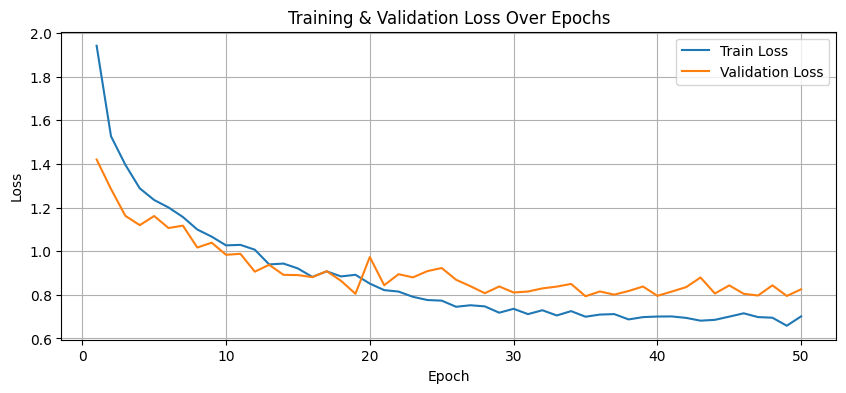

✅ Saved: /kaggle/working/output_images/accuracy_plot.png


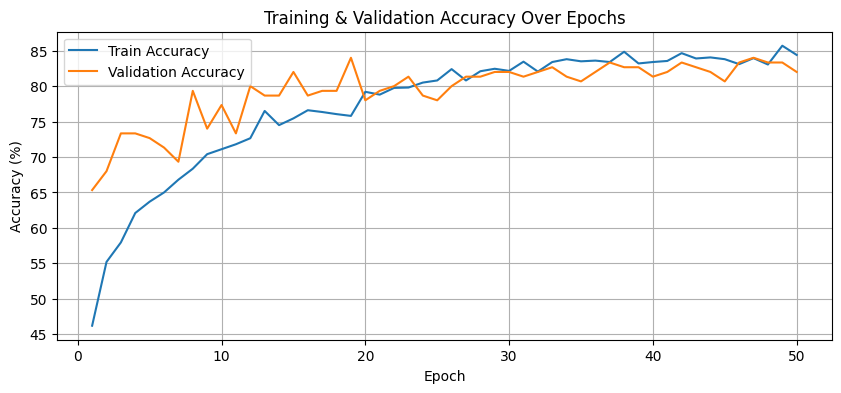

✅ Saved: /kaggle/working/output_images/auc_plot.png


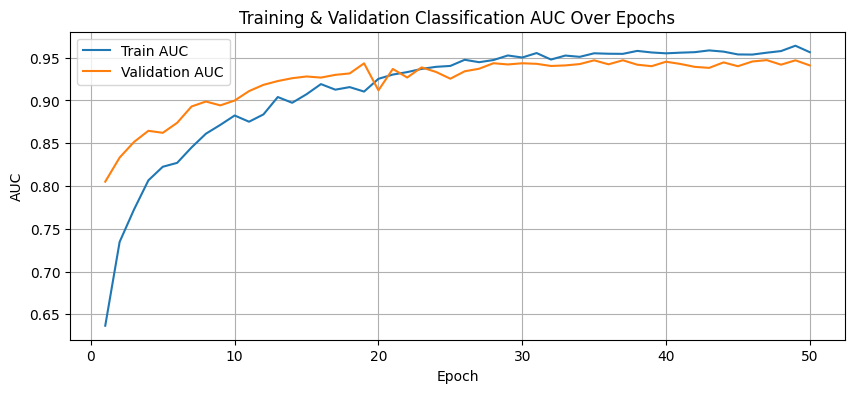

✅ Saved: /kaggle/working/output_images/dice_plot.png


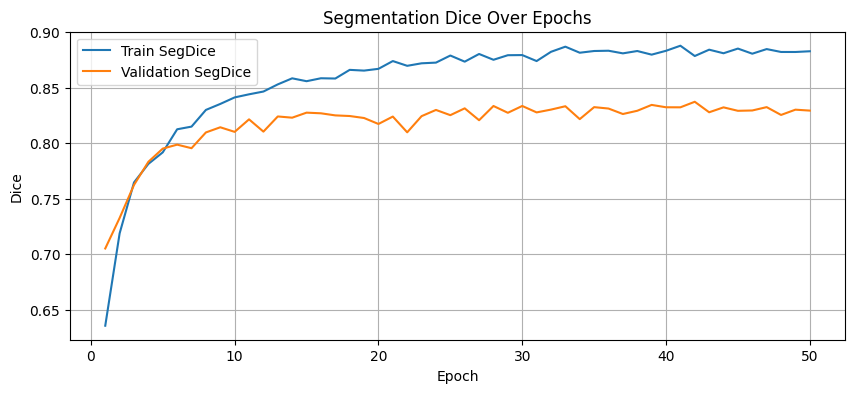

✅ Saved: /kaggle/working/output_images/feat_f1_plot.png


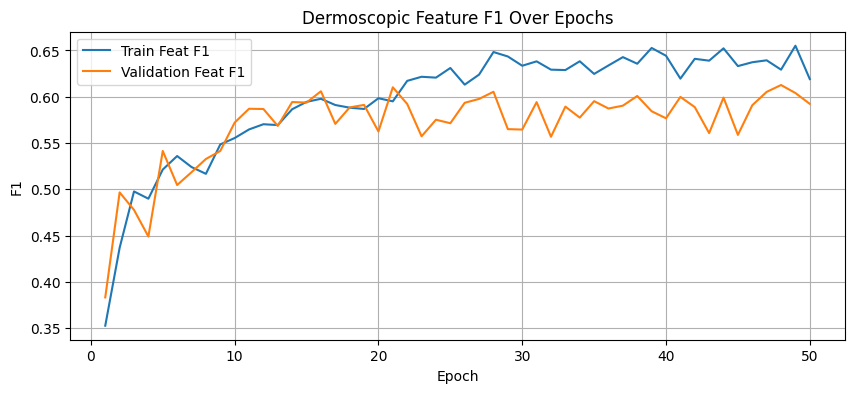


 All plots saved to: /kaggle/working/output_images


In [20]:
# Cell 11 — Plotting Training, Validation & Per-Class Metrics
import os
import pandas as pd
import matplotlib.pyplot as plt

print("--- Generating Training Plots ---")

# ✅ Create output folder
output_dir = "/kaggle/working/output_images"
os.makedirs(output_dir, exist_ok=True)

plot_history = {
    'epoch': list(range(1, len(history['train_loss']) + 1)),
    'train_loss': history['train_loss'],
    'val_loss': history['val_loss'],
    'train_acc': history['train_acc'],
    'val_acc': history['val_acc'],
    'train_auc': history['train_auc'],
    'val_auc': history['val_auc'],
    'train_dice': history['train_dice'],
    'val_dice': history['val_dice'],
    'train_feat_f1': history['train_feat_f1'],
    'val_feat_f1': history['val_feat_f1']
}

history_df = pd.DataFrame(plot_history)

def save_plot(fig_name):
    path = os.path.join(output_dir, fig_name)
    plt.savefig(path, bbox_inches='tight')
    print(f"✅ Saved: {path}")
    plt.show()

# ---------------- LOSS PLOT ----------------
plt.figure(figsize=(10, 4))
plt.plot(history_df['epoch'], history_df['train_loss'], label='Train Loss')
plt.plot(history_df['epoch'], history_df['val_loss'], label='Validation Loss')
plt.title('Training & Validation Loss Over Epochs')
plt.xlabel('Epoch'); plt.ylabel('Loss'); plt.legend(); plt.grid(True)
save_plot("loss_plot.png")

# ---------------- ACCURACY PLOT ----------------
plt.figure(figsize=(10, 4))
plt.plot(history_df['epoch'], history_df['train_acc'], label='Train Accuracy')
plt.plot(history_df['epoch'], history_df['val_acc'], label='Validation Accuracy')
plt.title('Training & Validation Accuracy Over Epochs')
plt.xlabel('Epoch'); plt.ylabel('Accuracy (%)'); plt.legend(); plt.grid(True)
save_plot("accuracy_plot.png")

# ---------------- AUC PLOT ----------------
plt.figure(figsize=(10, 4))
plt.plot(history_df['epoch'], history_df['train_auc'], label='Train AUC')
plt.plot(history_df['epoch'], history_df['val_auc'], label='Validation AUC')
plt.title('Training & Validation Classification AUC Over Epochs')
plt.xlabel('Epoch'); plt.ylabel('AUC'); plt.legend(); plt.grid(True)
save_plot("auc_plot.png")

# ---------------- DICE PLOT ----------------
plt.figure(figsize=(10, 4))
plt.plot(history_df['epoch'], history_df['train_dice'], label='Train SegDice')
plt.plot(history_df['epoch'], history_df['val_dice'], label='Validation SegDice')
plt.title('Segmentation Dice Over Epochs')
plt.xlabel('Epoch'); plt.ylabel('Dice'); plt.legend(); plt.grid(True)
save_plot("dice_plot.png")

# ---------------- FEATURE F1 PLOT ----------------
plt.figure(figsize=(10, 4))
plt.plot(history_df['epoch'], history_df['train_feat_f1'], label='Train Feat F1')
plt.plot(history_df['epoch'], history_df['val_feat_f1'], label='Validation Feat F1')
plt.title('Dermoscopic Feature F1 Over Epochs')
plt.xlabel('Epoch'); plt.ylabel('F1'); plt.legend(); plt.grid(True)
save_plot("feat_f1_plot.png")

# ---------------- PER-CLASS F1 (Training) ----------------
if 'train_class_reports' in history and len(history['train_class_reports']) > 0:
    nevus_f1_train = [h.get('nevus', {}).get('f1-score', 0.0) for h in history['train_class_reports']]
    melanoma_f1_train = [h.get('melanoma', {}).get('f1-score', 0.0) for h in history['train_class_reports']]
    sk_f1_train = [h.get('seborrheic_keratosis', {}).get('f1-score', 0.0) for h in history['train_class_reports']]

    plt.figure(figsize=(10, 4))
    plt.plot(history_df['epoch'], nevus_f1_train, label='Nevus F1 (Train)')
    plt.plot(history_df['epoch'], melanoma_f1_train, label='Melanoma F1 (Train)')
    plt.plot(history_df['epoch'], sk_f1_train, label='SK F1 (Train)')
    plt.title('Per-Class F1-Score (Training)')
    plt.xlabel('Epoch'); plt.ylabel('F1'); plt.legend(); plt.grid(True)
    save_plot("f1_train_plot.png")

# ---------------- PER-CLASS F1 (Validation) ----------------
if 'val_class_reports' in history and len(history['val_class_reports']) > 0:
    nevus_f1_val = [h.get('nevus', {}).get('f1-score', 0.0) for h in history['val_class_reports']]
    melanoma_f1_val = [h.get('melanoma', {}).get('f1-score', 0.0) for h in history['val_class_reports']]
    sk_f1_val = [h.get('seborrheic_keratosis', {}).get('f1-score', 0.0) for h in history['val_class_reports']]

    plt.figure(figsize=(10, 4))
    plt.plot(history_df['epoch'], nevus_f1_val, label='Nevus F1 (Val)')
    plt.plot(history_df['epoch'], melanoma_f1_val, label='Melanoma F1 (Val)')
    plt.plot(history_df['epoch'], sk_f1_val, label='SK F1 (Val)')
    plt.title('Per-Class F1-Score (Validation)')
    plt.xlabel('Epoch'); plt.ylabel('F1'); plt.legend(); plt.grid(True)
    save_plot("f1_val_plot.png")

print(f"\n All plots saved to: {output_dir}")


In [21]:
# Cell 12 — Final Test Evaluation (robust AUC-safe + accuracy + reports) on train model weights
from tqdm.notebook import tqdm

print("--- Starting Final Evaluation on Test Set ---")

output_dir = "/kaggle/working/output_images"
os.makedirs(output_dir, exist_ok=True)

load_path = "/kaggle/working/checkpoints/best_model.pth"
try:
    checkpoint = torch.load(load_path, map_location=device, weights_only=False)
    model.load_state_dict(checkpoint['model_state'])
    print(f"✅ Loaded best model from epoch {checkpoint.get('epoch', 'N/A')} "
          f"with ValScore {checkpoint.get('val_score', 'N/A'):.4f}")
except Exception as e:
    print(f"Could not load checkpoint: {e}. Evaluating with current model in memory.")


model.eval()
all_class_trues = []
all_class_preds_proba = []
all_feat_trues = []
all_feat_preds = []
seg_trues = []
seg_preds = []

from torch import amp

with torch.no_grad():
    for images, masks, classes, feats in tqdm(test_loader, desc="Testing"):
        images = images.to(device)
        masks = masks.to(device)
        classes = classes.to(device)
        feats = feats.to(device)

        with amp.autocast('cuda'):
            seg_logits, class_logits, feat_logits = model(images)

        # Convert model outputs to probabilities / predictions safely
        if class_logits is not None:
            # softmax for multiclass outputs (returns rows that should sum ~1)
            proba = torch.softmax(class_logits, dim=1).cpu().numpy()
        else:
            proba = np.zeros((images.size(0), len(CLASS_ORDER)))

        all_class_preds_proba.extend(proba.tolist())
        all_class_trues.extend(classes.cpu().numpy().tolist())

        # features: sigmoid probabilities
        all_feat_preds.extend(torch.sigmoid(feat_logits).cpu().numpy().tolist())
        all_feat_trues.extend(feats.cpu().numpy().tolist())

        # segmentation: predicted mask (binary) flattened to list of pixels
        seg_preds.extend((torch.sigmoid(seg_logits) > 0.5).long().cpu().numpy().reshape(-1).tolist())
        seg_trues.extend((masks > 0.5).long().cpu().numpy().reshape(-1).tolist())

# --------------------------
# Metrics (AUC-safe & summary)
# --------------------------
# Convert to numpy arrays
y_true = np.array(all_class_trues)
y_proba = np.array(all_class_preds_proba, dtype=np.float64)

# --- SAFE MULTICLASS AUC COMPUTATION (same logic as training) ---
test_auc = 0.5
try:
    if y_proba.ndim == 2 and y_true.ndim == 1 and y_proba.shape[0] == y_true.shape[0]:
        unique_labels = np.unique(y_true)
        if len(unique_labels) > 1:
            # Renormalize rows to ensure probabilities sum to 1
            row_sums = y_proba.sum(axis=1, keepdims=True)
            row_sums[row_sums == 0] = 1.0
            y_proba = y_proba / row_sums

            test_auc = roc_auc_score(y_true, y_proba, multi_class='ovr', average='macro')
            print(f"Test Multi-class AUC (ovr, macro): {test_auc:.4f}")
        else:
            print("[WARN] Test: only one class present across all samples, AUC skipped.")
            test_auc = 0.5
    else:
        raise ValueError(f"Invalid shapes for AUC: probs {y_proba.shape}, labels {y_true.shape}")
except Exception as e:
    print(f"[WARN] Test AUC computation failed: {e}")
    print(f"  y_true shape: {y_true.shape}, unique: {set(y_true.tolist())}")
    print(f"  y_proba shape: {y_proba.shape}")
    if y_proba.shape[0] > 0:
        print(f"  Sample probs (first row): {y_proba[0]}")
    test_auc = 0.5

# --- Predicted labels (from normalized probabilities) ---
y_pred = np.argmax(y_proba, axis=1) if y_proba.size > 0 else np.array([])

# --- Classification report & save ---
test_class_report_str = classification_report(y_true, y_pred, target_names=CLASS_ORDER, zero_division=0)
test_class_report_dict = classification_report(y_true, y_pred, target_names=CLASS_ORDER, zero_division=0, output_dict=True)
print(test_class_report_str)
pd.DataFrame(test_class_report_dict).transpose().to_csv(f"{output_dir}/classification_report.csv", index=True)

# --- Overall accuracy ---
test_accuracy = test_class_report_dict.get("accuracy", None)
if test_accuracy is not None:
    print(f"Test Accuracy: {test_accuracy * 100:.2f}%")
else:
    test_accuracy = (y_pred == y_true).mean() if y_pred.size > 0 else 0.0
    print(f"Test Accuracy (computed manually): {test_accuracy * 100:.2f}%")

print("-----------------------------------------------------------------------------------")

# --- Segmentation metrics ---
try:
    test_seg_dice = f1_score(seg_trues, seg_preds, average='binary', zero_division=0)
    test_seg_iou  = jaccard_score(seg_trues, seg_preds, average='binary', zero_division=0)
    print(f"Test Segmentation Dice (F1): {test_seg_dice:.4f}")
    print(f"Test Segmentation IoU (Jaccard): {test_seg_iou:.4f}")
except Exception as e:
    print(f"[WARN] Could not calculate Test Segmentation metrics: {e}")

print("-----------------------------------------------------------------------------------")

# --- Feature detection metrics ---
try:
    test_feat_preds_bin = (np.array(all_feat_preds) > 0.5).astype(int)
    test_feat_trues_arr = np.array(all_feat_trues).astype(int)
    test_feat_f1 = f1_score(test_feat_trues_arr, test_feat_preds_bin, average='macro', zero_division=0)
    print(f"Test Feature macro-F1: {test_feat_f1:.4f}")
except Exception as e:
    print(f"[WARN] Could not calculate Test Feature metrics: {e}")

print("-----------------------------------------------------------------------------------")

# --- Per-class AUCs (one-vs-rest) ---
try:
    n_classes = y_proba.shape[1]
    aucs = []
    for i in range(n_classes):
        true_bin = (y_true == i).astype(int)
        auc_i = roc_auc_score(true_bin, y_proba[:, i])
        aucs.append(auc_i)
        print(f"AUC for class '{CLASS_ORDER[i]}': {auc_i:.4f}")
    print(f"\nMean One-vs-Rest AUC: {np.mean(aucs):.4f}")
except Exception as e:
    print(f"[WARN] Could not compute per-class AUC: {e}")



--- Starting Final Evaluation on Test Set ---
✅ Loaded best model from epoch 47 with ValScore 0.8362


Testing:   0%|          | 0/75 [00:00<?, ?it/s]

Test Multi-class AUC (ovr, macro): 0.8881
                      precision    recall  f1-score   support

               nevus       0.89      0.80      0.84       393
            melanoma       0.56      0.62      0.59       117
seborrheic_keratosis       0.59      0.77      0.67        90

            accuracy                           0.76       600
           macro avg       0.68      0.73      0.70       600
        weighted avg       0.78      0.76      0.76       600

Test Accuracy: 75.83%
-----------------------------------------------------------------------------------
Test Segmentation Dice (F1): 0.8319
Test Segmentation IoU (Jaccard): 0.7122
-----------------------------------------------------------------------------------
Test Feature macro-F1: 0.1712
-----------------------------------------------------------------------------------
AUC for class 'nevus': 0.8909
AUC for class 'melanoma': 0.8460
AUC for class 'seborrheic_keratosis': 0.9275

Mean One-vs-Rest AUC: 0.8881


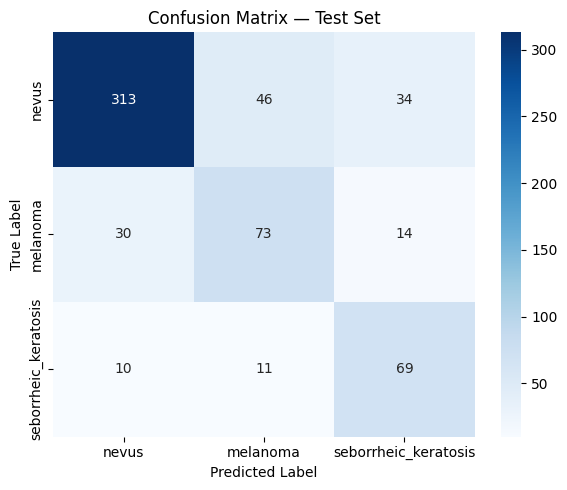

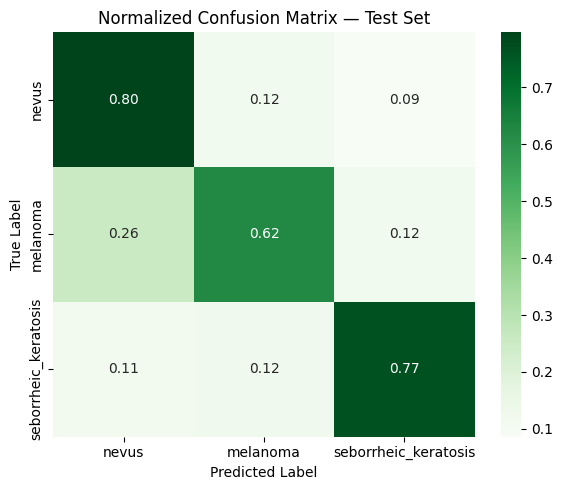


✅ All plots and reports saved to: /kaggle/working/output_images


In [24]:
#Test data plots for train model weights
# --- Confusion matrices & plots ---
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=CLASS_ORDER, yticklabels=CLASS_ORDER)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix — Test Set")
plt.tight_layout()
plt.savefig(f"{output_dir}/confusion_matrix_raw.png")
plt.show()

# normalized
cm_norm = cm.astype('float') / cm.sum(axis=1, keepdims=True)
plt.figure(figsize=(6, 5))
sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Greens',
            xticklabels=CLASS_ORDER, yticklabels=CLASS_ORDER)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Normalized Confusion Matrix — Test Set")
plt.tight_layout()
plt.savefig(f"{output_dir}/confusion_matrix_norm.png")
plt.show()

print(f"\n✅ All plots and reports saved to: {output_dir}")


In [25]:
# Cell 13 — print saved reports train model weights

try:
    df_val_report = pd.DataFrame(history['best_val_report']).transpose()
    print("\n--- METRICS FROM BEST VALIDATION EPOCH ---")
    display(df_val_report)
except Exception as e:
    print(f"Could not display best validation report: {e}")

print("-----------------------------------------------------------------------------------")

try:
    df_test_report = pd.DataFrame(test_class_report_dict).transpose()
    print("\n--- METRICS FROM FINAL TEST SET ---")
    display(df_test_report)
except Exception as e:
    print(f"Could not display final test report: {e}")



--- METRICS FROM BEST VALIDATION EPOCH ---


,precision,recall,f1-score,support
nevus,0.855422,0.910256,0.881988,78.00
melanoma,0.720000,0.600000,0.654545,30.00
seborrheic_keratosis,0.880952,0.880952,0.880952,42.00
accuracy,0.840000,0.840000,0.840000,0.84
macro avg,0.818791,0.797070,0.805828,150.00
weighted avg,0.835486,0.840000,0.836209,150.00


-----------------------------------------------------------------------------------

--- METRICS FROM FINAL TEST SET ---


,precision,recall,f1-score,support
nevus,0.886686,0.796438,0.839142,393.000000
melanoma,0.561538,0.623932,0.591093,117.000000
seborrheic_keratosis,0.589744,0.766667,0.666667,90.000000
accuracy,0.758333,0.758333,0.758333,0.758333
macro avg,0.679323,0.729012,0.698967,600.000000
weighted avg,0.778741,0.758333,0.764901,600.000000


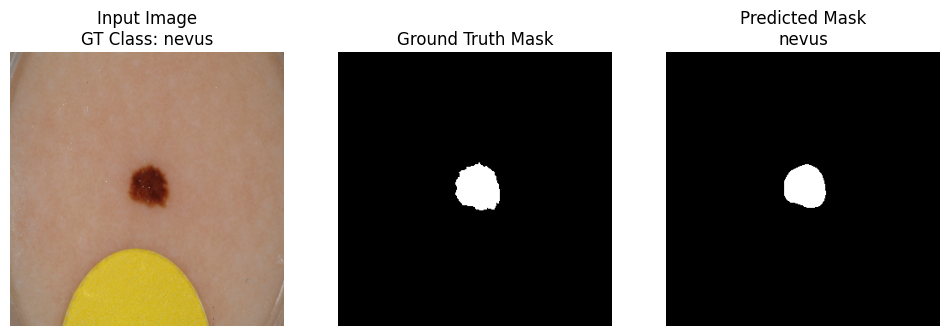

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


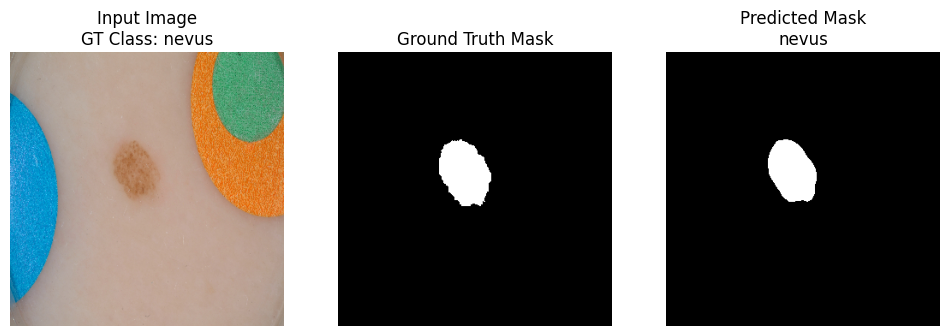

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


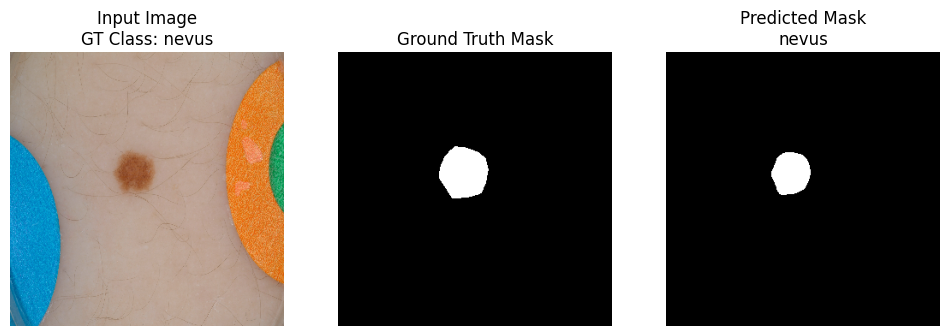

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


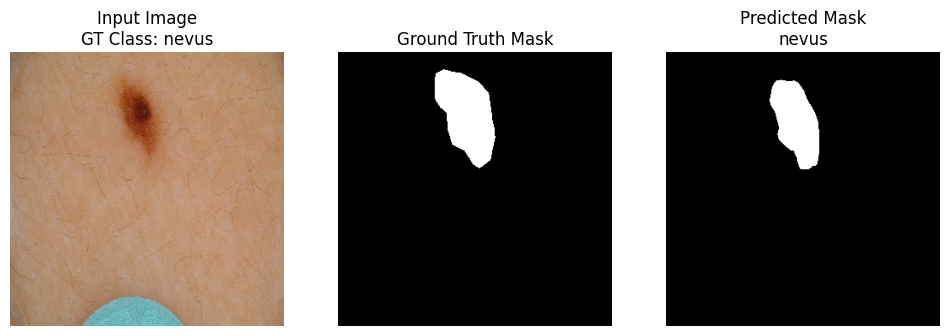

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


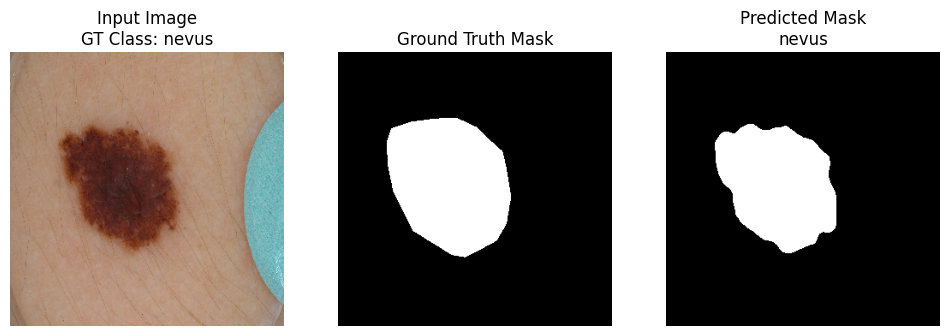

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


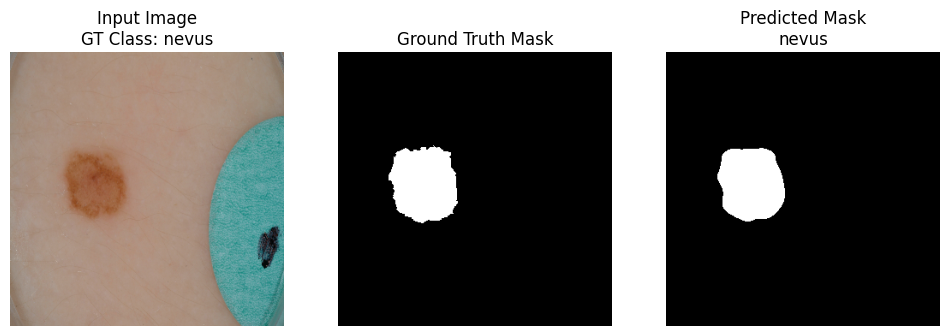

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


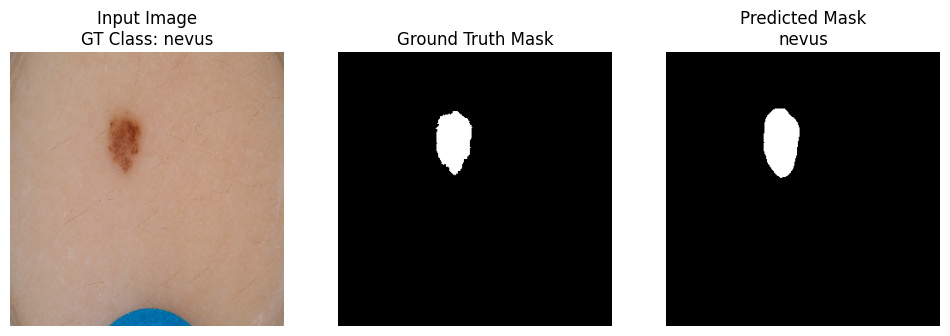

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


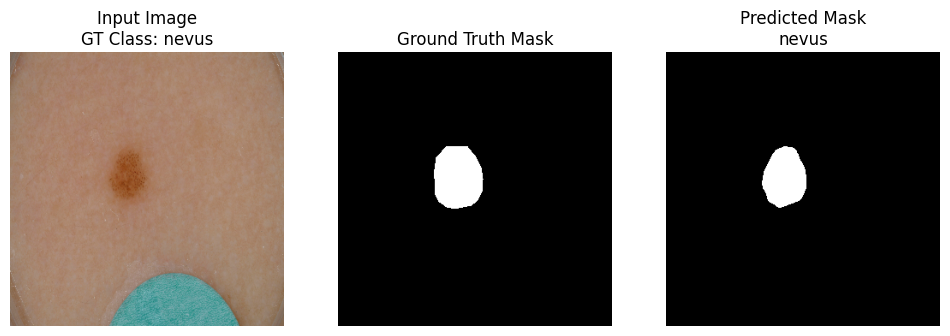

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


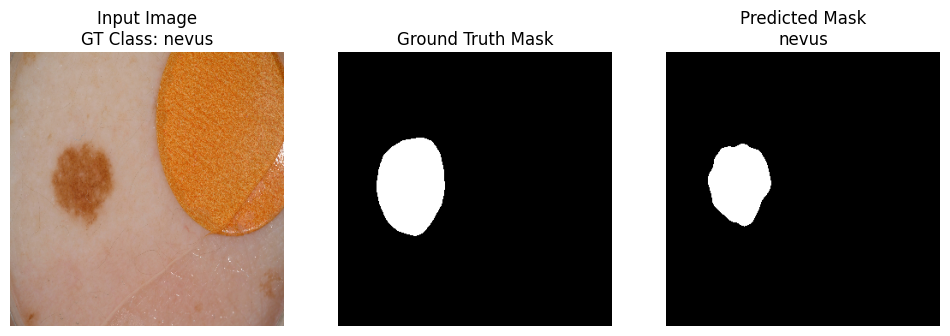

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


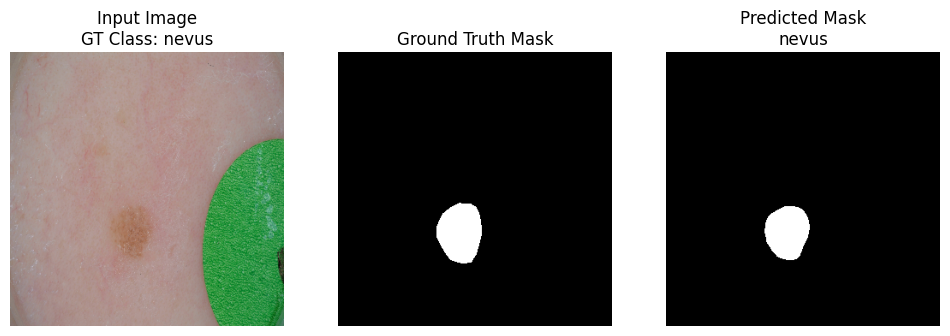

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


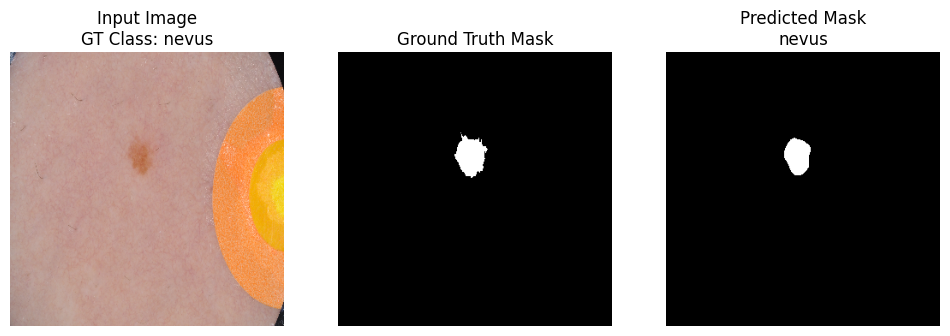

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


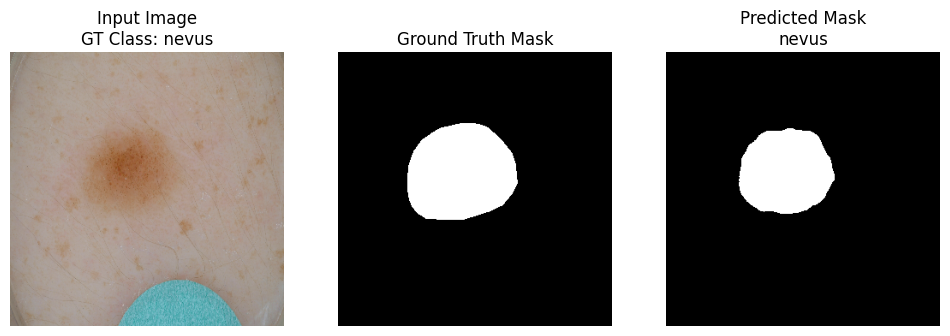

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


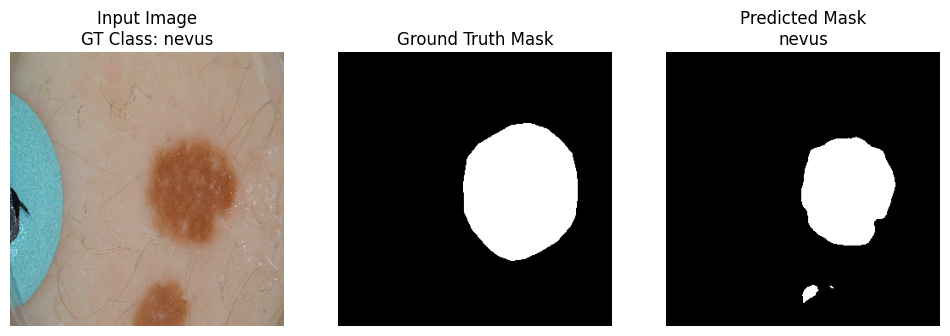

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


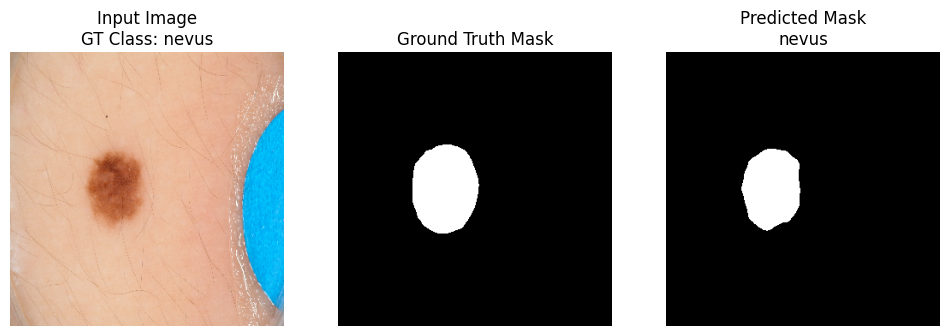

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


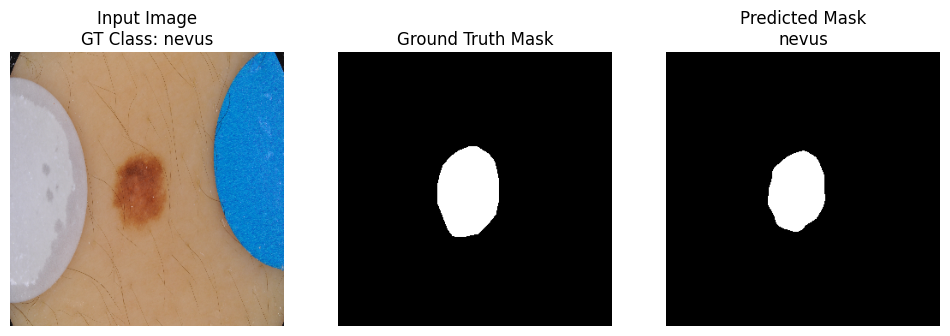

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


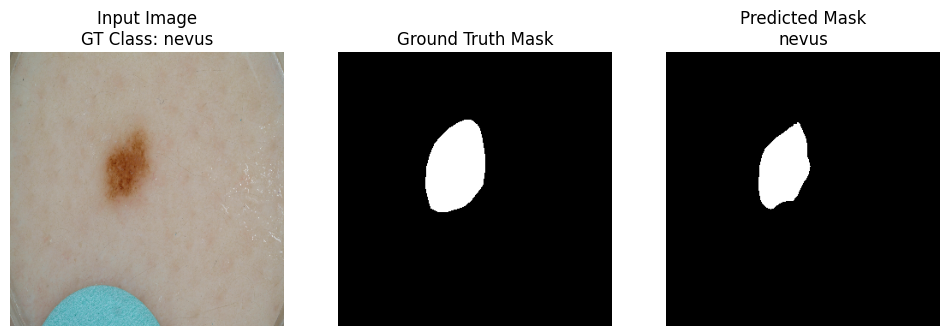

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


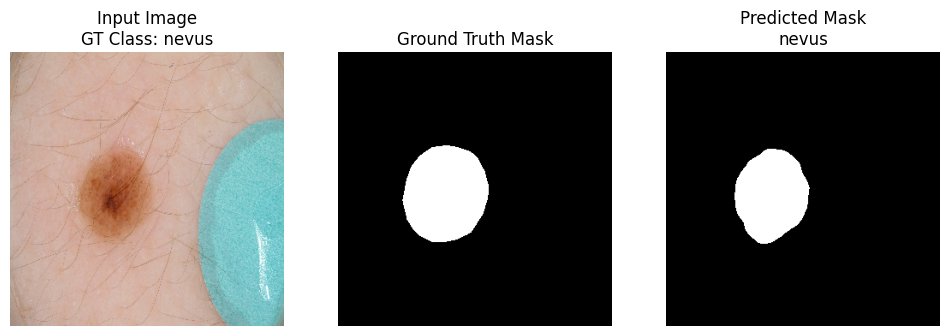

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


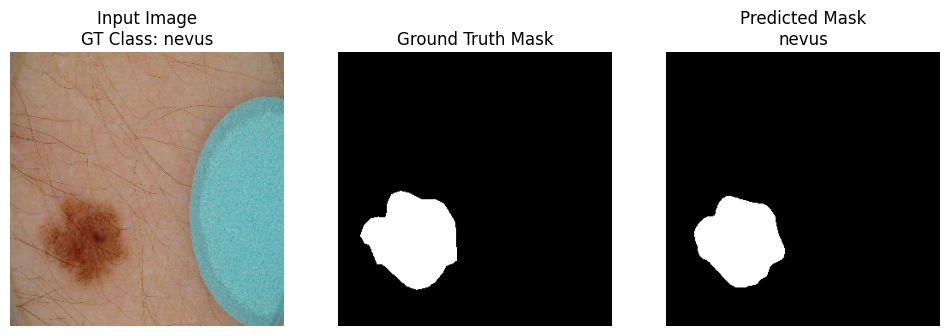

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


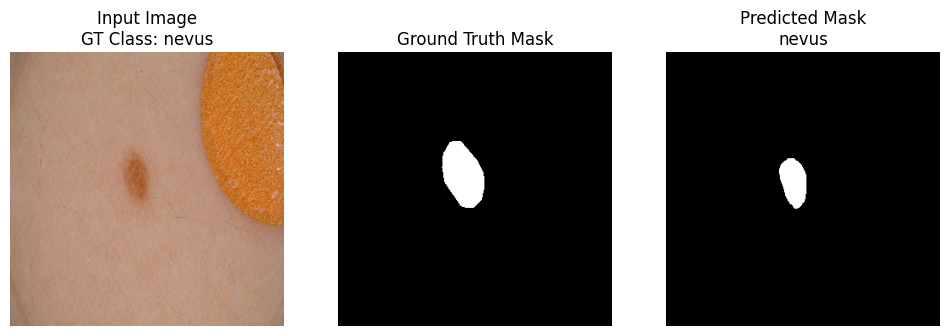

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


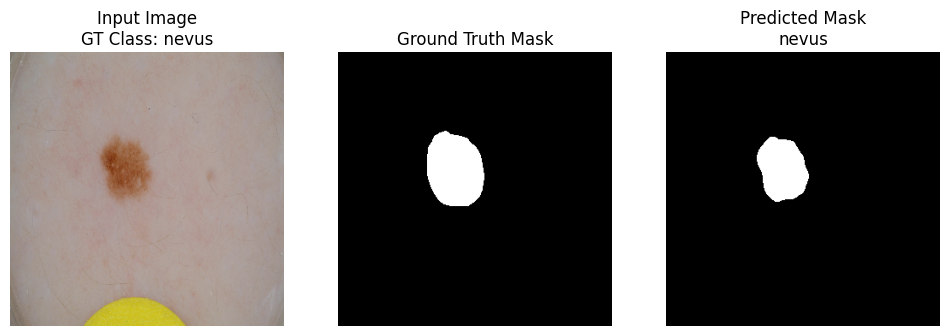

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


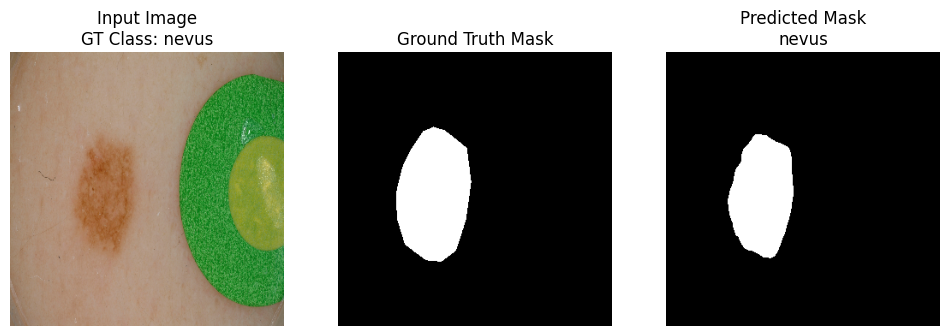

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


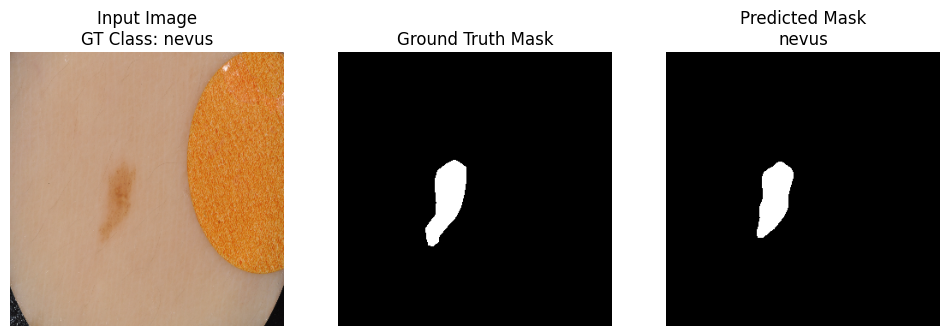

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


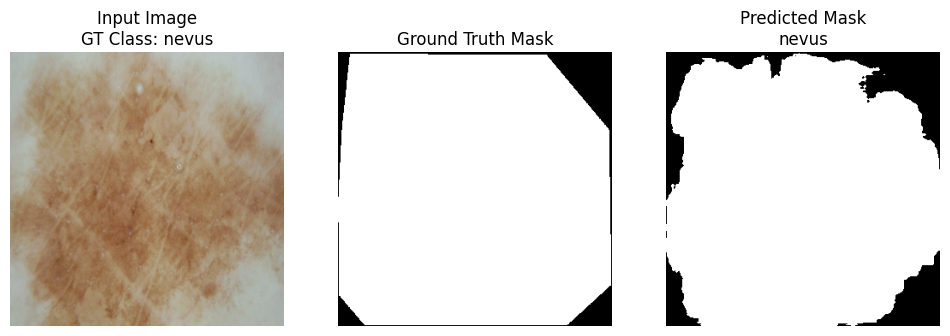

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


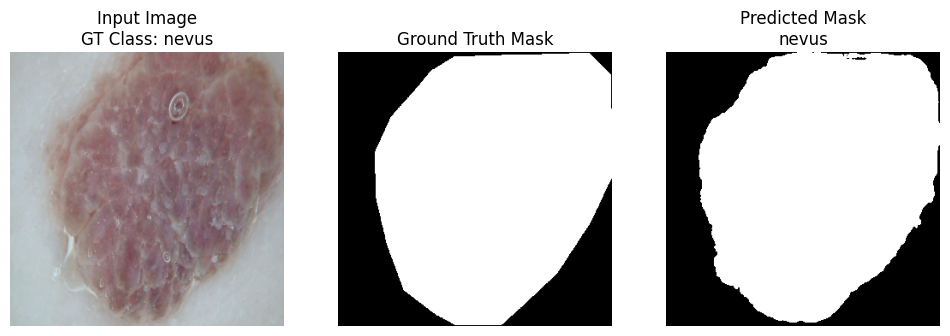

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


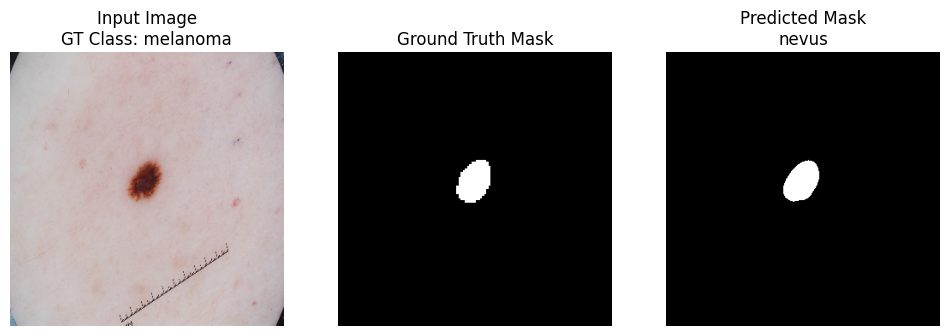

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✗,1
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


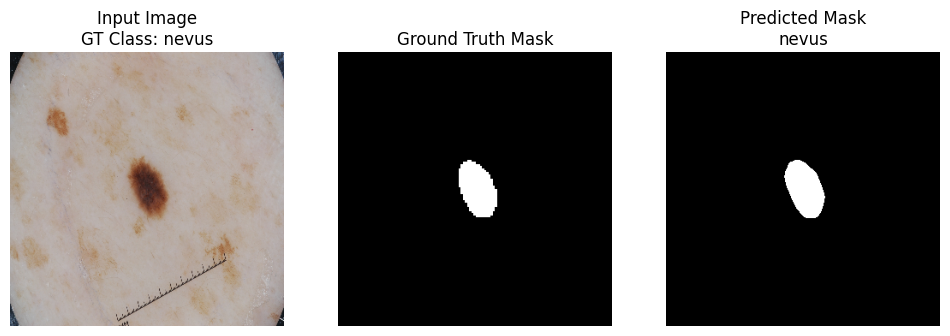

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


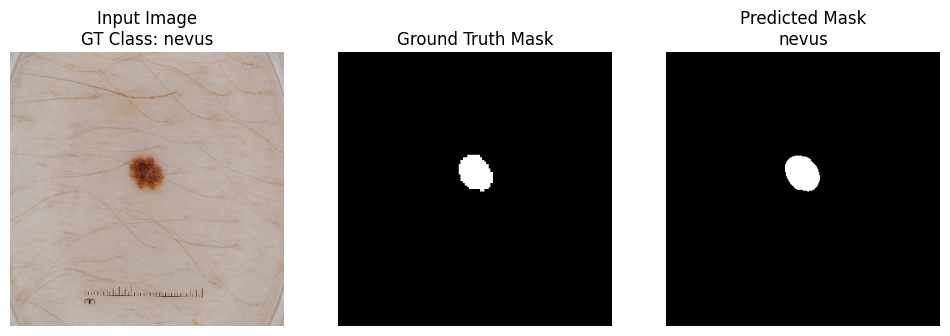

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


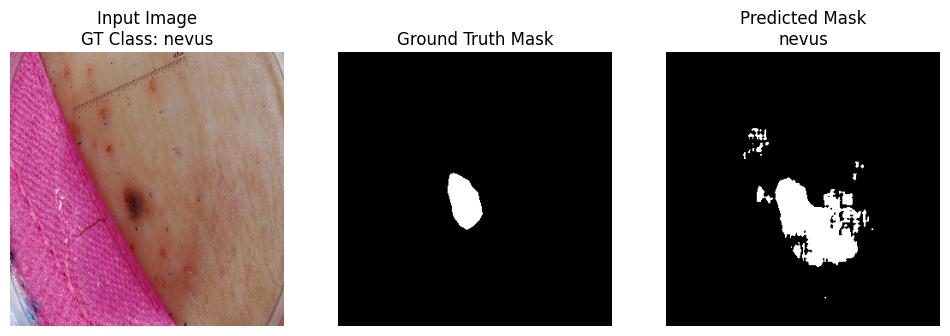

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


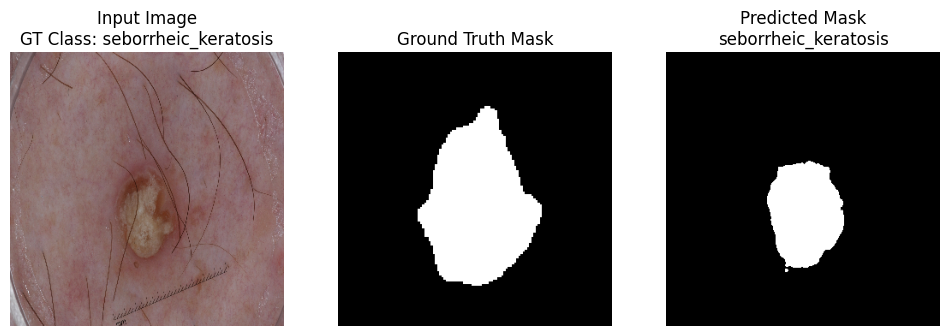

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


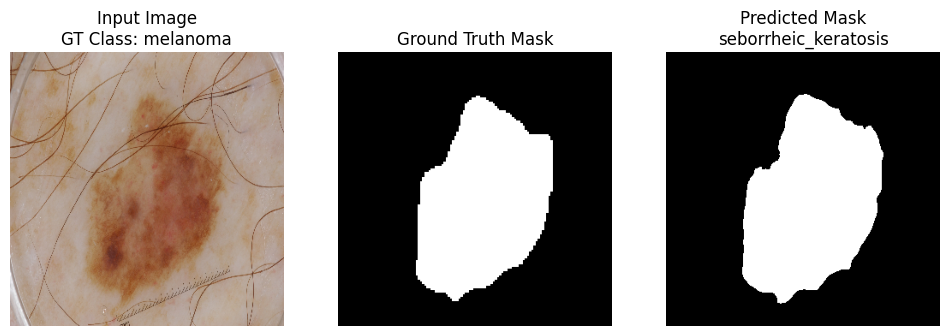

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


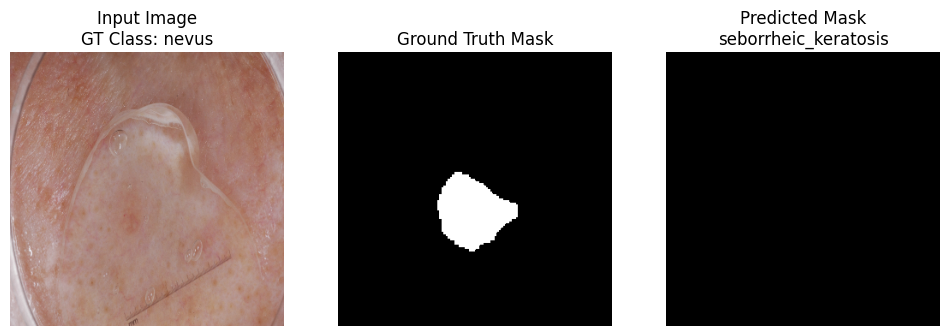

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


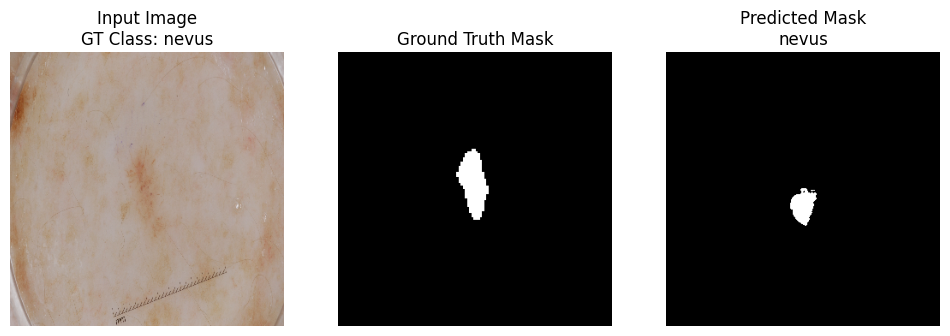

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


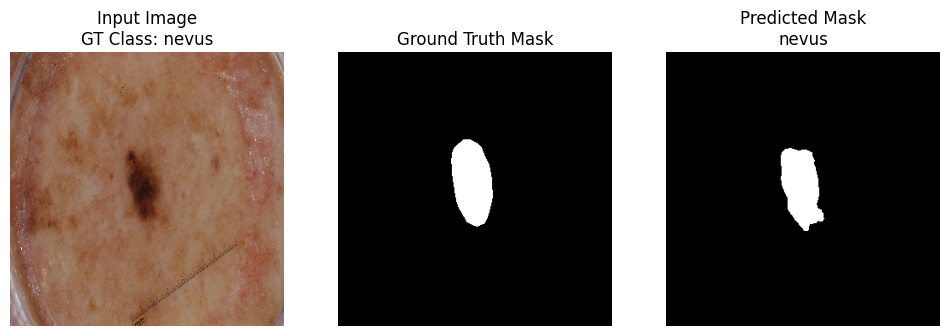

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


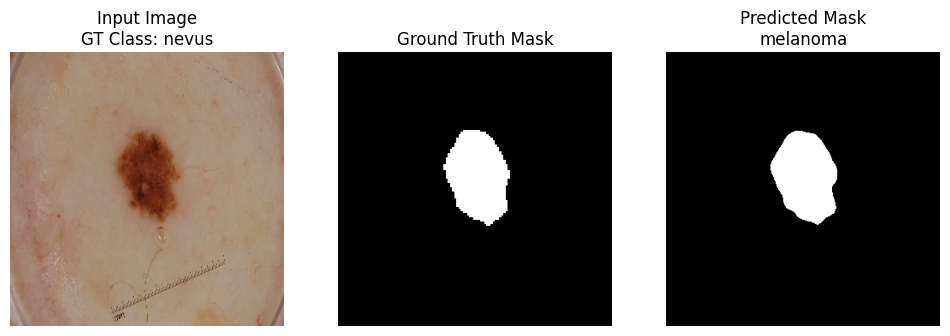

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


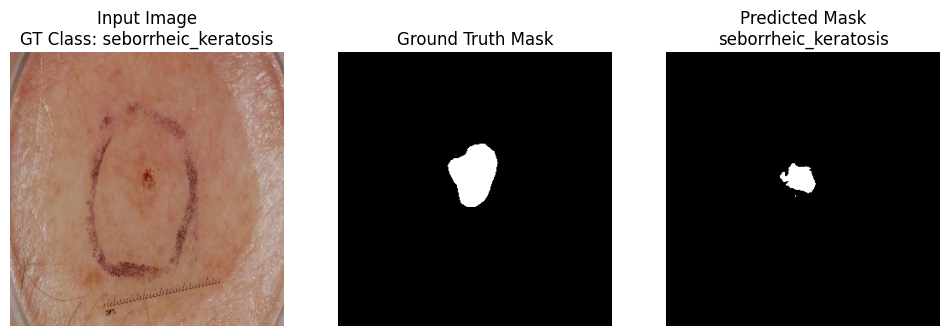

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


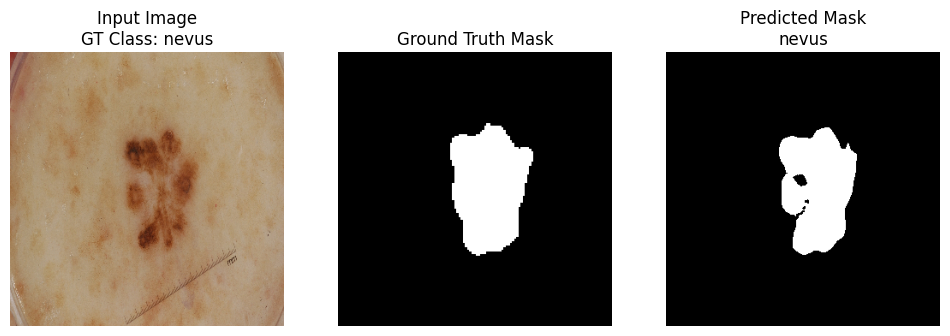

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


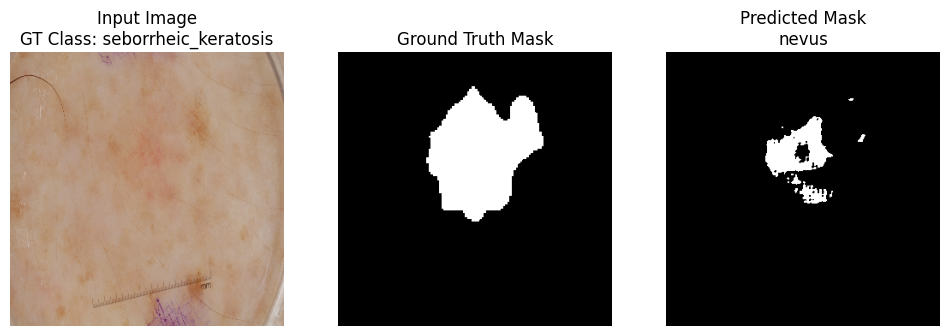

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


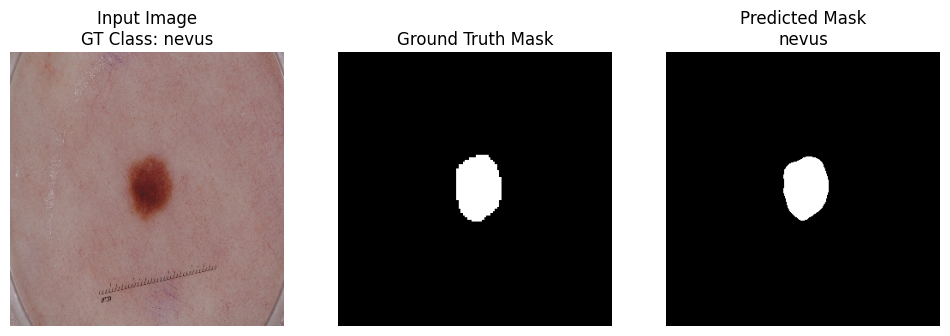

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


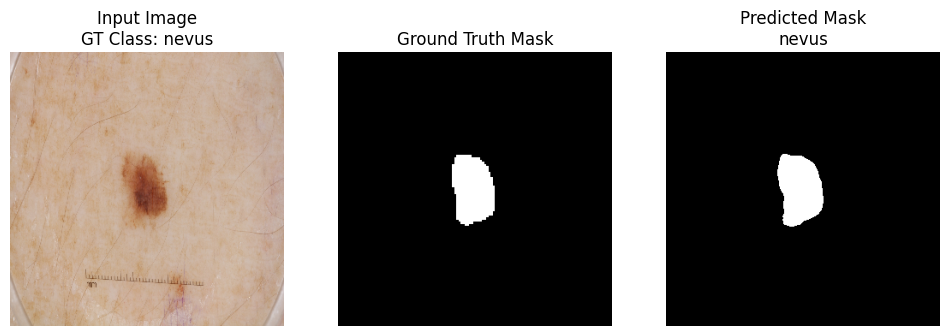

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


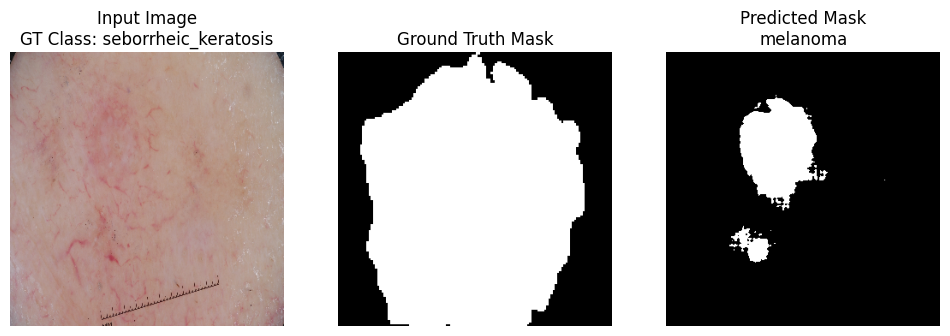

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


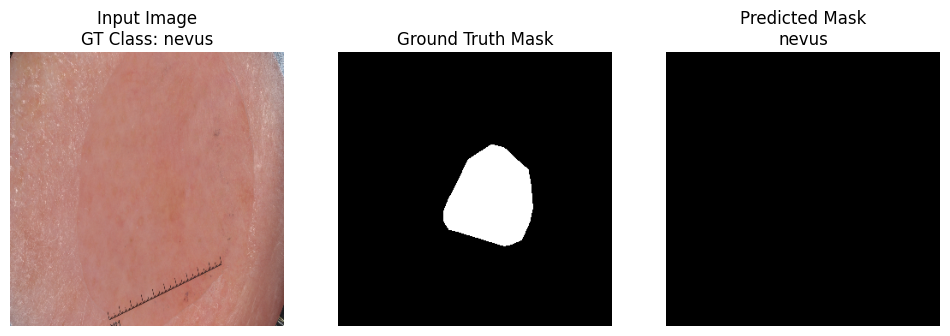

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


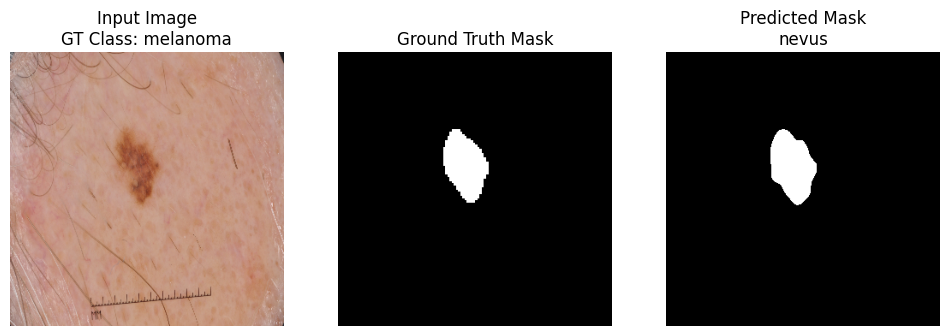

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


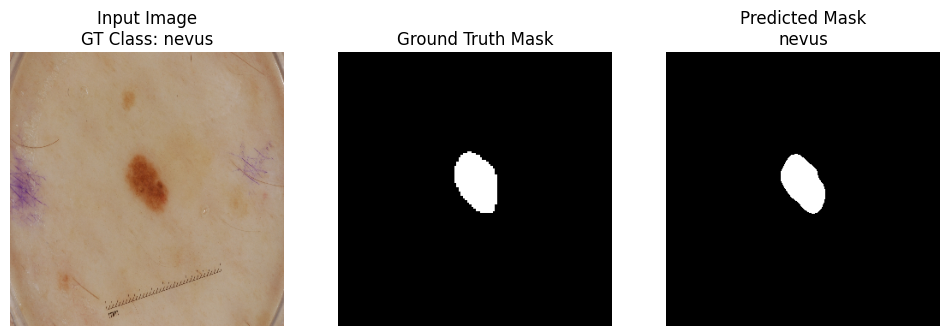

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


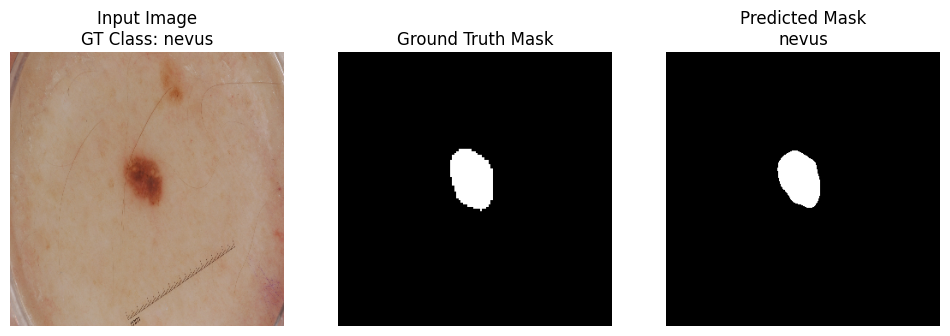

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


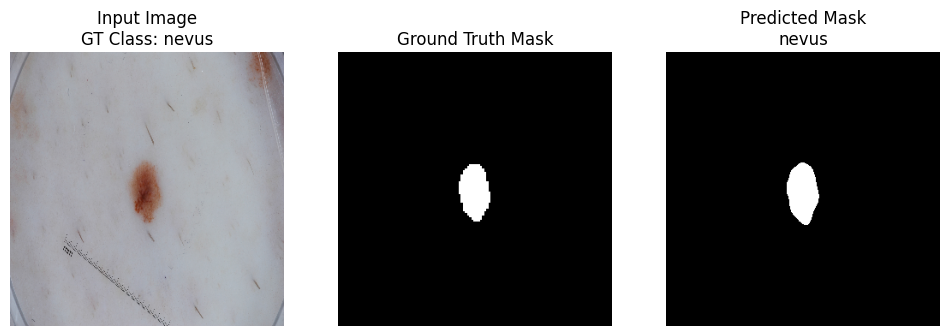

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


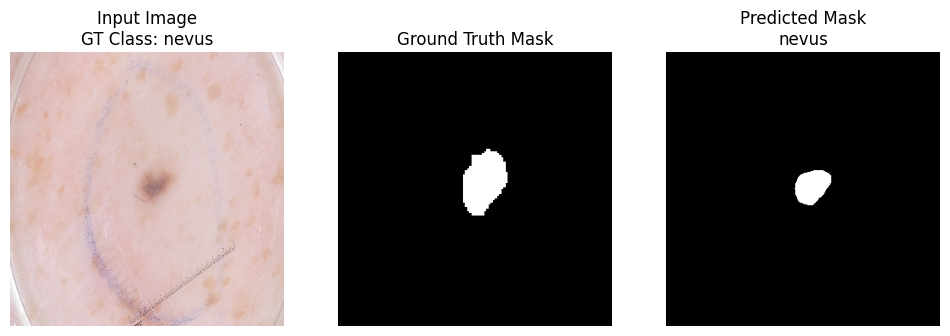

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


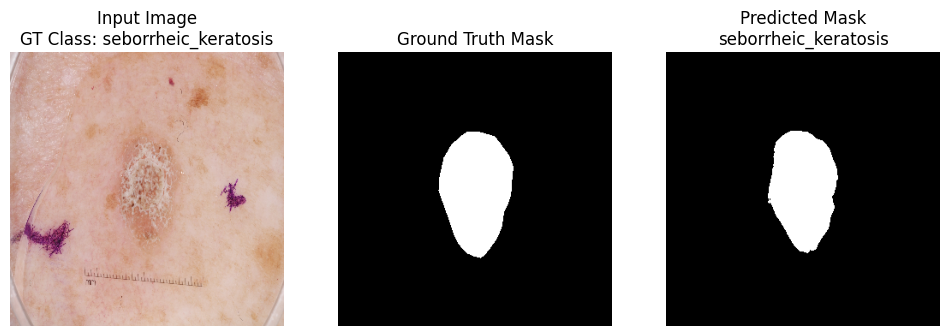

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


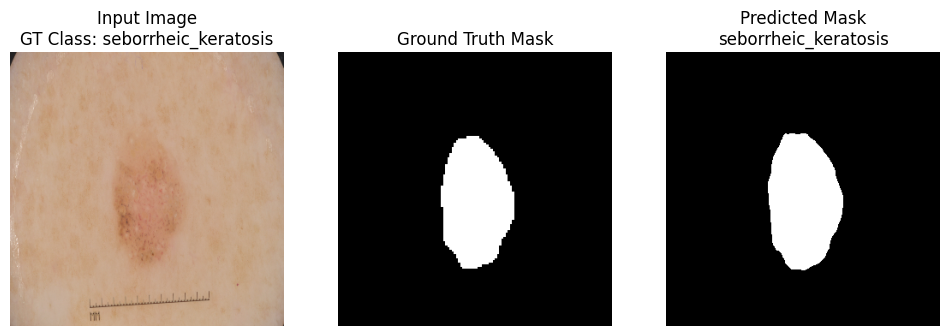

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


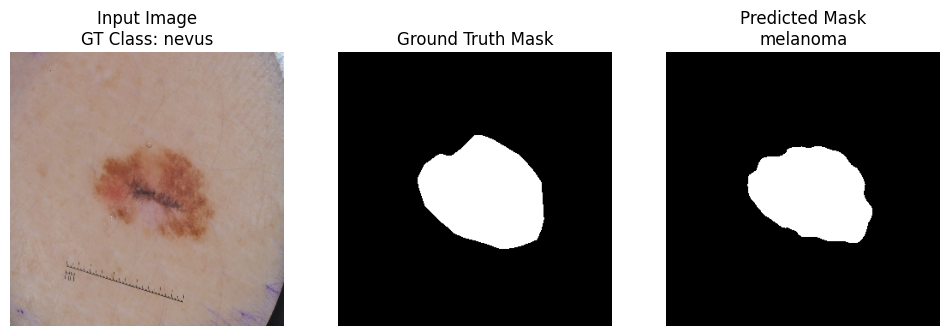

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


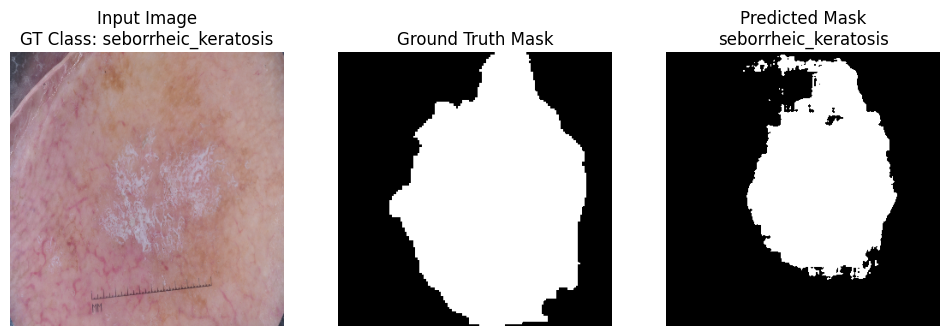

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


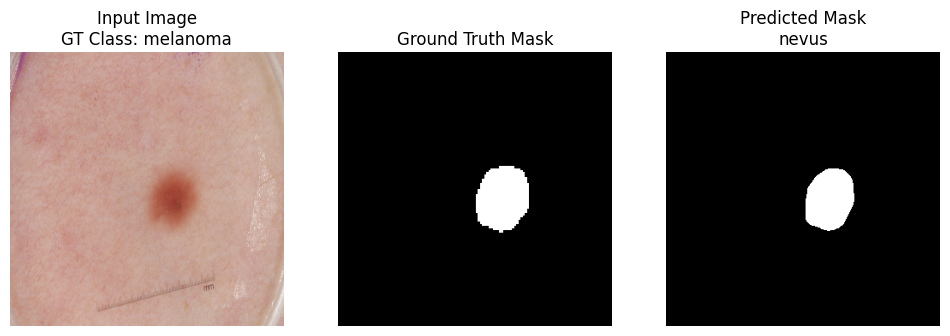

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


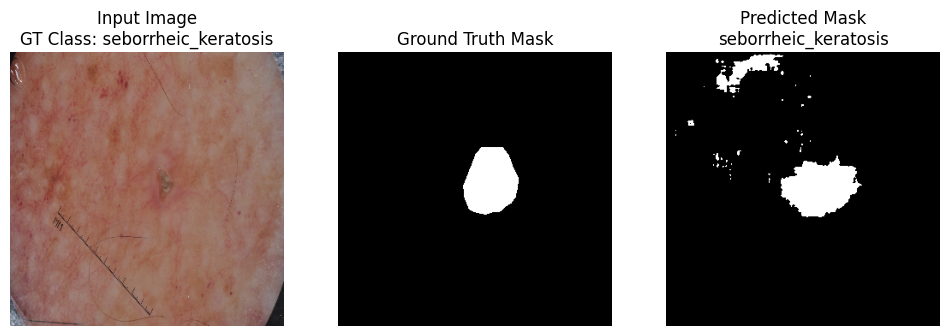

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


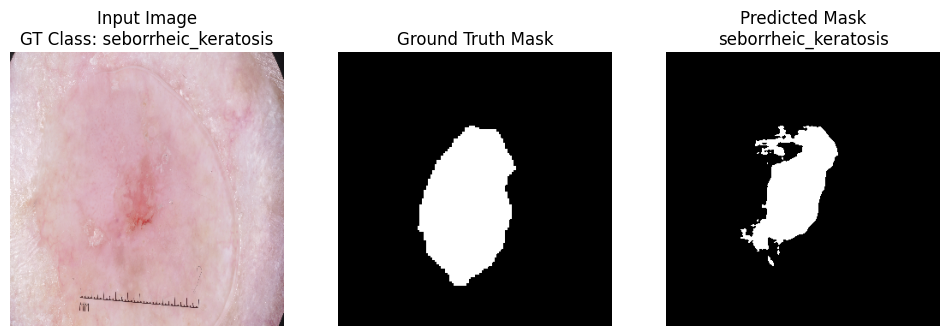

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


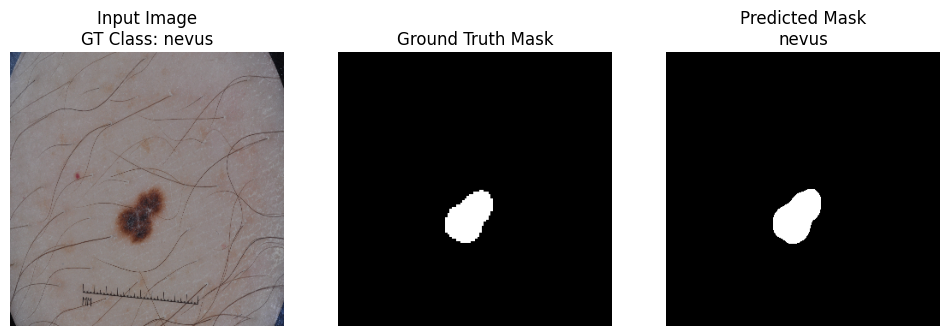

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


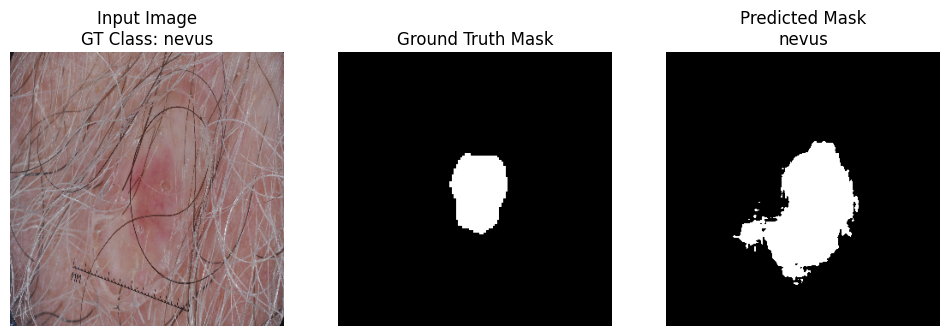

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


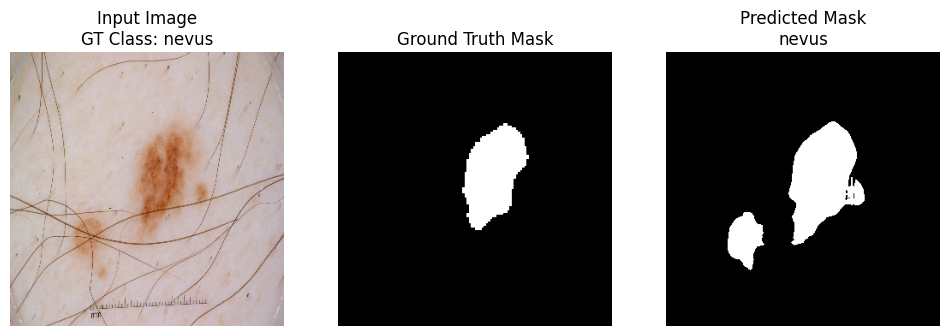

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


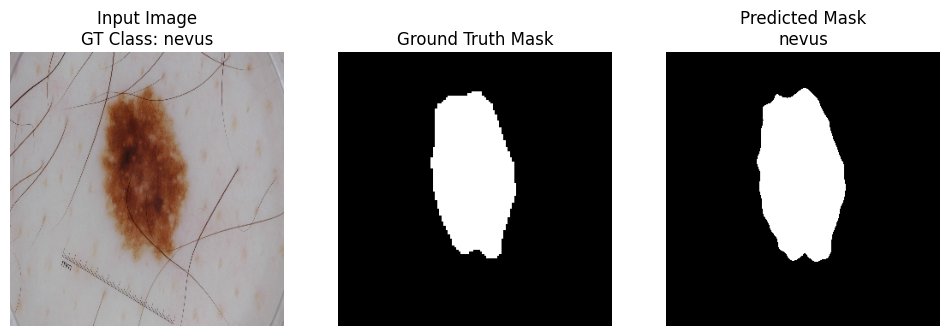

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


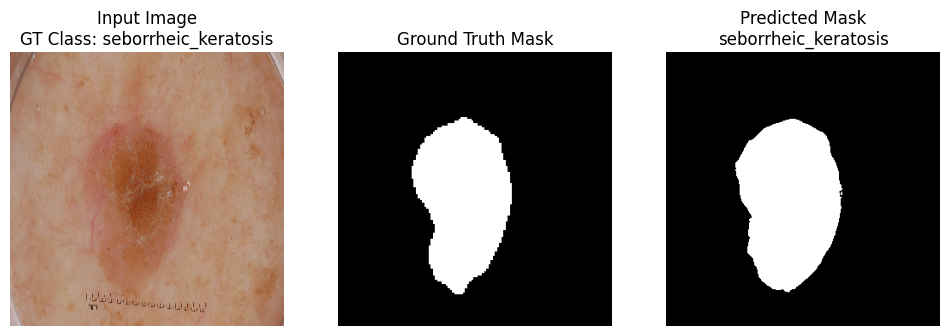

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


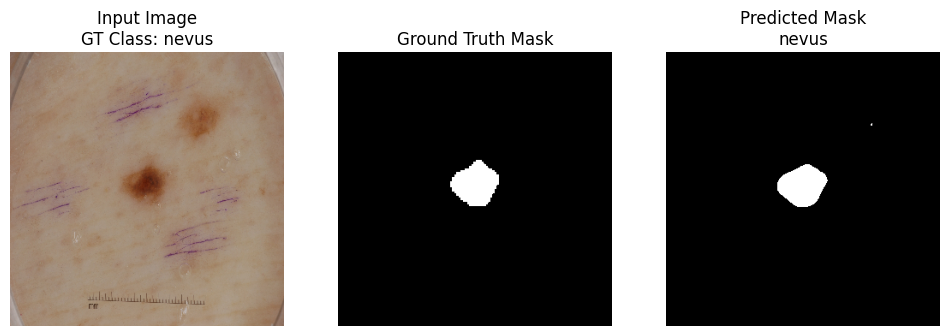

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


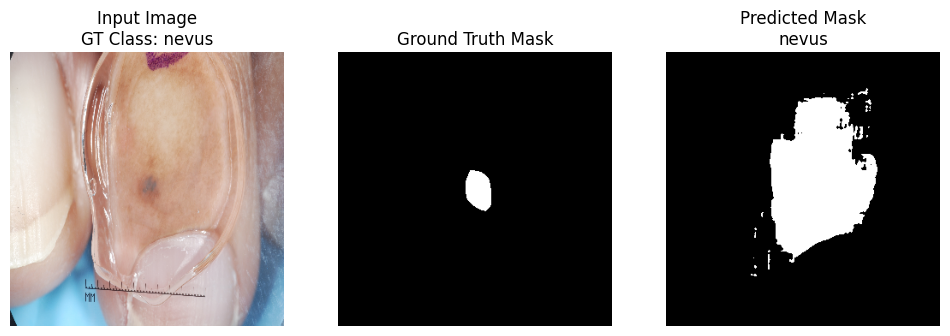

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


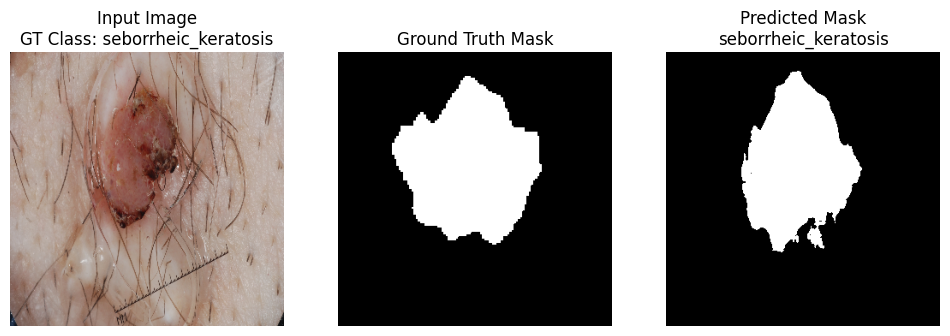

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


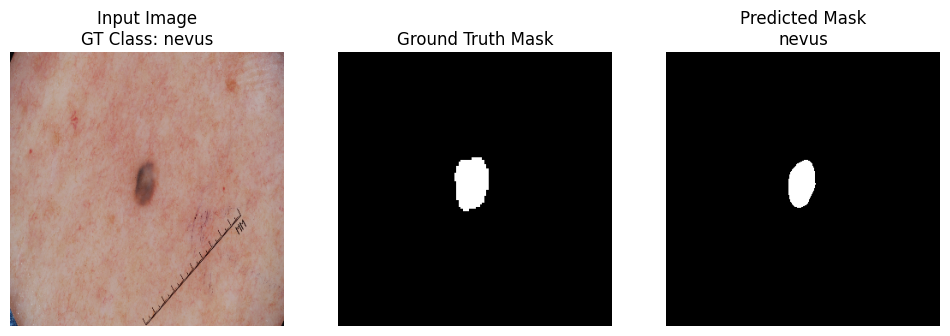

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


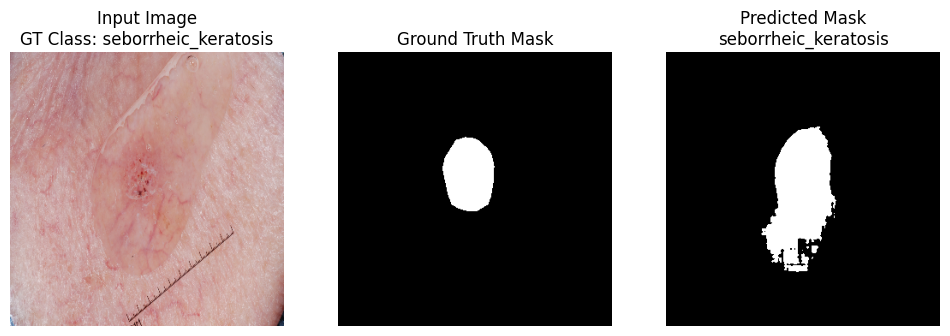

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


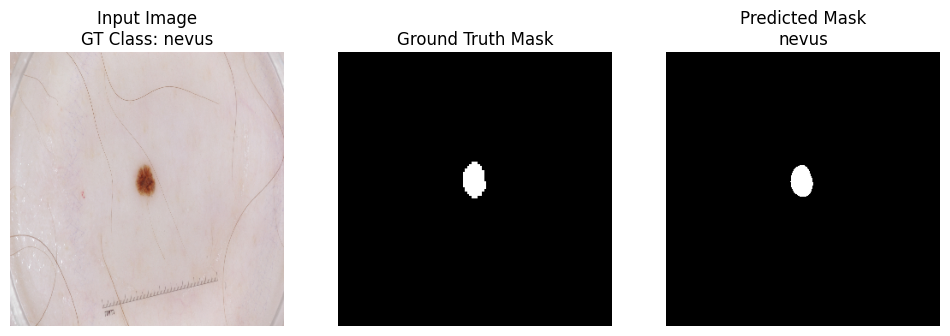

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


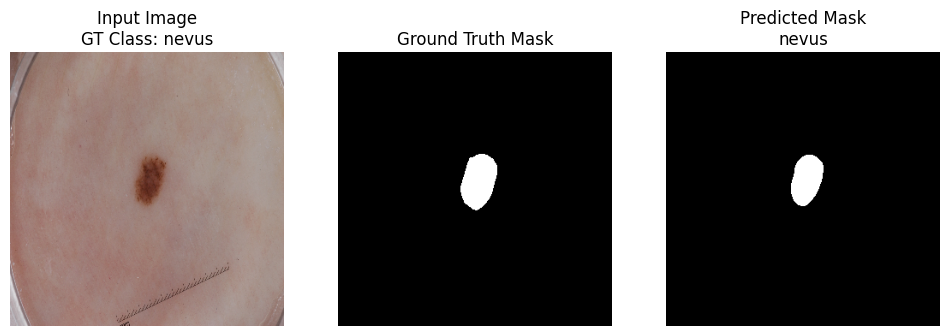

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


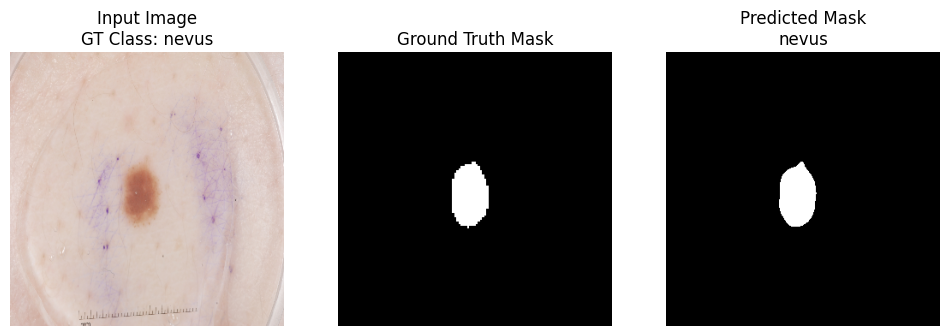

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


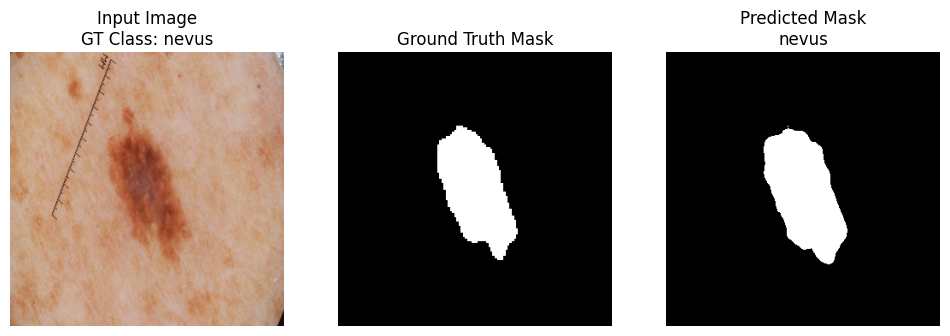

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


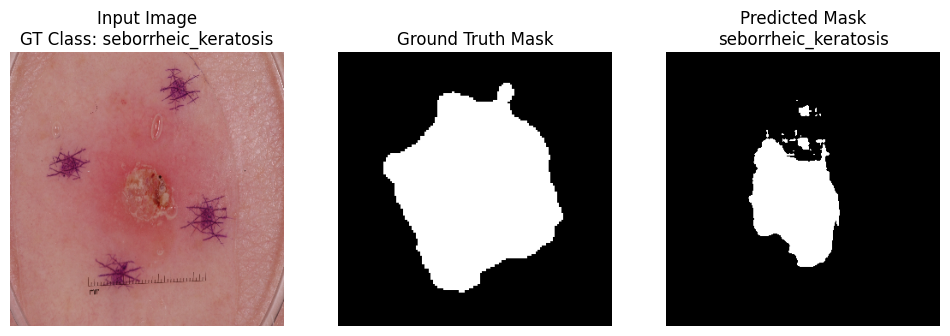

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


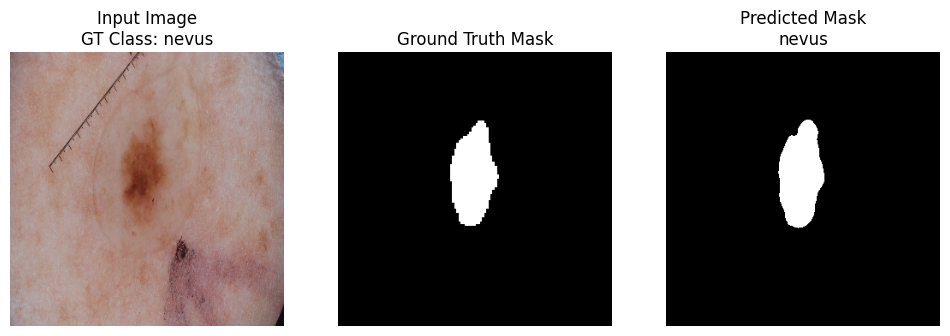

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


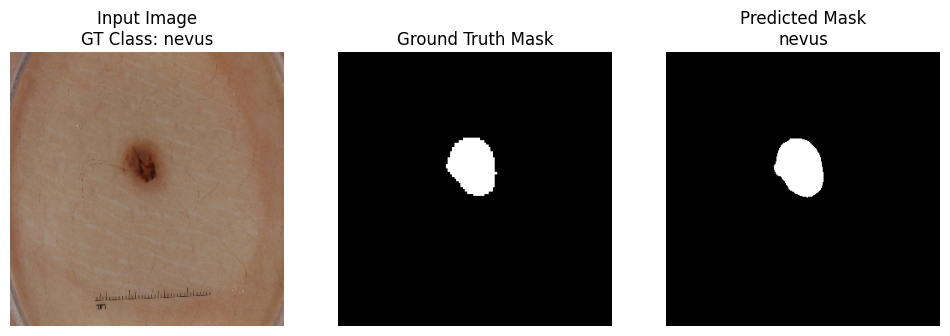

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


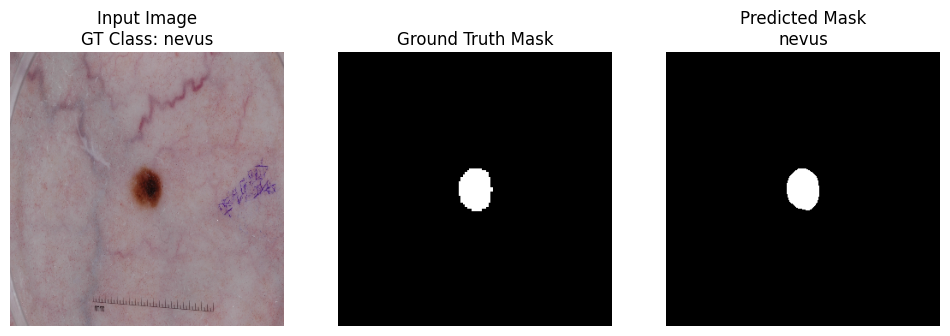

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


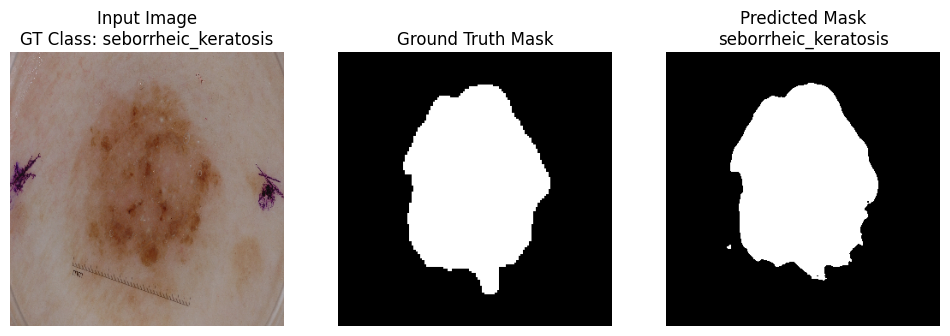

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


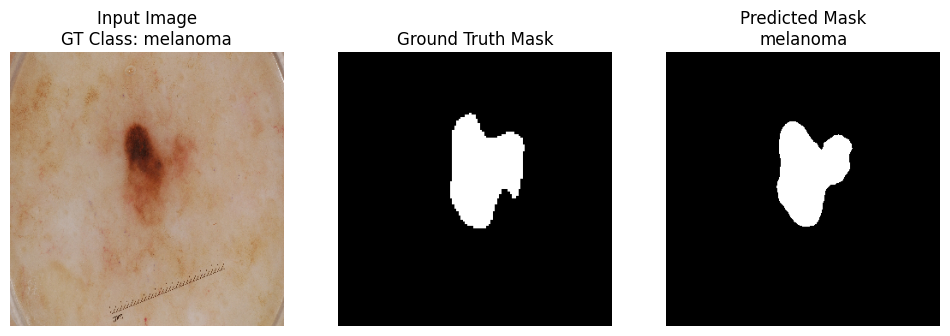

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


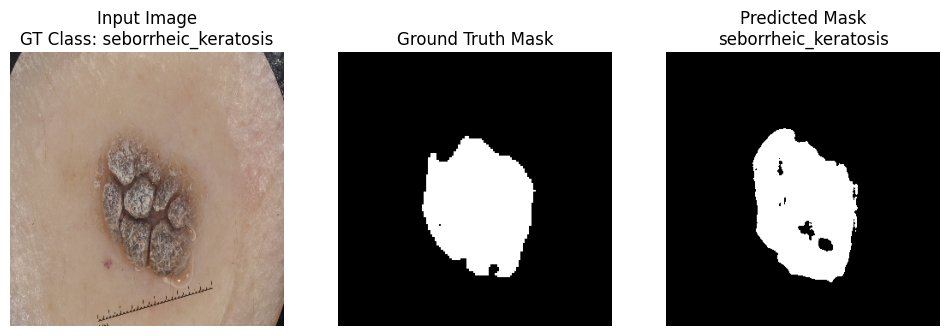

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


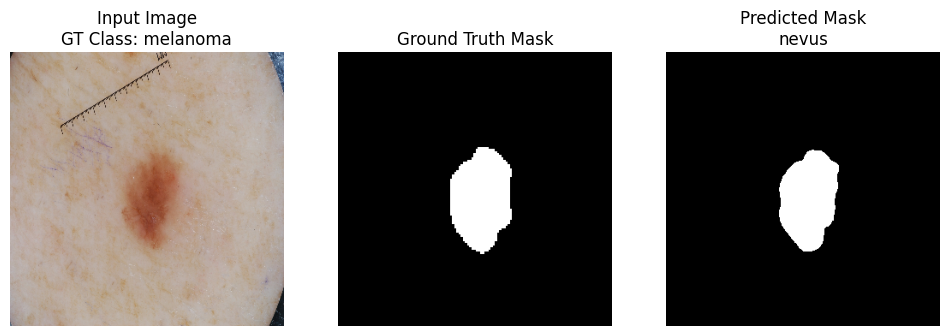

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


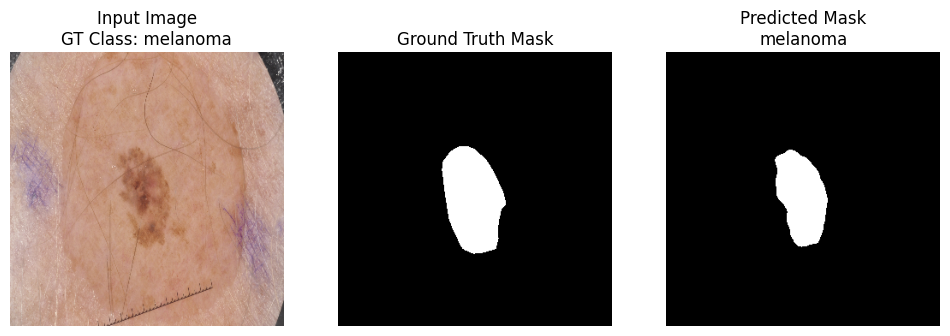

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


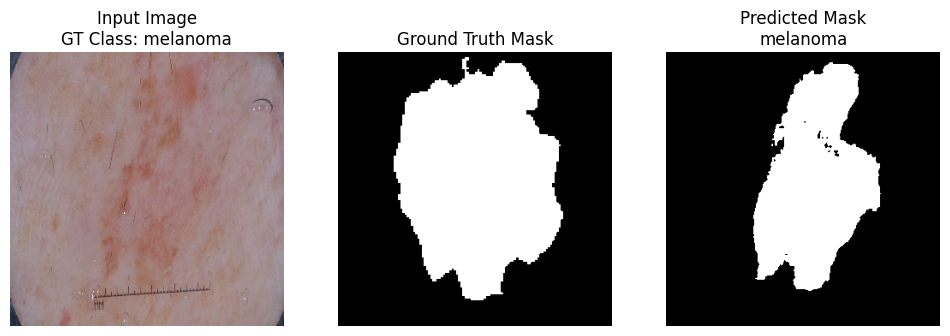

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


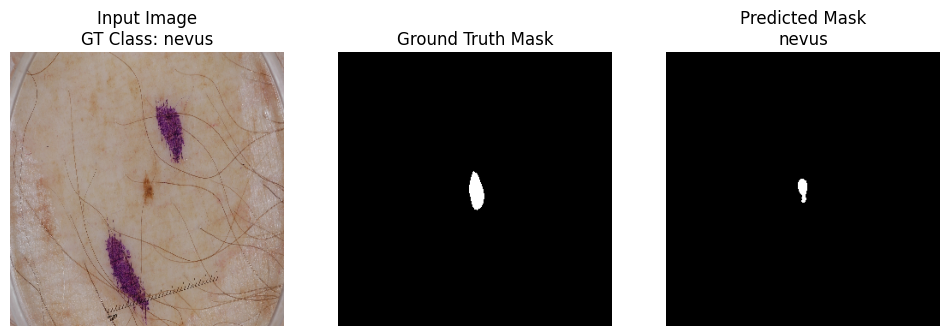

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


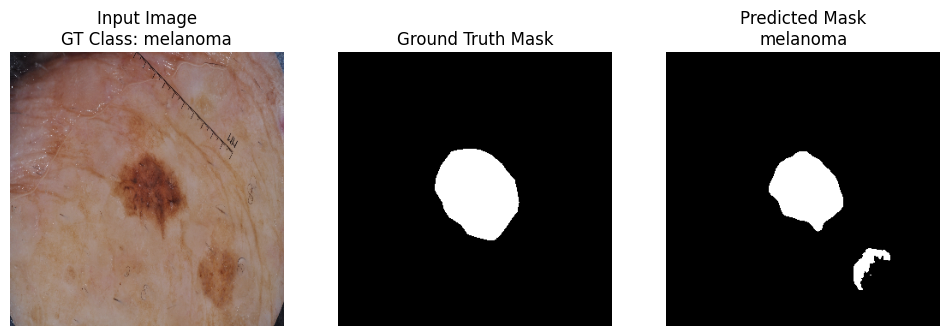

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


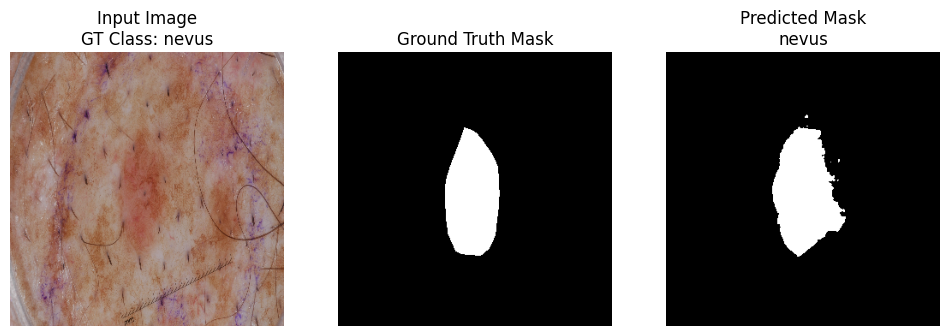

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


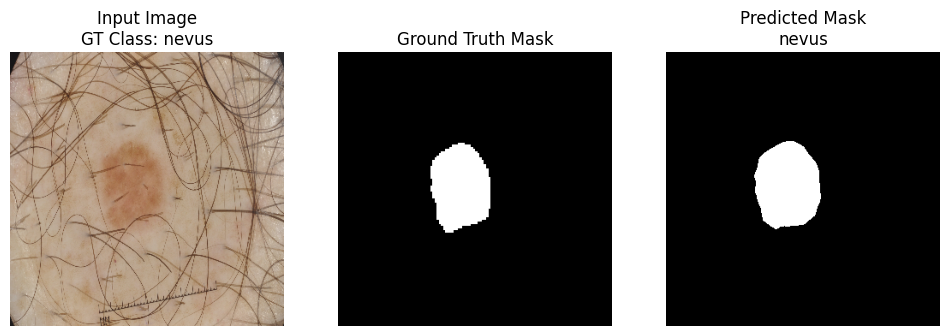

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


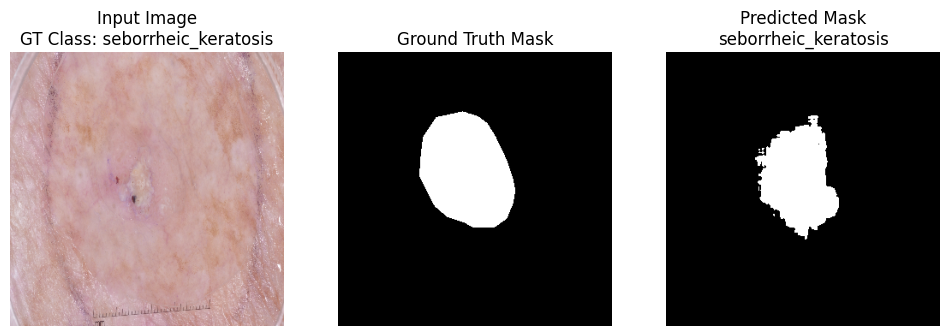

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


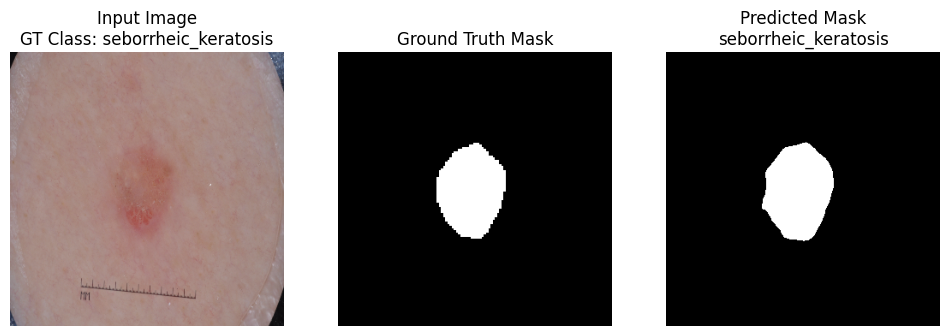

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


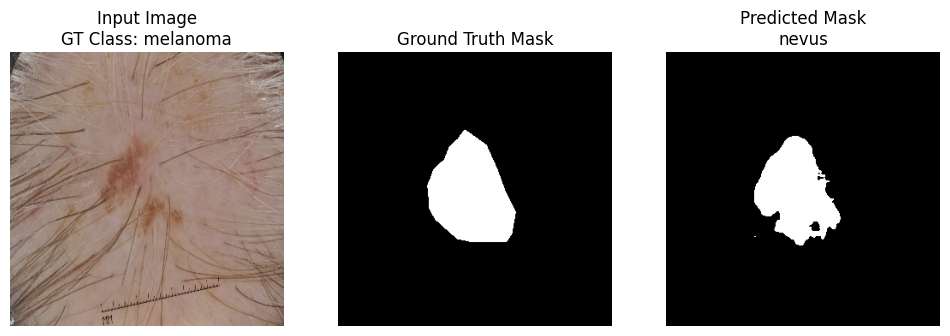

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


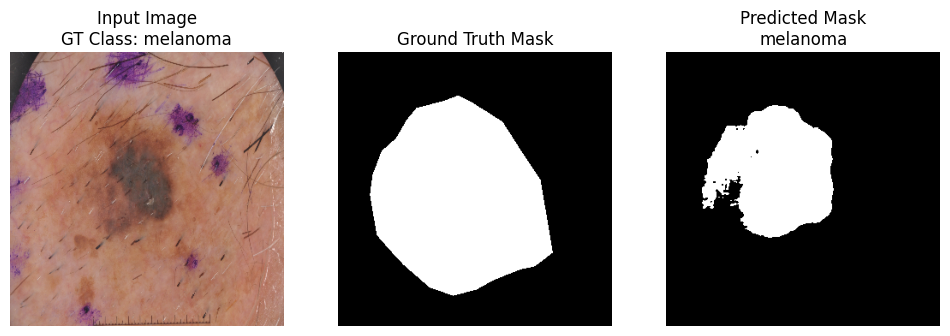

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


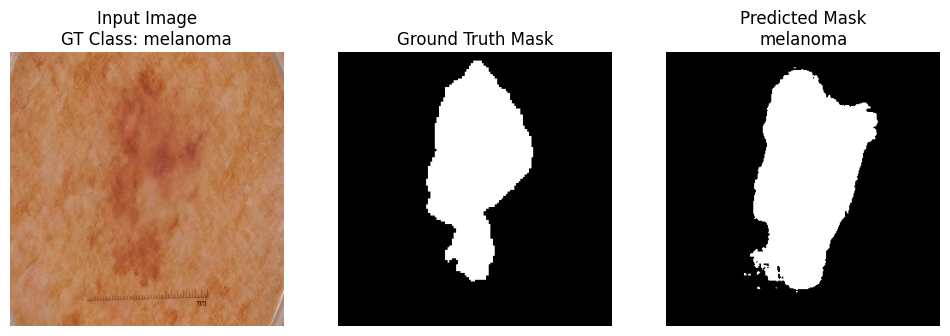

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


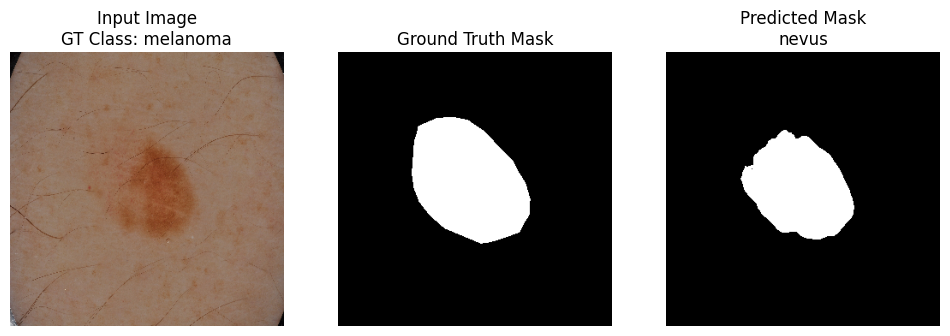

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


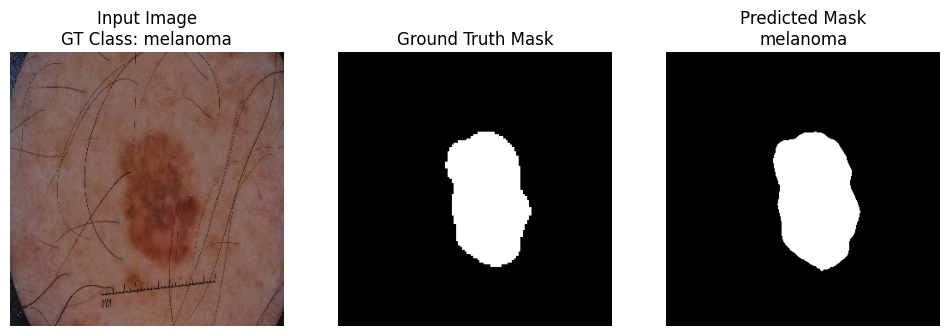

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


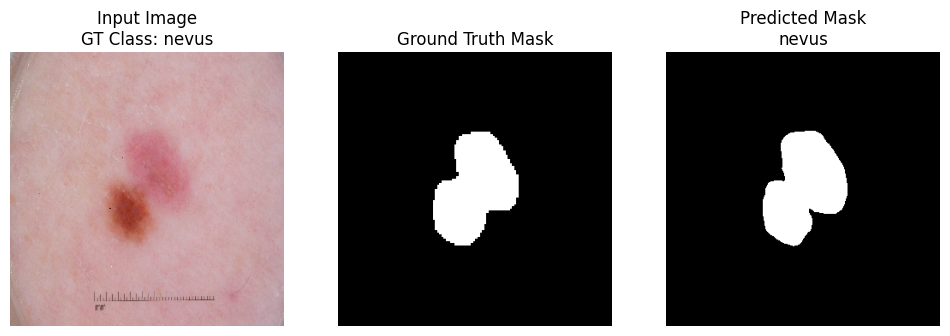

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


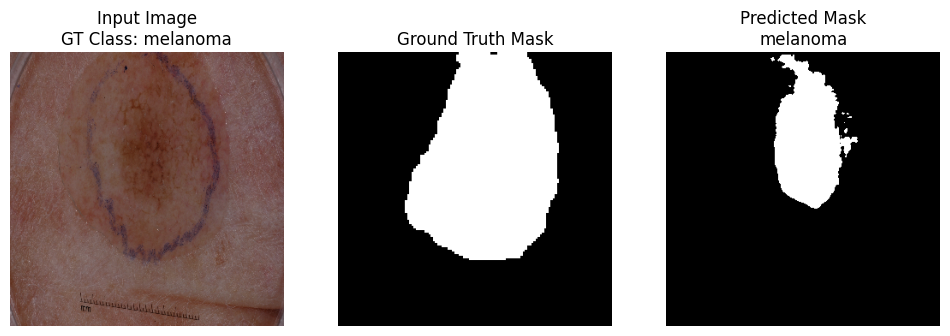

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


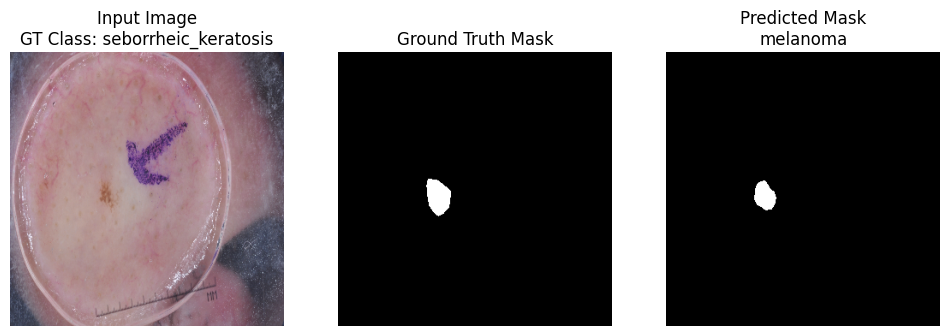

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


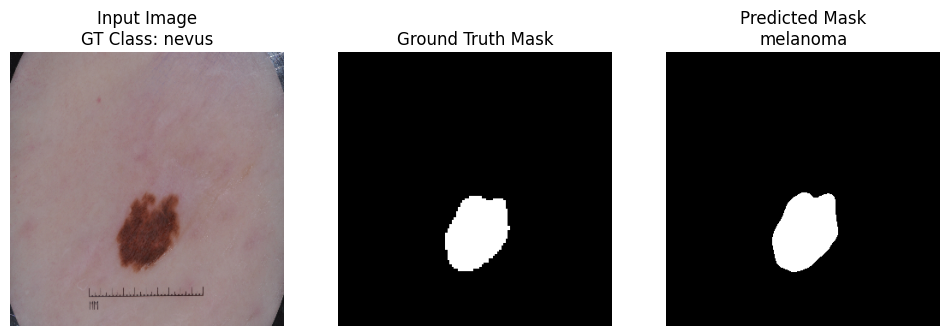

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


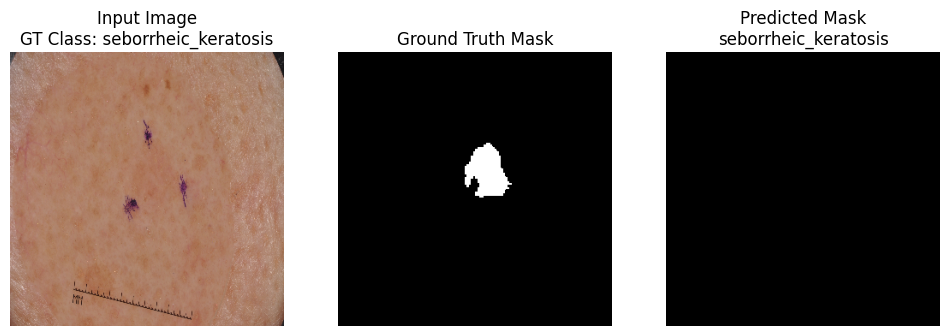

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


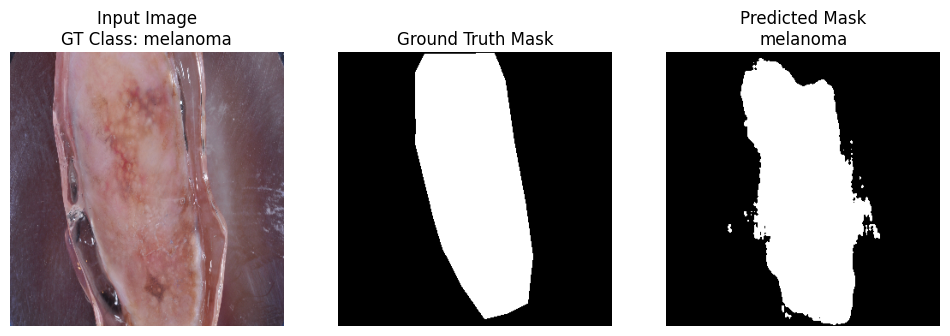

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


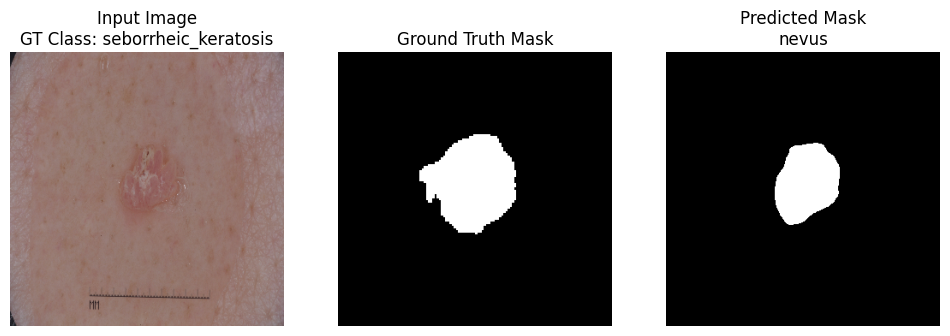

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


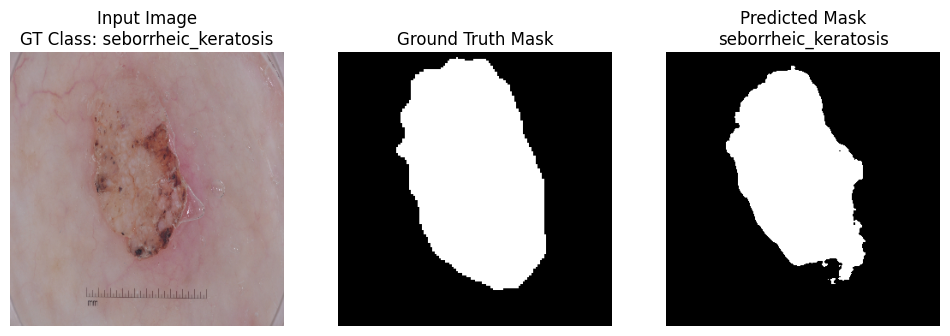

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


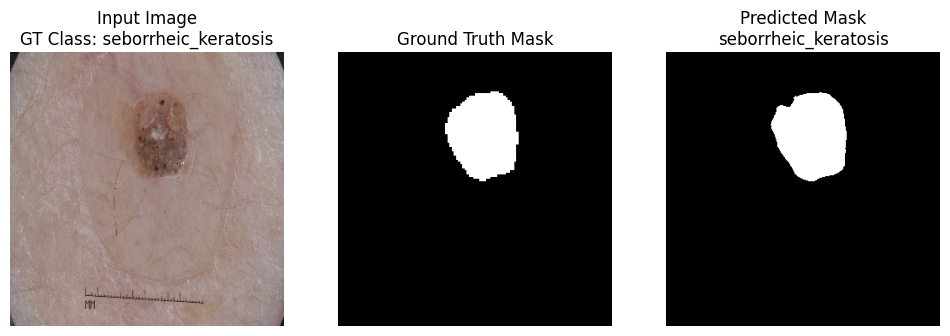

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


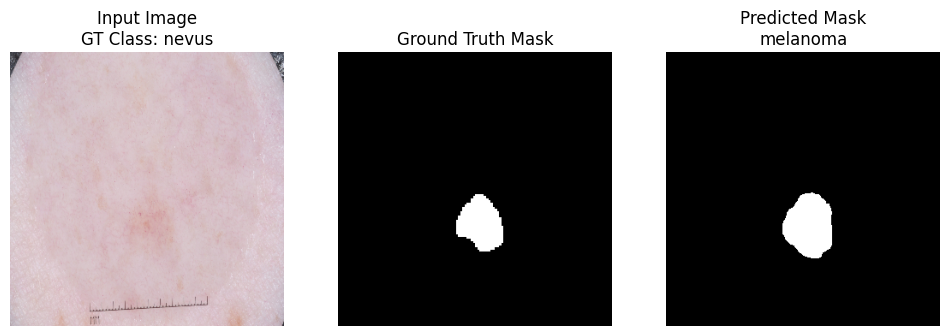

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


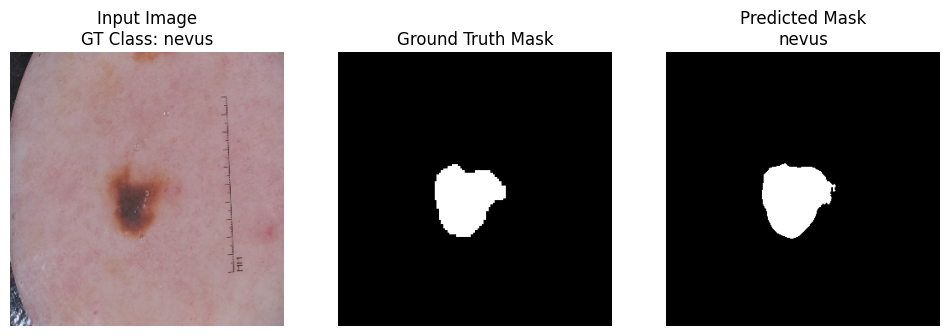

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


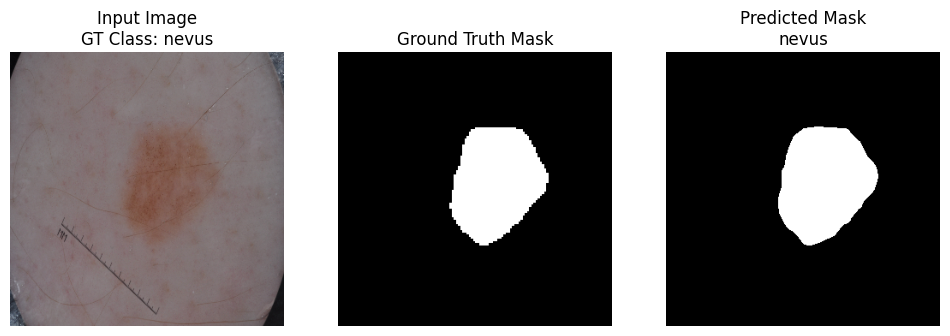

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


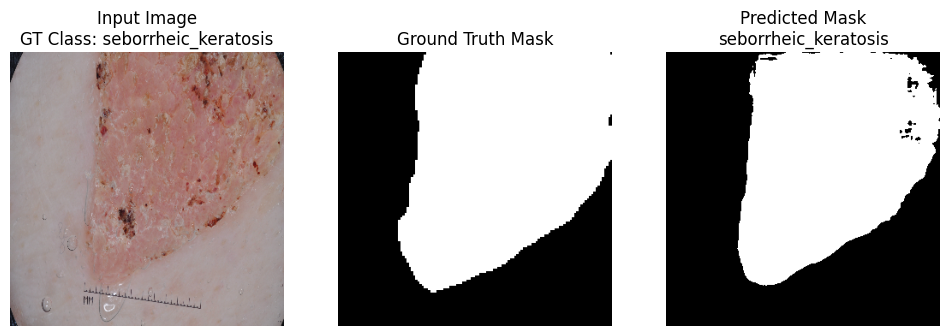

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


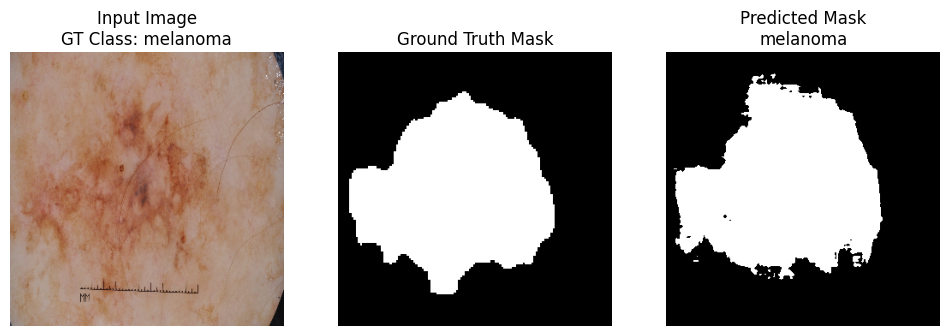

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


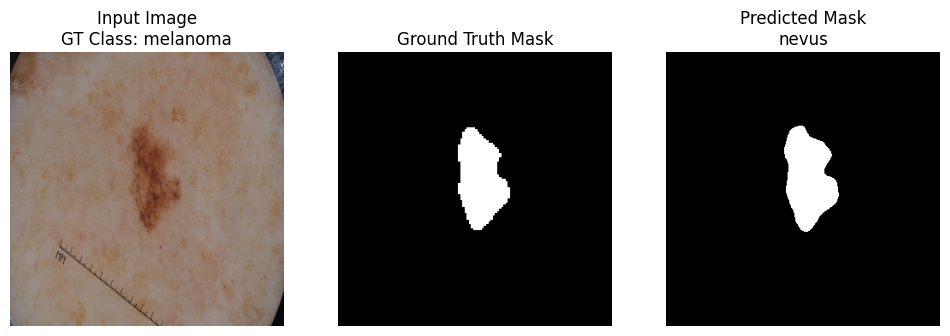

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


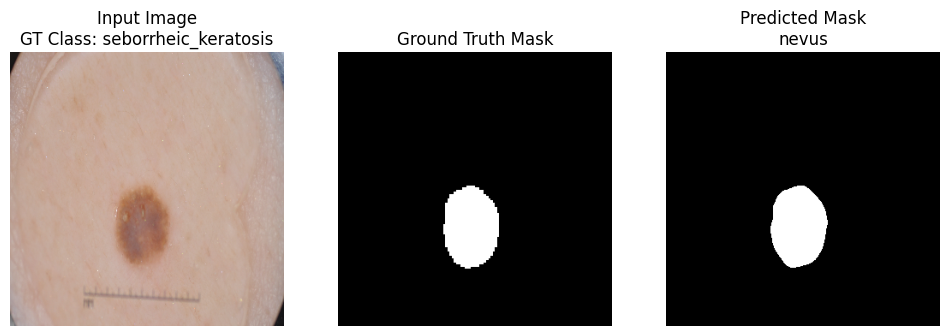

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


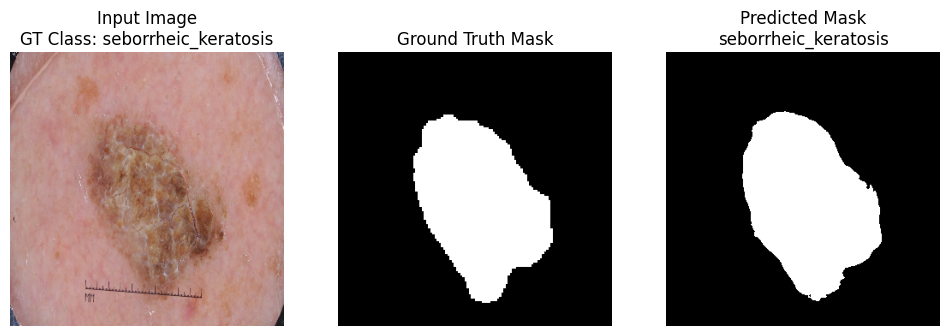

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


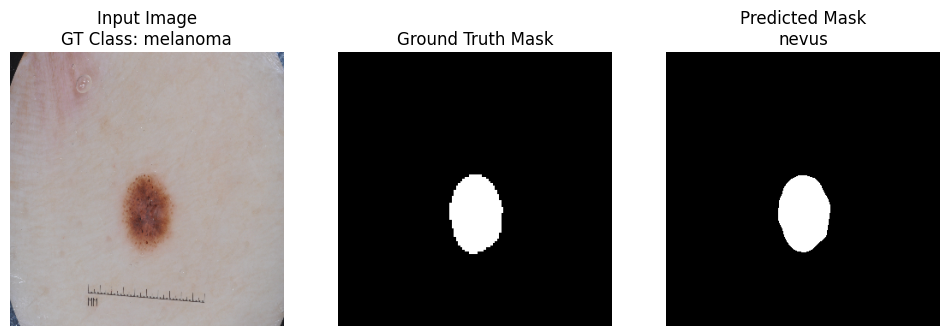

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


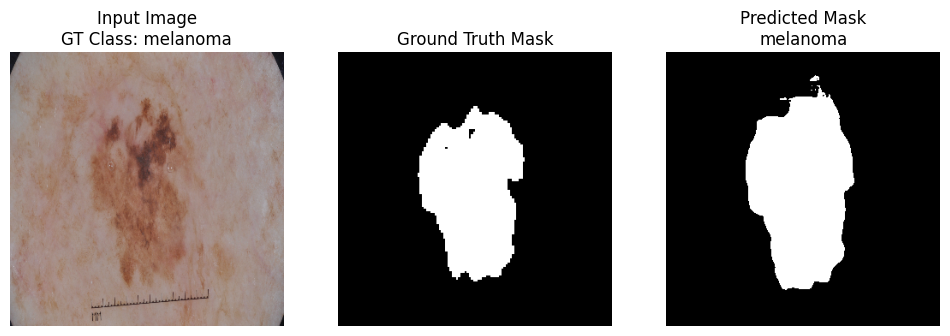

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


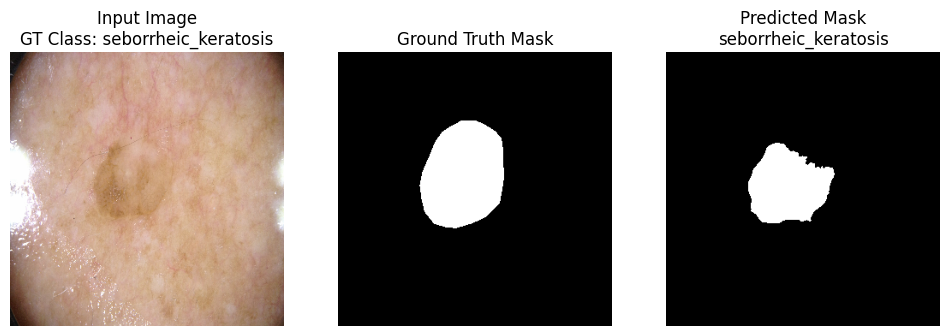

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


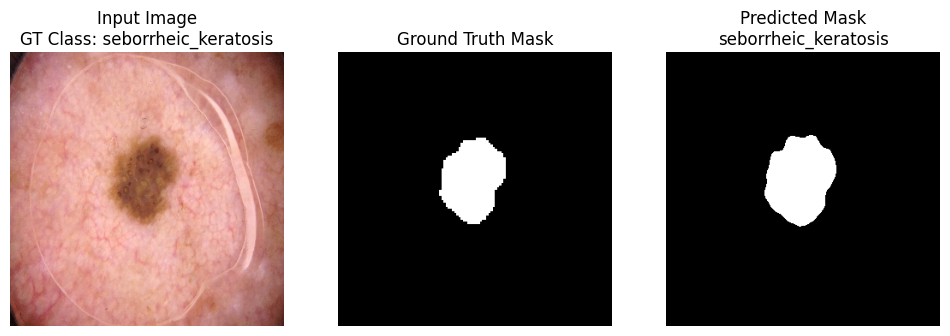

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


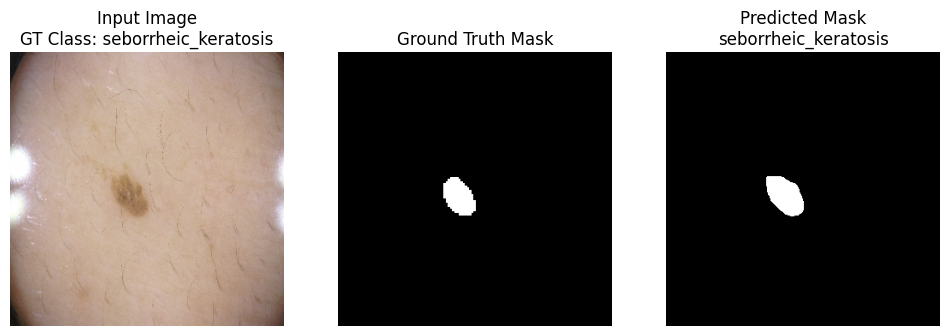

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


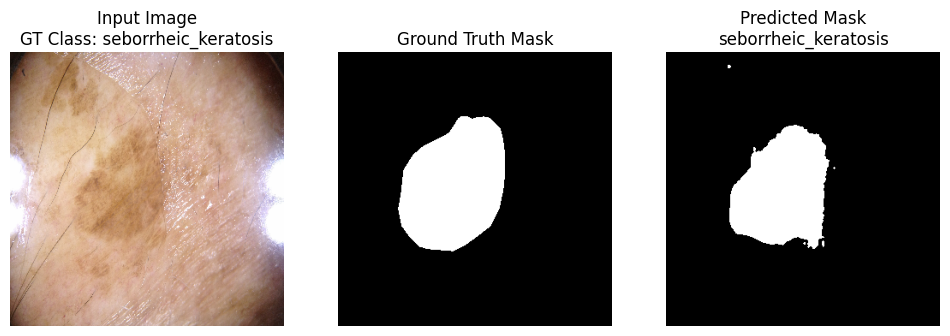

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


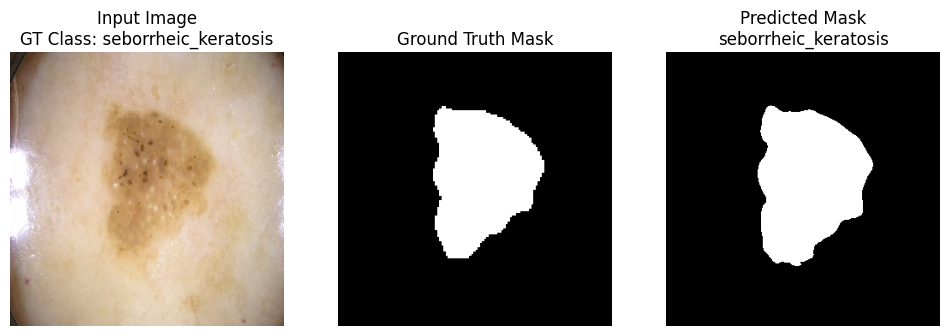

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


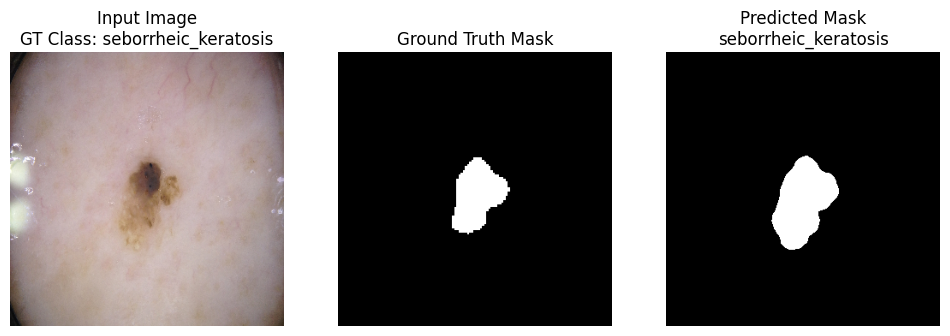

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


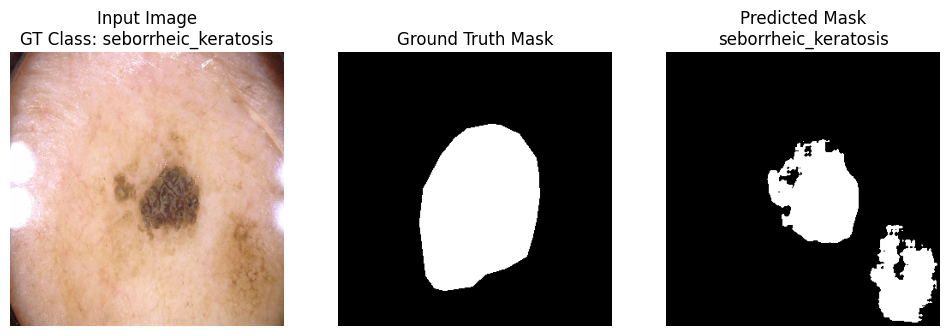

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


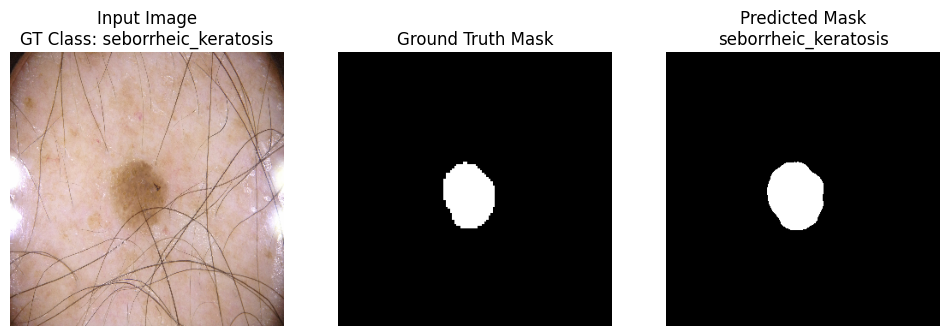

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


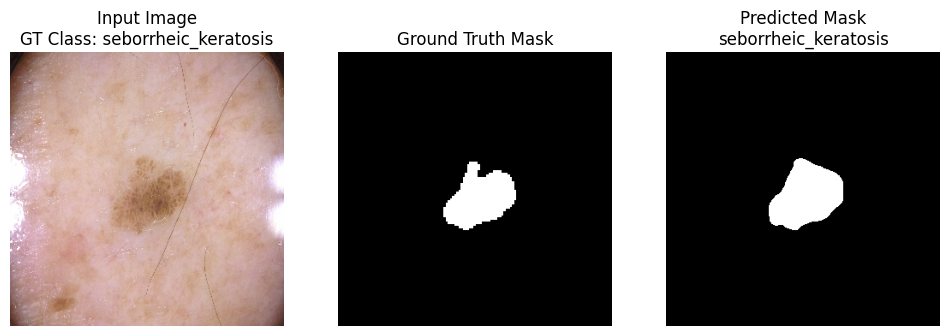

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


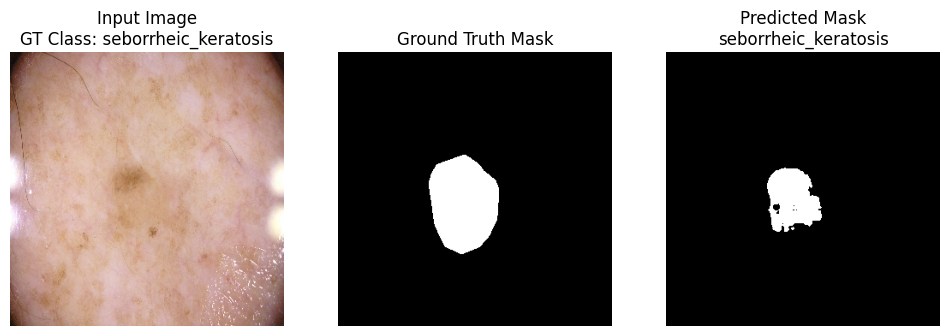

Feature,Predicted,GT
pigment_network,0 ✗,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


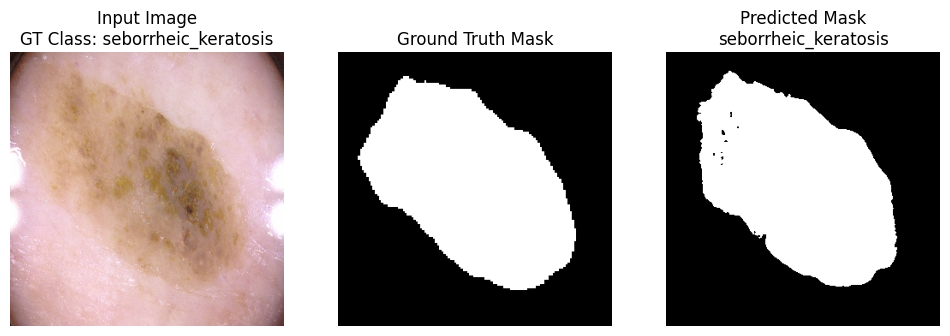

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


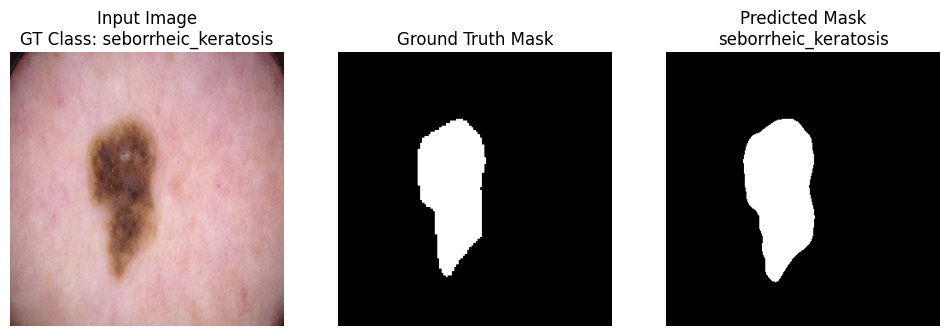

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


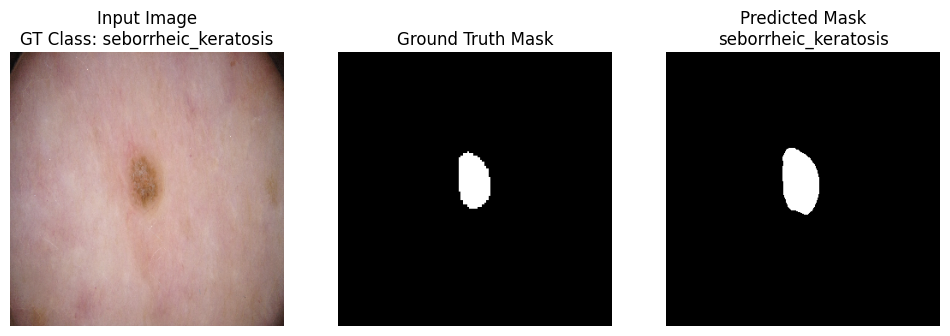

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


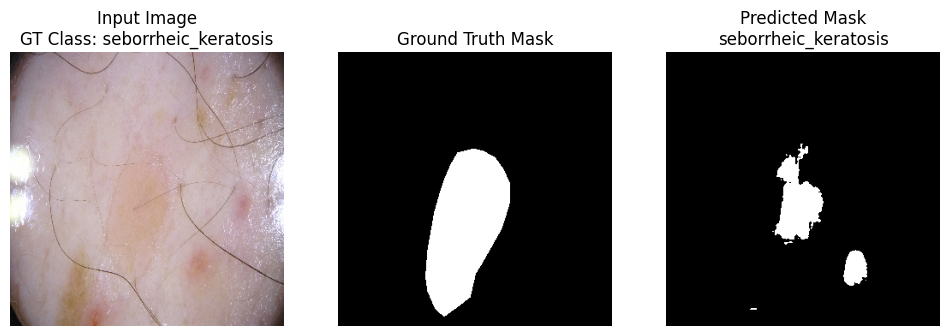

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


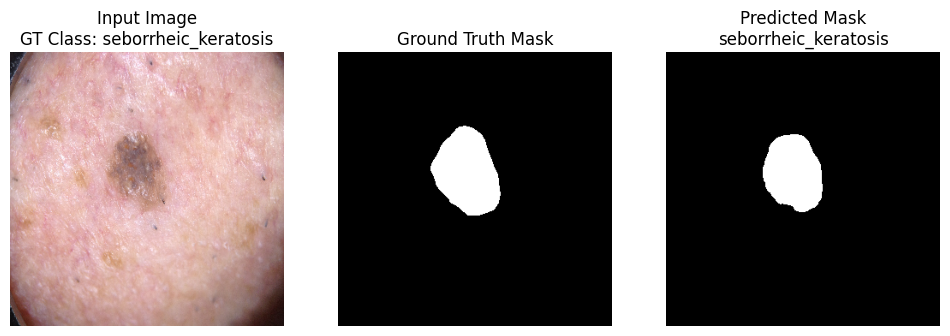

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


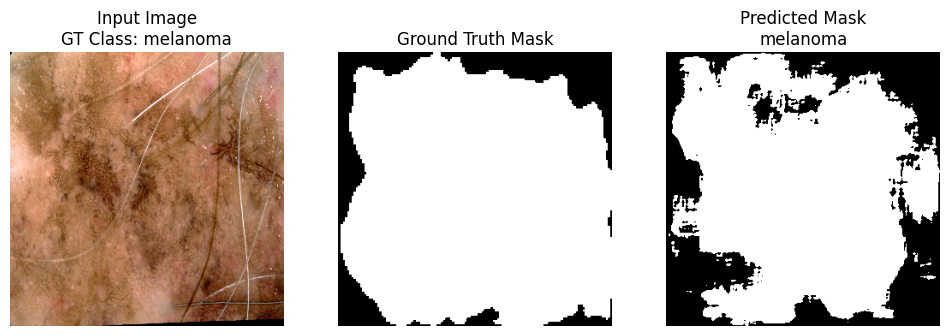

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


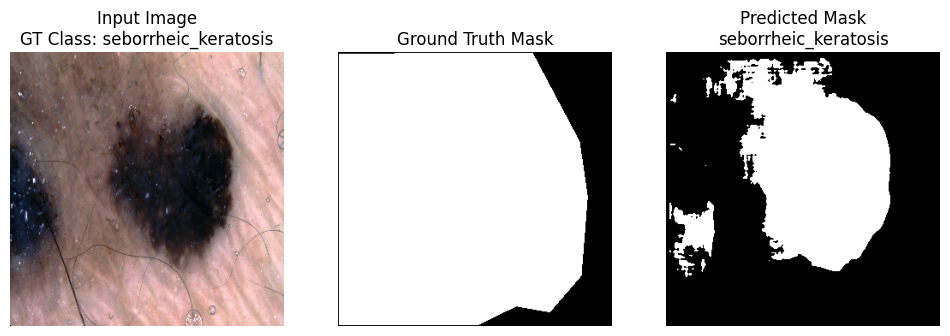

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✗,1
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


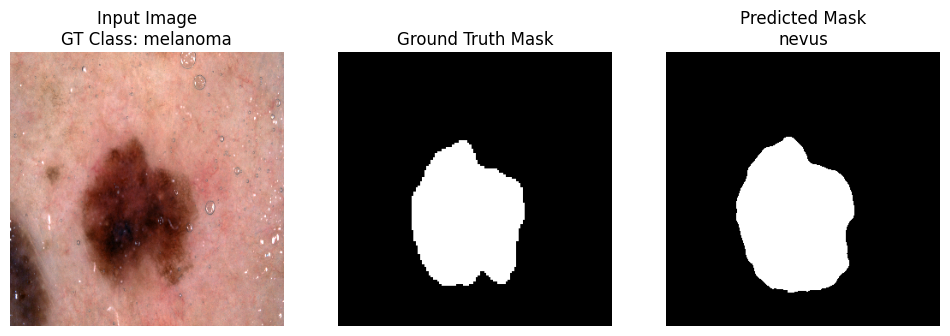

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


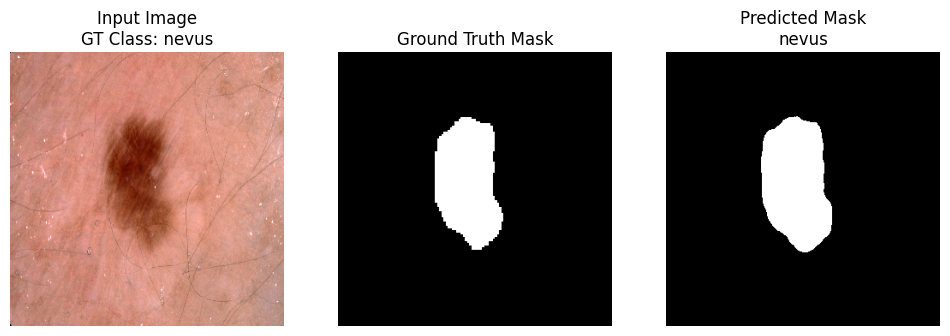

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


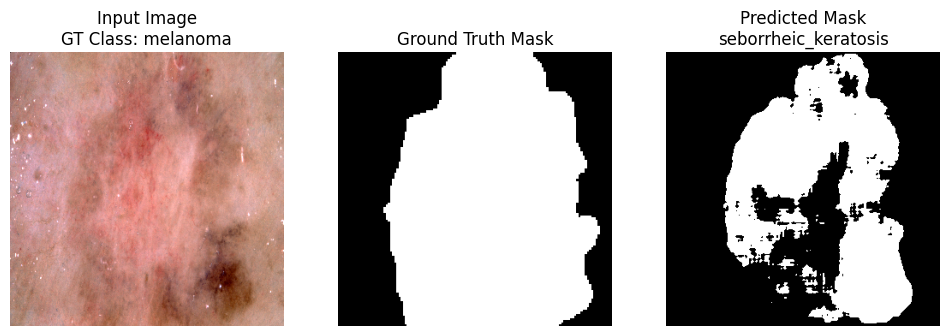

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


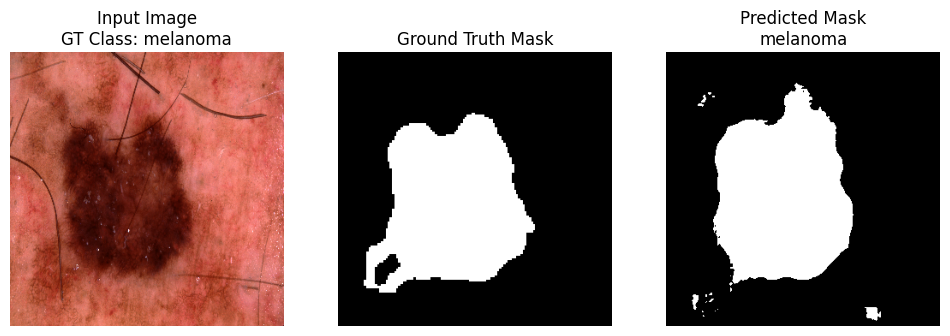

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


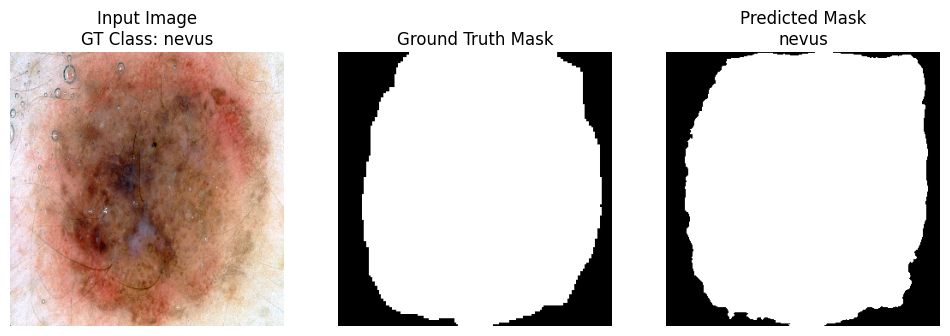

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


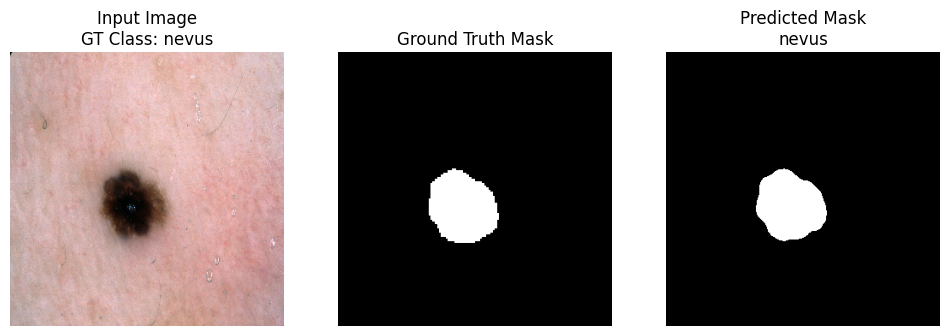

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


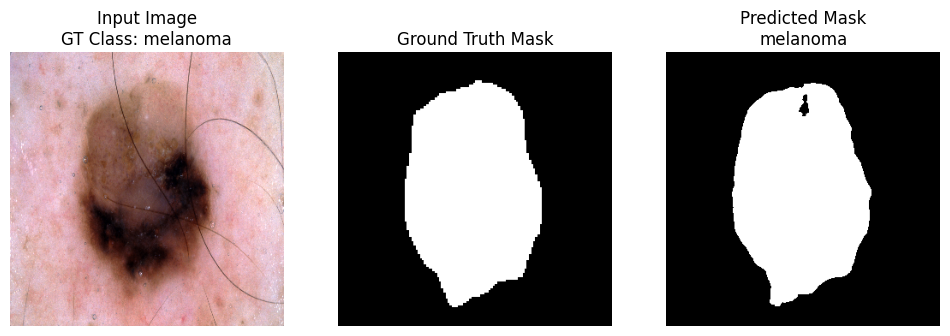

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


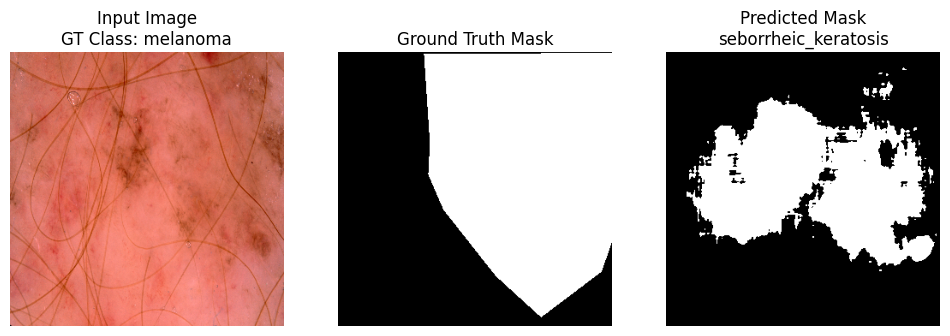

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


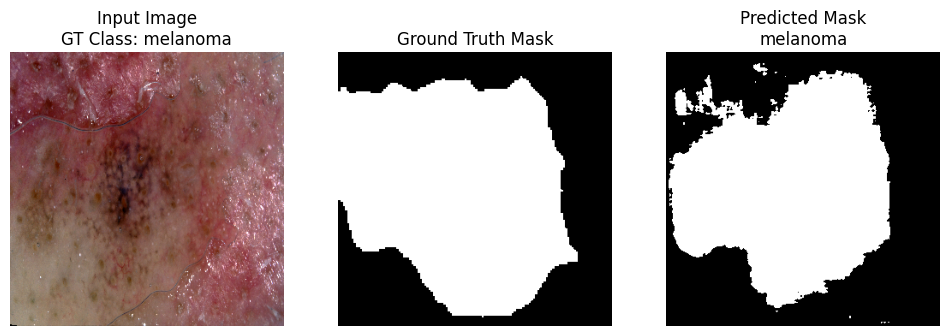

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


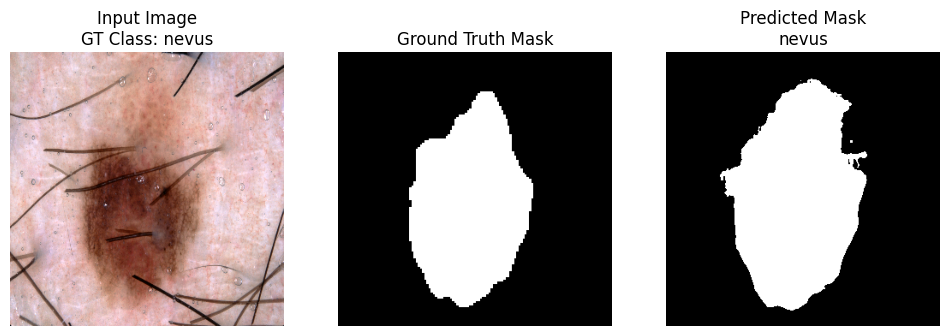

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


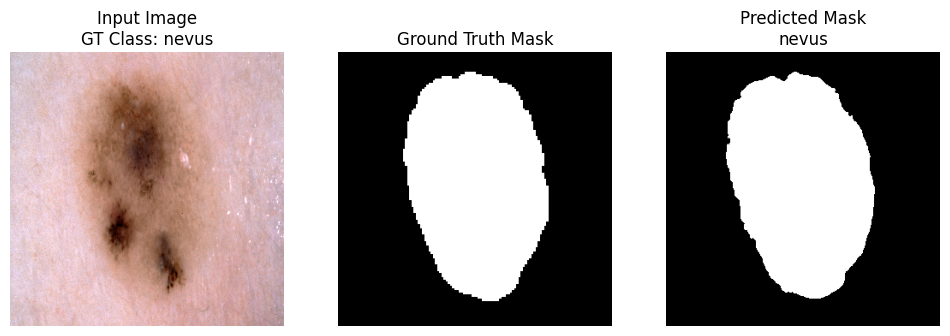

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


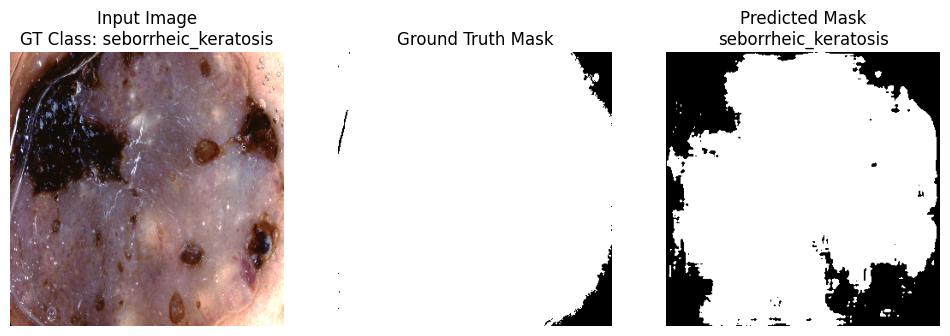

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


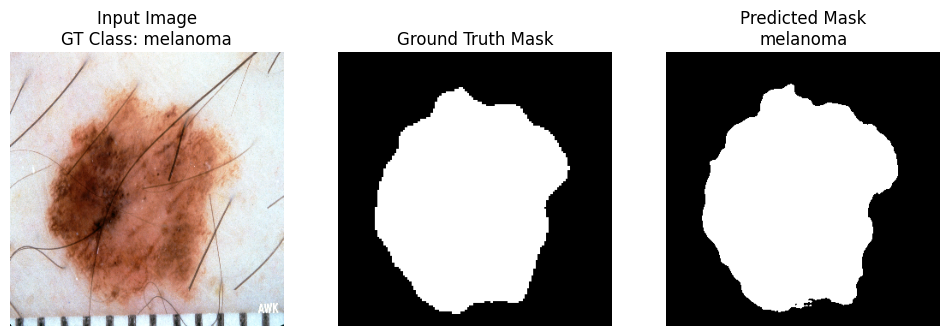

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✗,1
blotches,0 ✓,0
rosettes,0 ✓,0


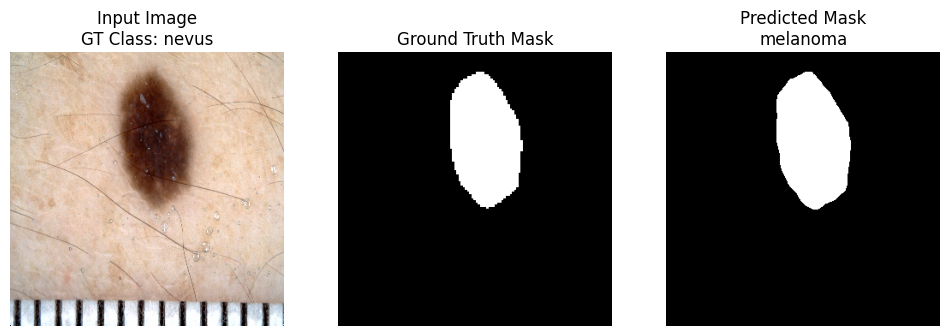

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


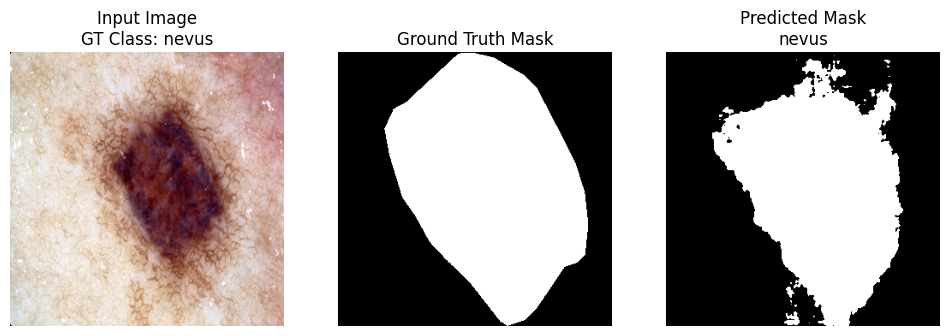

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


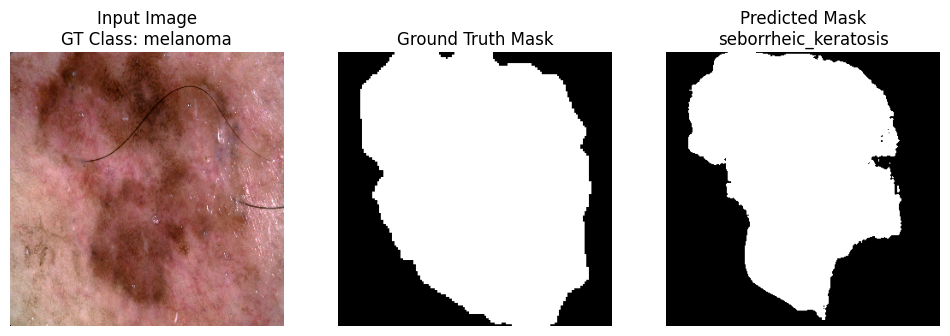

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


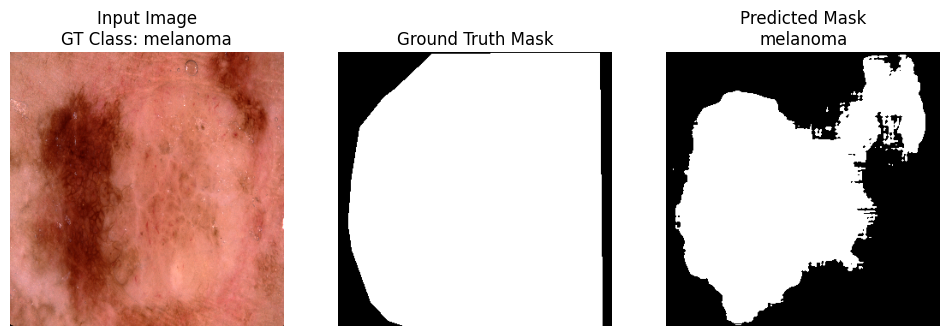

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✗,1
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


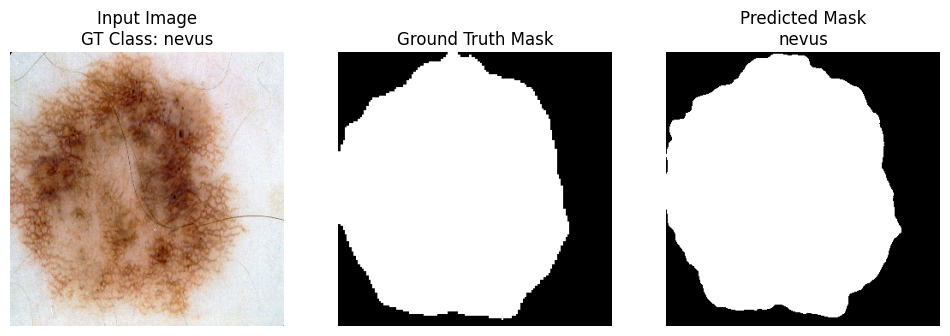

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


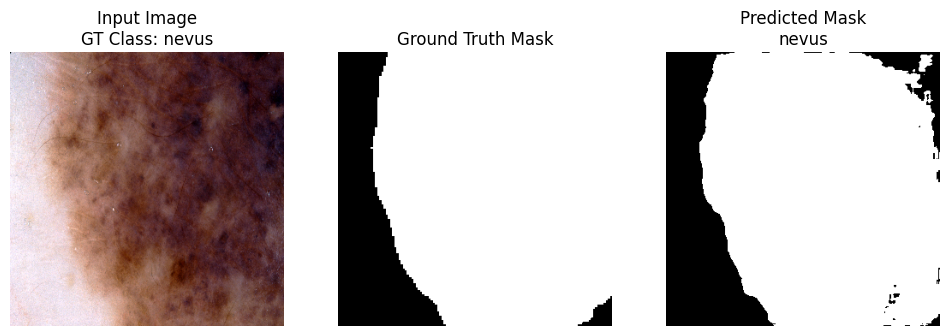

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


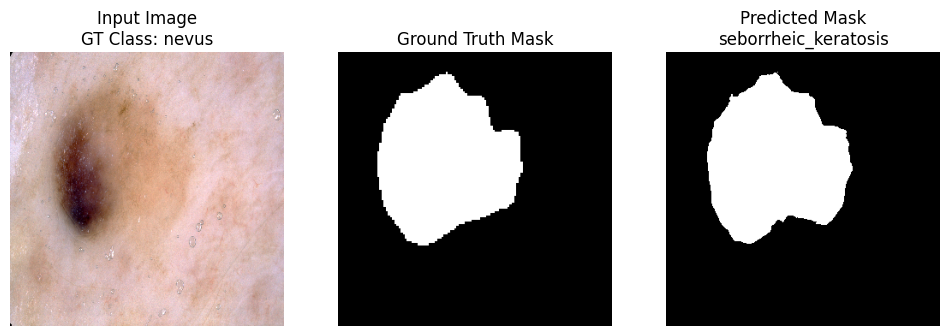

Feature,Predicted,GT
pigment_network,1 ✓,1
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


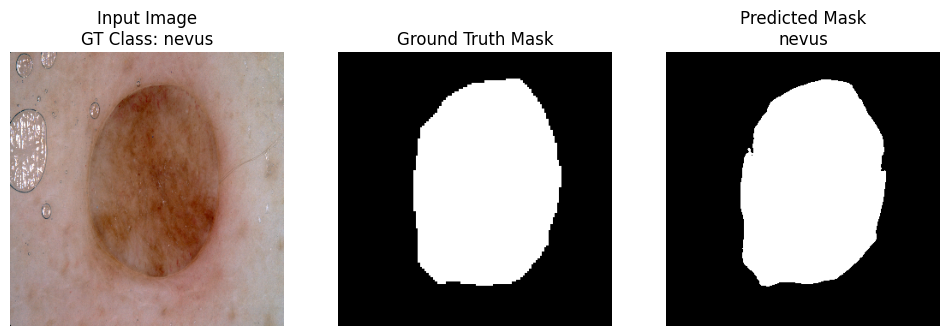

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✓,1
blotches,0 ✓,0
rosettes,0 ✓,0


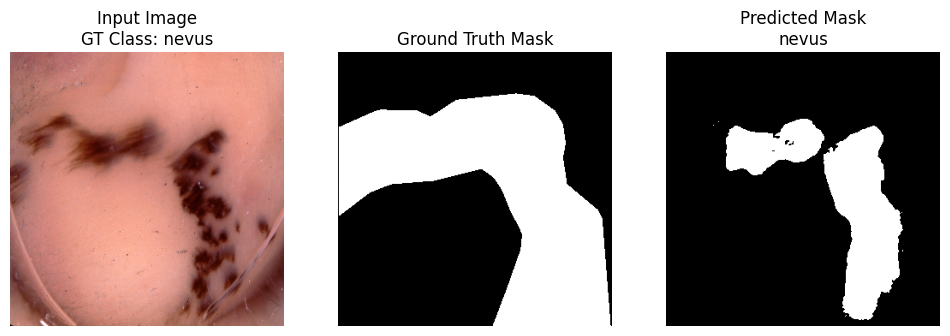

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


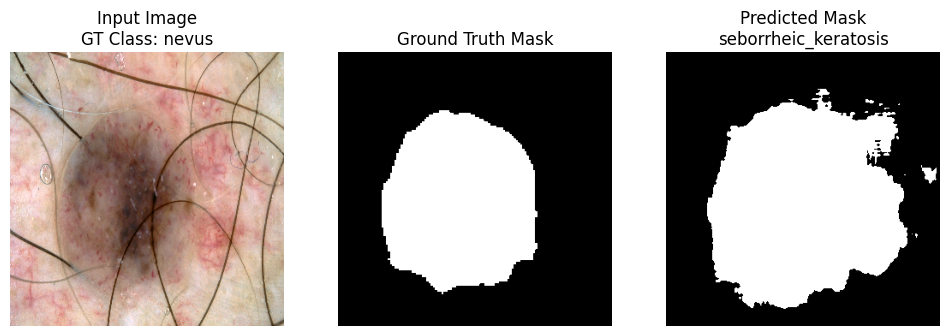

Feature,Predicted,GT
pigment_network,0 ✓,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,1 ✗,0
blotches,0 ✓,0
rosettes,0 ✓,0


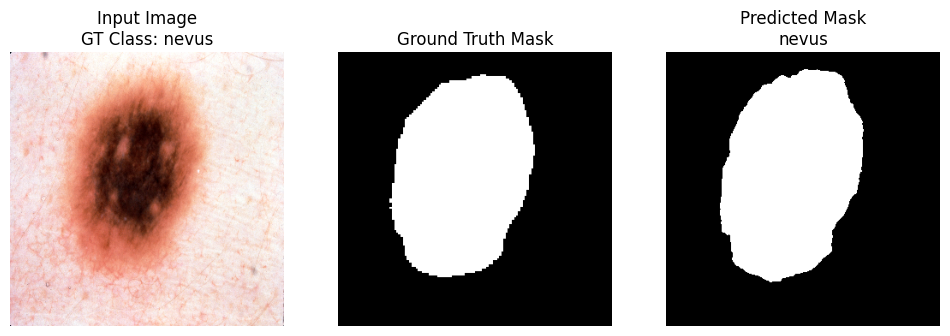

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


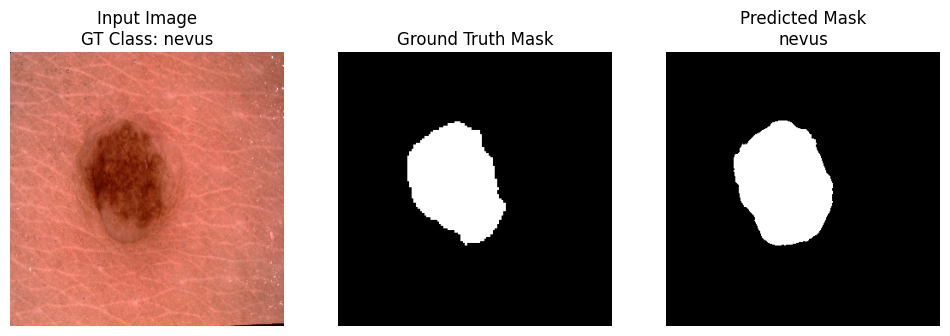

Feature,Predicted,GT
pigment_network,1 ✗,0
streaks,0 ✓,0
negative_network,0 ✓,0
globules,0 ✓,0
milia_like_cyst,0 ✓,0
blotches,0 ✓,0
rosettes,0 ✓,0


In [26]:
# Cell 14 — Visualization of sample predictions (HTML-colored version for notebooks)
from IPython.display import display, HTML

correct_preds = 0
wrong_preds = 0

def color_text(text, color):
    """Return colored HTML text (works in Jupyter/Kaggle notebooks)."""
    return f"<span style='color:{color}; font-weight:bold'>{text}</span>"

def show_sample(idx):
    global correct_preds, wrong_preds
    model.eval()
    if idx < 0 or idx >= len(val_dataset):
        display(HTML(f"<b style='color:red'>Index {idx} out of range (len={len(val_dataset)})</b>"))
        return

    image, mask, cls, feat = val_dataset[idx]
    with torch.no_grad():
        img_t = image.unsqueeze(0).to(device)
        seg_logits, class_logits, feat_logits = model(img_t)

        seg_pred = (torch.sigmoid(seg_logits) > 0.5).squeeze().cpu().numpy()
        cls_pred_idx = torch.softmax(class_logits, dim=1).argmax(dim=1).item()
        cls_pred_name = CLASS_ORDER[cls_pred_idx]
        feat_pred_probs = torch.sigmoid(feat_logits).squeeze().cpu().numpy()
        feat_pred_bin = (feat_pred_probs > 0.5).astype(int)

    # Denormalize image
    img_np = image.permute(1,2,0).cpu().numpy()
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    img_np = np.clip(img_np * std + mean, 0, 1)

    mask_np = mask.squeeze().cpu().numpy()
    cls_true_name = CLASS_ORDER[int(cls.item())]

    # --- Classification correctness ---
    is_correct = (cls_pred_name == cls_true_name)
    if is_correct:
        correct_preds += 1
        result_html = color_text(f"✔ Correct Prediction: {cls_pred_name}", "green")
    else:
        wrong_preds += 1
        result_html = color_text(f"✘ Wrong Prediction: {cls_pred_name} (GT: {cls_true_name})", "red")

    # --- Visualization ---
    plt.figure(figsize=(12,5))
    plt.subplot(1,3,1); plt.imshow(img_np); plt.title(f"Input Image\nGT Class: {cls_true_name}"); plt.axis('off')
    plt.subplot(1,3,2); plt.imshow(mask_np, cmap='gray'); plt.title("Ground Truth Mask"); plt.axis('off')
    plt.subplot(1,3,3); plt.imshow(seg_pred, cmap='gray'); plt.title(f"Predicted Mask\n{cls_pred_name}"); plt.axis('off')
    plt.show()

    # --- Feature comparison ---
    gt_feat_numpy = feat.numpy().astype(int)
    correct_feature_count = 0
    feat_rows = []

    for i, fname in enumerate(FEATURE_NAMES):
        pred_val = feat_pred_bin[i]
        gt_val = gt_feat_numpy[i]
        if pred_val == gt_val:
            feat_rows.append(f"<tr><td>{fname}</td><td style='color:green'>{pred_val} ✓</td><td>{gt_val}</td></tr>")
            correct_feature_count += 1
        else:
            feat_rows.append(f"<tr><td>{fname}</td><td style='color:red'>{pred_val} ✗</td><td style='color:red'>{gt_val}</td></tr>")

    total_feats = len(FEATURE_NAMES)
    feat_acc = 100 * correct_feature_count / total_feats

    # --- Build HTML output ---
    html = f"""
    <div style='font-family:monospace; margin-top:10px'>
        {result_html}<br>
        <span style='color:blue'>Feature Prediction Accuracy: {feat_acc:.1f}% ({correct_feature_count}/{total_feats})</span><br><br>
        <table border='1' cellpadding='4' style='border-collapse:collapse;'>
            <tr><th>Feature</th><th>Predicted</th><th>GT</th></tr>
            {''.join(feat_rows)}
        </table>
    </div>
    """
    display(HTML(html))
    display(HTML("<hr style='border:1px solid #999;margin:10px 0;'>"))

# Show samples
for i in range(1, 200):
    show_sample(i)

# --- Final summary ---
total = correct_preds + wrong_preds
overall_html = f"""
<div style='font-family:monospace; margin-top:20px'>
<h3 style='color:blue'>Overall Prediction Summary</h3>
<p><span style='color:green'>Correct Class Predictions:</span> {correct_preds}</p>
<p><span style='color:red'>Wrong Class Predictions:</span> {wrong_preds}</p>
<p><span style='color:brown'>Accuracy:</span> {100 * correct_preds / total:.2f}% ({correct_preds}/{total})</p>
</div>
"""
display(HTML(overall_html))


In [27]:
# Cell 15 — Save final model and artifacts (safe)
final_path = "/kaggle/working/multitask_model.pth"
torch.save({
    'model_state': model.state_dict(),
    'class_counts_train': class_counts_train,
    'feature_names': FEATURE_NAMES,
    'class_order': CLASS_ORDER,
    'history': history,
    'test_report_dict': test_class_report_dict
}, final_path)
print("Saved final model and history to:", final_path)


Saved final model and history to: /kaggle/working/multitask_model.pth


In [28]:
import os
import zipfile
from tqdm.notebook import tqdm
from IPython.display import FileLink

src_dir = "/kaggle/working"
zip_path = "/kaggle/working/results.zip"

# Collect all files recursively
file_list = []
for root, _, files in os.walk(src_dir):
    for f in files:
        full_path = os.path.join(root, f)
        # Skip the zip itself if it exists
        if full_path != zip_path:
            file_list.append(full_path)

# Create ZIP with progress bar
print(f"Zipping {len(file_list)} files into {zip_path} ...")
with zipfile.ZipFile(zip_path, "w", compression=zipfile.ZIP_DEFLATED) as zipf:
    for file in tqdm(file_list, desc="Compressing", unit="file"):
        arcname = os.path.relpath(file, src_dir)
        zipf.write(file, arcname)

print("\nAll files in /kaggle/working have been zipped successfully!")
!ls -lh /kaggle/working | grep .zip
print("Download 'results.zip' from the right sidebar.")


Zipping 13 files into /kaggle/working/results.zip ...


Compressing:   0%|          | 0/13 [00:00<?, ?file/s]


All files in /kaggle/working have been zipped successfully!
-rw-r--r-- 1 root root 179M Nov  6 18:18 results.zip
Download 'results.zip' from the right sidebar.


In [ ]:
"""
# Cell 12 — Final Test Evaluation (fixed checkpoint load & autocast)
print("--- Starting Final Evaluation on Test Set ---")

output_dir = "/kaggle/working/output_images"
os.makedirs(output_dir, exist_ok=True)

load_path = "./checkpoints/best_model.pth"
try:
    checkpoint = torch.load(load_path, map_location=device)
    model.load_state_dict(checkpoint['model_state'])
    print(f"Loaded best model from epoch {checkpoint.get('epoch', 'N/A')} with ValLoss {checkpoint.get('val_loss', 'N/A')}")
except Exception as e:
    print(f"Could not load checkpoint: {e}. Evaluating with current model in memory.")

model.eval()
all_class_trues = []
all_class_preds_proba = []
all_feat_trues = []
all_feat_preds = []
seg_trues = []
seg_preds = []

from torch.cuda.amp import autocast

with torch.no_grad():
    for images, masks, classes, feats in tqdm(test_loader, desc="Testing"):
        images = images.to(device)
        masks = masks.to(device)
        classes = classes.to(device)
        feats = feats.to(device)

        with autocast():
            seg_logits, class_logits, feat_logits = model(images)

        all_class_preds_proba.extend(torch.softmax(class_logits, dim=1).cpu().numpy().tolist())
        all_class_trues.extend(classes.cpu().numpy().tolist())

        all_feat_preds.extend(torch.sigmoid(feat_logits).cpu().numpy().tolist())
        all_feat_trues.extend(feats.cpu().numpy().tolist())

        seg_preds.extend((torch.sigmoid(seg_logits) > 0.5).long().cpu().numpy().reshape(-1).tolist())
        seg_trues.extend((masks > 0.5).long().cpu().numpy().reshape(-1).tolist())

# Metrics
test_class_preds_labels = np.argmax(np.array(all_class_preds_proba), axis=1)
test_class_report_str = classification_report(all_class_trues, test_class_preds_labels, target_names=CLASS_ORDER, zero_division=0)
test_class_report_dict = classification_report(all_class_trues, test_class_preds_labels, target_names=CLASS_ORDER, zero_division=0, output_dict=True)
print(test_class_report_str)
# Save classification report to CSV
test_class_report_dict = classification_report(all_class_trues, test_class_preds_labels,
                                               target_names=CLASS_ORDER, zero_division=0, output_dict=True)
pd.DataFrame(test_class_report_dict).transpose().to_csv(f"{output_dir}/classification_report.csv", index=True)

# Overall Test Accuracy
test_accuracy = test_class_report_dict.get("accuracy", None)
if test_accuracy is not None:
    print(f"Test Accuracy: {test_accuracy * 100:.2f}%")
else:
    # fallback if key missing
    test_accuracy = (test_class_preds_labels == np.array(all_class_trues)).mean()
    print(f"Test Accuracy (computed manually): {test_accuracy * 100:.2f}%")


try:
    test_aucs = roc_auc_score(np.array(all_class_trues), np.array(all_class_preds_proba), multi_class='ovr', average='macro')
    print(f"Test Multi-class AUC (ovr, macro): {test_aucs:.4f}")
except Exception as e:
    print(f"Could not calculate Test AUC: {e}")

try:
    test_seg_dice = f1_score(seg_trues, seg_preds, average='binary', zero_division=0)
    test_seg_iou  = jaccard_score(seg_trues, seg_preds, average='binary', zero_division=0)
    print(f"Test Segmentation Dice (F1): {test_seg_dice:.4f}")
    print(f"Test Segmentation IoU (Jaccard): {test_seg_iou:.4f}")
except Exception as e:
    print(f"Could not calculate Test Segmentation metrics: {e}")

try:
    test_feat_preds_bin = (np.array(all_feat_preds) > 0.5).astype(int)
    test_feat_trues_arr = np.array(all_feat_trues).astype(int)
    test_feat_f1 = f1_score(test_feat_trues_arr, test_feat_preds_bin, average='macro', zero_division=0)
    print(f"Test Feature macro-F1: {test_feat_f1:.4f}")
except Exception as e:
    print(f"Could not calculate Test Feature metrics: {e}")

cm = confusion_matrix(all_class_trues, test_class_preds_labels)

# --- Additional Analysis: Per-Class AUC and Confusion Matrix Visualization ---

# Convert lists to arrays
y_true = np.array(all_class_trues)
y_proba = np.array(all_class_preds_proba)
y_pred = np.argmax(y_proba, axis=1)

# ✅ Per-Class AUC
try:
    from sklearn.metrics import roc_auc_score, roc_curve
    n_classes = y_proba.shape[1]
    aucs = []
    for i in range(n_classes):
        true_bin = (y_true == i).astype(int)
        auc_i = roc_auc_score(true_bin, y_proba[:, i])
        aucs.append(auc_i)
        print(f"AUC for class '{CLASS_ORDER[i]}': {auc_i:.4f}")
    print(f"\nMean One-vs-Rest AUC: {np.mean(aucs):.4f}")
except Exception as e:
    print(f"Could not compute per-class AUC: {e}")

# --- Confusion Matrix Visualization ---
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=CLASS_ORDER, yticklabels=CLASS_ORDER)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix — Test Set")
plt.tight_layout()
plt.savefig(f"{output_dir}/confusion_matrix_raw.png")
plt.show()

# Normalized confusion matrix
cm_norm = cm.astype('float') / cm.sum(axis=1, keepdims=True)
plt.figure(figsize=(6, 5))
sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Greens',
            xticklabels=CLASS_ORDER, yticklabels=CLASS_ORDER)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Normalized Confusion Matrix — Test Set")
plt.tight_layout()
plt.savefig(f"{output_dir}/confusion_matrix_norm.png")
plt.show()

print(f"\n✅ All plots and reports saved to: {output_dir}")
"""